<a href="https://colab.research.google.com/github/mc-off/NLP/blob/main/lab1/U_gub_tvoix_konfetnix.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Задача: Классификация текста на 3 класса. признак target (0, 1, 2) его и нужно предсказать
##1) EDA - анализа данных.
	- показать разные статистики для ваших данных
	- визуализировать данные
	- очистить от мусора
	- новые фичи, которые вы придумаете
	- какие-нибудь инсайты

##2) embeddings:
	- one hot encoding
	- word2vec обученную (ссылку скину где достать обученную модель) / самим обучить
	- fasttext обученную / самим обучить
	- tf-idf
##3) ML-algorithms:
	- 2 простых алгоритма (SVM, LogReg, NaiveBayes)
	- random forest
	- decision tree
	- ансамбли мл алгоритмов (2) 
	- кросс-валидация
	- GridSearch для подбора гиперпараметров
##4) Нейронные сети:
	- Попробовать любую архитектуру из тех, что прошли на паре. (полносвязанная сетка, сверточная сетка или рекурентная)
	P.S.: Постарайтесь сделать подбор количества слоев(желательно сделать бы) и некоторых параметров(если захотите)
	
	
##Оценка: 8
Опционально:
	- Визуализация при помощи bokeh ваших эмбеддингов и попытка пояснить почему они именно такие
	- +1 алгоритм нейросетевой
Оценка: +2 балла

##Конечные результаты:
	- test.csv - требуется предсказать метки классов. 
	Файл должен состоять из двух колонок Id,Predicted
	Id - id записи
	Predicted - метка предсказанного класса
	Метки классов: 
	0, 1, 2

###P.S.: Не ленитесь пробуйте что-то интересное и новое. 
Может быть кто-то попробуем "POS-теги" или еще какие-либо интересные фишки и сможет их объяснить

In [ ]:
!pip install -qq transformers
!pip install tensorflow
!pip3 install --upgrade gensim --user

In [ ]:
#core
import pandas as pd
import numpy as np
import torch
import torch.nn as nn

#models
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, AdaBoostClassifier
from sklearn.naive_bayes import BernoulliNB
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn import svm
from sklearn.svm import SVC
import xgboost as xgb
from xgboost import XGBClassifier
import transformers
from transformers import AutoModel, BertTokenizerFast, AdamW

#model selection
from sklearn.model_selection import RepeatedStratifiedKFold, train_test_split, KFold, cross_val_score, GridSearchCV

#plots
from matplotlib import style
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm

#metrics
from sklearn import metrics
from sklearn.metrics import accuracy_score, classification_report

#preprocessing
import re
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.feature_extraction import DictVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from numpy import argmax

#nltk
import nltk
from nltk.probability import FreqDist
from nltk.stem import WordNetLemmatizer
from multiprocessing import Process
from nltk.corpus import stopwords, wordnet
from nltk.tokenize import word_tokenize
from nltk import sent_tokenize, pos_tag

nltk.download('punkt')
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
nltk.download('averaged_perceptron_tagger')

#embeddings
import gensim
from gensim.models.wrappers import FastText
from gensim.models.fasttext import FastText as FT_trainable
from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import bokeh.plotting as bp
from bokeh.models import HoverTool, BoxSelectTool
from bokeh.plotting import figure, show, output_notebook
from sklearn.manifold import TSNE
from wordcloud import WordCloud

#utils
import logging
from torch.utils.data import TensorDataset, DataLoader, RandomSampler, SequentialSampler
from google.colab import drive
from numpy import array
import warnings
import time
warnings.filterwarnings('ignore')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


### Load data


In [ ]:
drive.mount('/content/drive')

In [ ]:
df = pd.read_parquet("/content/drive/MyDrive/data/train.parquet")
df.head()

,Body,Tags,Title,target
Id,,,,
34862324,Algorithmm:\r\n\r\n**input :** Graph G\r\n\r\n...,<java><algorithm><graph-algorithm>,I am implementing a Minimum Spanning Forrest a...,2
47303682,"While converting the data frame to HTML, Date ...",<html><r><dataframe>,"R Studio: Date is getting converted to number,...",2
46431243,"<p>This should be an easy one, but somehow I c...",<python><pandas><dataframe><pandas-groupby>,Pandas - dataframe groupby - how to get sum of...,0
45306324,<p>Let say I have a component in Angular 2 tha...,<angular><typescript><rxjs>,Casting results from Observable.forkJoin to th...,0
49479547,<p>I'm setting a var using \n<code>set TEST_VA...,<c><windows><batch-file>,Environment variable set in batch file cannot ...,1


In [ ]:
df.dropna(inplace=True)

### Preprocessing

#### 🛠 Utils

Здесь у нас располагаются несколько функций для очистки данных. Можем заметить, что в текстовыхданных много html тегов, а так же код обернутый в эти теги. Думаю, все это можно спокойно убирать, никакой информации это нам не даст. Так же уберем все спецсимволы.

Здесь же, есть функции для приведения данных к нормализованному виду - токенайзер и лемматизатор. Это нам поможет в будущем сократить нагрузку на ембеддинговые алгоритмы. Иначе, мы их можем и не дождаться 🤷‍♀️

In [ ]:
def remove_html(html):
  cleantext = re.sub(r'(?s)<code>.*</code>', '', html)
  cleantext = re.sub(r'<.*?>', '', cleantext)
  cleantext = re.sub(r'[^A-Za-z]', ' ', cleantext)
  return re.sub(r'\s+', ' ', cleantext)

def clean_up_tags(html):
  t = re.sub(r'><', ' ', html)
  return re.sub(r'[<>]', '', t)

def lemmatize(words):

  def resolve_wordnet(word):
    pos = nltk.pos_tag([word])[0][1][0].upper()
    wordnets = {"J": wordnet.ADJ, "N": wordnet.NOUN, "V": wordnet.VERB, "R": wordnet.ADV}
    return wordnets.get(pos, wordnet.NOUN)

  lemmatizer = WordNetLemmatizer()
  return set(map(lambda w: lemmatizer.lemmatize(w, resolve_wordnet(w)), words))

def prepared_string(string):
  tokenized = word_tokenize(string.lower().strip())
  lemmatized = lemmatize([t for t in tokenized if t.isalpha()])
  stop_words = set(stopwords.words('english'))
  return set(filter(lambda w: not (w in stop_words) and len(w) != 0, lemmatized))

def preprocessed(data):
  new_df = data.copy()
  new_df['Body'] = new_df.Body.apply(remove_html).apply(prepared_string)
  new_df['Tags'] = new_df.Tags.apply(clean_up_tags).apply(prepared_string)
  new_df['Title'] = new_df.Title.apply(remove_html).apply(prepared_string)
  return new_df

In [ ]:
processed_df = preprocessed(df)

In [ ]:
processed_df.to_csv('/content/drive/MyDrive/data/processed_train.csv', index = False, header=True)

После очистки данных и сохранения датафрейма в историю (для потомков) добавим еще парочку фич которые скорее интересны нам для описания данных и их распределения

In [ ]:
processed_df["WordsNum"] = processed_df.Body.apply(lambda row: len(row))
processed_df["MeanWordLen"] = processed_df.Body.apply(lambda row: np.mean([len(w) for w in row]))
processed_df.Body = processed_df[processed_df.Body.apply(lambda s: len(s) != 0)]
processed_df.dropna(inplace=True)

# processed_df.to_csv('/content/drive/MyDrive/data/processed_train.csv', index = False, header=True)

Ячейка для загрузки данных

In [ ]:
processed_df = pd.read_csv("/content/drive/MyDrive/data/processed_train.csv")
processed_df.Body = processed_df.Body.apply(lambda s: set(s.replace("{", "").replace("'", "").replace("}", "").strip().split(", ")))
processed_df.Title = processed_df.Title.apply(lambda s: set(s.replace("{", "").replace("'", "").replace("}", "").strip().split(", ")))
processed_df.Tags = processed_df.Tags.apply(lambda s: set(s.replace("{", "").replace("'", "").replace("}", "").strip().split(", ")))

processed_df.Body = processed_df[processed_df.Body.apply(lambda s: len(s) > 0)]
processed_df.dropna(inplace=True)

Здесь было интересно посмотреть на распределения разных таргетов. Могло нам помочь при обучении нейросеток. Но, как видим, перекосов в количестве разных таргетов нет

In [ ]:
print(df[df.target == 0].shape)
print(df[df.target == 1].shape)
print(df[df.target == 2].shape)

(16000, 4)
(16000, 4)
(16000, 4)


###Graphics

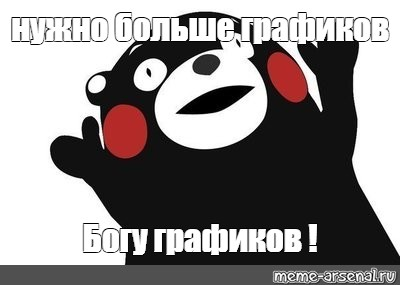



Добавим щепотку графиков...

####Data preparation

Посчитаем еще парочку дополнительных метрик и соберем это все в отдельный датасет для графиков

In [ ]:
graphics_df = processed_df.copy()

In [ ]:
#tags
graphics_df["TagsNum"] = graphics_df.Tags.apply(lambda row: len(row))
graphics_df["MeanTagLen"] = processed_df.Tags.apply(lambda row: np.mean([len(w) for w in row]))
graphics_df.TagsNum = graphics_df.TagsNum.apply(lambda l: round(l,1))
graphics_df.MeanTagLen = graphics_df.MeanTagLen.apply(lambda l: round(l,1))
#title
graphics_df["TitleWordsNum"] = graphics_df.Title.apply(lambda row: len(row))
graphics_df["MeanTitleWordLen"] = processed_df.Title.apply(lambda row: np.mean([len(w) for w in row]))
graphics_df.MeanTitleWordLen = graphics_df.MeanTitleWordLen.apply(lambda l: round(l,1))
graphics_df.TitleWordsNum = graphics_df.TitleWordsNum.apply(lambda l: l)
#body
graphics_df.MeanWordLen = graphics_df.MeanWordLen.apply(lambda l: round(l,1))
graphics_df.WordsNum = graphics_df.WordsNum.apply(lambda l: l%50*50)
#join
graphics_df.Title = graphics_df.Title.apply(lambda l: ' '.join(str(e) for e in l))
graphics_df.Body = graphics_df.Body.apply(lambda l: ' '.join(str(e) for e in l))
graphics_df.Tags = graphics_df.Tags.apply(lambda l: ' '.join(str(e) for e in l))

#### Mean Word Length

In [ ]:
def mean_word_length(data):
  fig, axs = plt.subplots(3, 1, figsize=(40, 27))
  sns.set(font_scale=4)
  sns.set_theme()
  sns.set_style("whitegrid")

  ax0 = sns.countplot(x='MeanWordLen', data=data, ax=axs[0])
  ax0.set_xticklabels(ax0.get_xticklabels(), rotation=90)
  axs[0].set_title('Body Mean Word Length', fontsize=30)

  ax1 = sns.countplot(x='MeanTitleWordLen', data=data, ax=axs[1])
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=90)
  axs[1].set_title('Title Mean Word Length', fontsize=30)

  ax2 = sns.countplot(x='MeanTagLen', data=data, ax=axs[2])
  ax2.set_xticklabels(ax2.get_xticklabels(), rotation=90)
  axs[2].set_title('Tags Mean Word Length', fontsize=30)

  fig.show()

Посмотрим на среднюю длинну слов в каждом признаке. Можем заметить что на Body имеем, во всех смыслах, нормальное распределение. Остальные фичи скорее стремятся к нему.

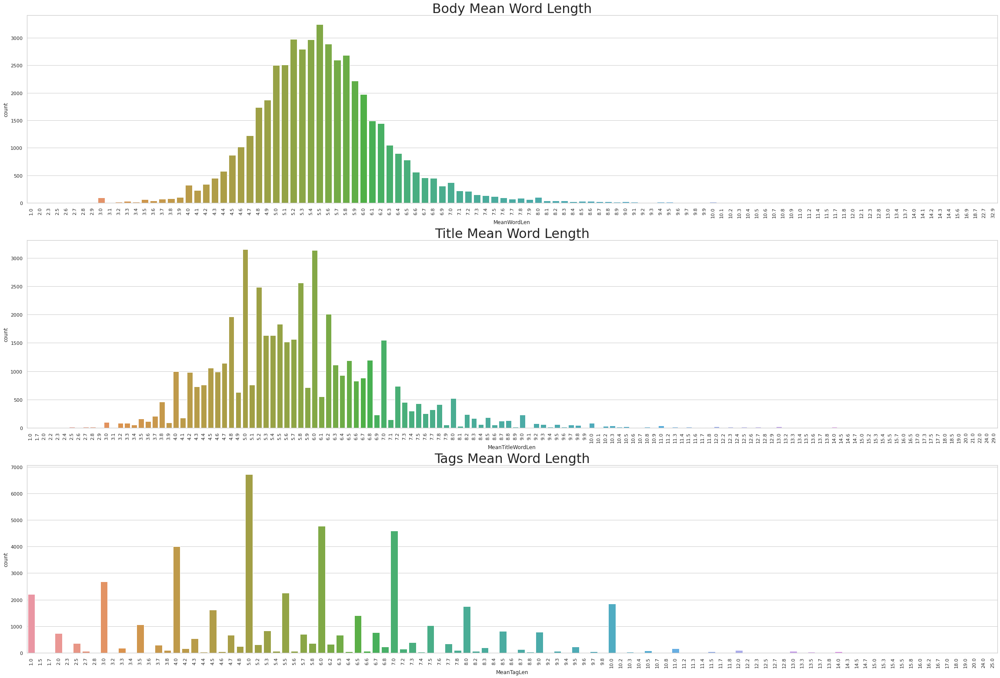

In [ ]:
mean_word_length(graphics_df)

#### Number of Words

In [ ]:
def words_number(data):
  fig, axs = plt.subplots(3, 1, figsize=(40, 27))
  sns.set(font_scale=4)
  sns.set_theme()
  sns.set_style("whitegrid")

  ax0 = sns.countplot(x='WordsNum', data=data, ax=axs[0])
  ax0.set_xticklabels(ax0.get_xticklabels(), rotation=90)
  axs[0].set_title('Body Words Number', fontsize=30)

  ax1 = sns.countplot(x='TitleWordsNum', data=data, ax=axs[1])
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=90)
  axs[1].set_title('Title Words Number', fontsize=30)

  ax2 = sns.countplot(x='ТagsNum', data=data, ax=axs[2])
  ax2.set_xticklabels(ax2.get_xticklabels(), rotation=90)
  axs[2].set_title('Tags Number', fontsize=30)

  fig.show()

Тут мы видим распределение количества слов. Body похоже на логарифмическое распределение, собственно, как и Title. С тегами картина отличается, так как скорее всего, правила размещения вопроса обязывают добавить хотя бы один тег, но не больше 5. Поэтому тегов из одного слова больше

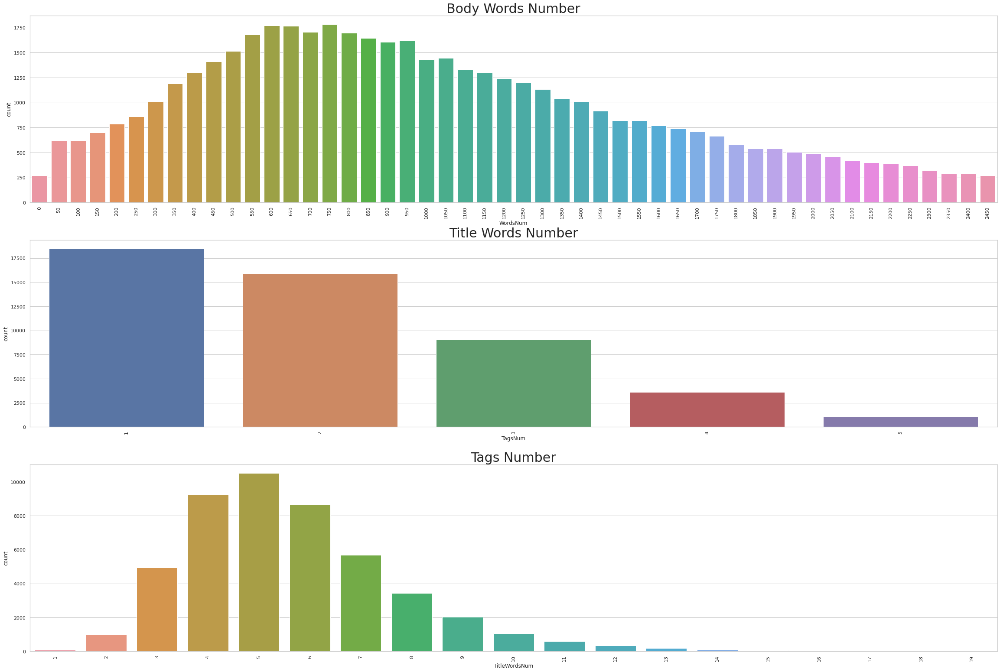

In [ ]:
words_number(graphics_df)

#### Mean Word Length With Target Distribution

In [ ]:
def mean_word_length_distributed_by_target(data):
  fig, axs = plt.subplots(3, 1, figsize=(40, 27))
  sns.set(font_scale=4)
  sns.set_theme()
  sns.set_style("whitegrid")

  ax0 = sns.countplot(x='MeanWordLen', data=data, ax=axs[0], hue='target')
  ax0.set_xticklabels(ax0.get_xticklabels(), rotation=90)
  axs[0].set_title('Body Mean Word Length', fontsize=30)

  ax1 = sns.countplot(x='MeanTitleWordLen', data=data, ax=axs[1], hue='target')
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=90)
  axs[1].set_title('Title Mean Word Length', fontsize=30)

  ax2 = sns.countplot(x='MeanTagLen', data=data, ax=axs[2], hue='target')
  ax2.set_xticklabels(ax2.get_xticklabels(), rotation=90)
  axs[2].set_title('Tags Mean Word Length', fontsize=30)

  fig.show()

In [ ]:
#plt.style.use('ggplot')

На графике видим распределение средней длинны слова по каждому из таргетов. Сложно сказать что-то точно по этим картинкам. Явной зависимости не прослеживается

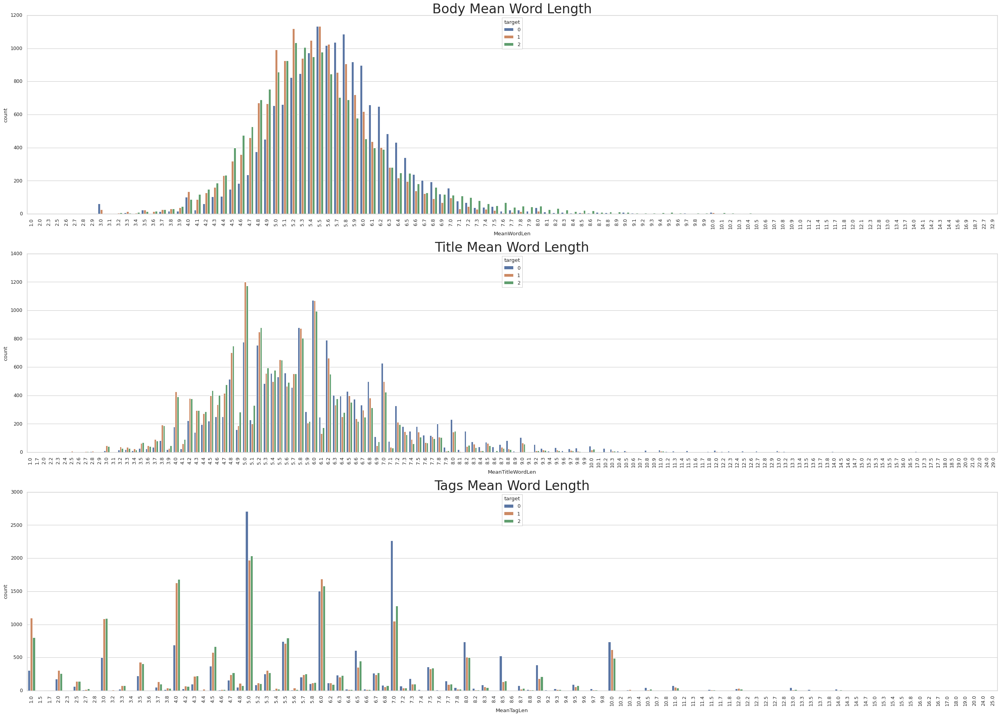

In [ ]:
mean_word_length_distributed_by_target(graphics_df)

#### Number of Words With Target Distribution

In [ ]:
def number_of_words_distributed_by_target(data):
  fig, axs = plt.subplots(3, 1, figsize=(40, 27))
  sns.set(font_scale=4)
  sns.set_theme()
  sns.set_style("whitegrid")

  ax0 = sns.countplot(x='WordsNum', data=data, ax=axs[0], hue='target')
  ax0.set_xticklabels(ax0.get_xticklabels(), rotation=90)
  axs[0].set_title('Body Words Number', fontsize=30)

  ax1 = sns.countplot(x='TagsNum', data=data, ax=axs[1], hue='target')
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=90)
  axs[1].set_title('Title Words Number', fontsize=30)

  ax2 = sns.countplot(x='TitleWordsNum', data=data, ax=axs[2], hue='target')
  ax2.set_xticklabels(ax2.get_xticklabels(), rotation=90)
  axs[2].set_title('Tags Number', fontsize=30)

  fig.show()

Здесь похожая ситуация. Но уже можно отметить, что в Body таргет 0 и 1 коррелируют сильнее, а такргет 2 немного выбивается своим трендом

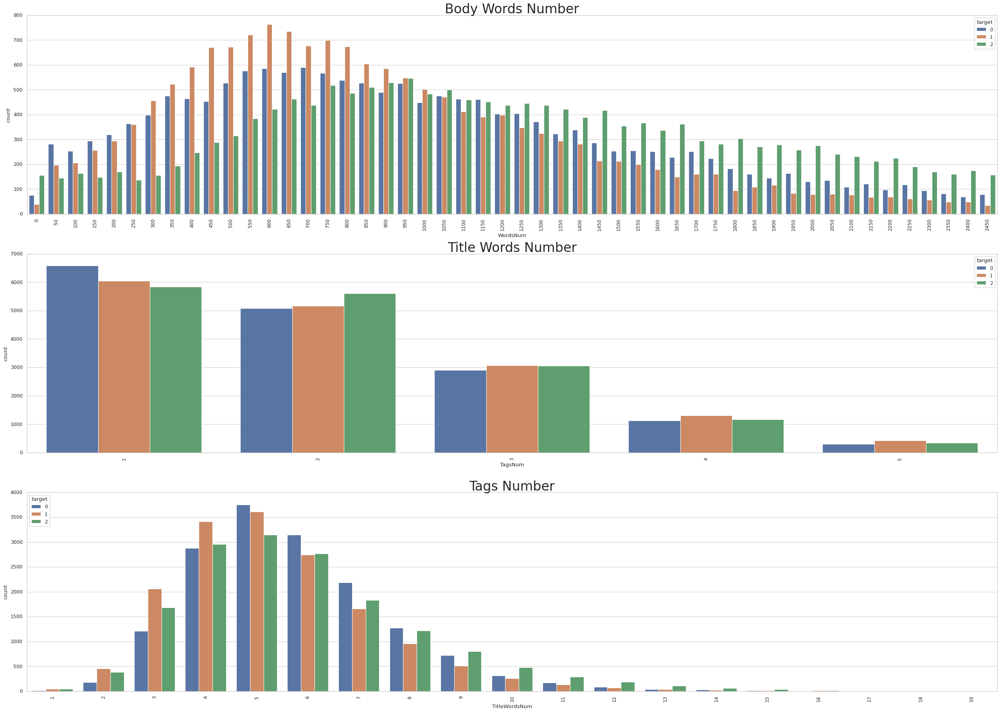

In [ ]:
number_of_words_distributed_by_target(graphics_df)

#### WordCloud

In [ ]:
def word_cloud_on_features(body, title, tags):
  fig, axs = plt.subplots(1, 3, figsize=(50, 10))

  axs[0].imshow(body , interpolation = 'bilinear')
  axs[0].axis('off')
  axs[0].set_title('Body', fontsize=30)

  axs[1].imshow(title , interpolation = 'bilinear')
  axs[1].axis('off')
  axs[1].set_title('Title', fontsize=30)

  axs[2].imshow(tags , interpolation = 'bilinear')
  axs[2].axis('off')
  axs[2].set_title('Tags', fontsize=30)

  fig.show()

In [ ]:
word_cloud_body = WordCloud(max_words=800, width=1500, height=1000, background_color='white').generate(" ".join(graphics_df.Body))
word_cloud_title = WordCloud(max_words=800, width=1500, height=1000, background_color='white').generate(" ".join(graphics_df.Title))
word_cloud_tags = WordCloud(max_words=800, width=1500, height=1000, background_color='white').generate(" ".join(graphics_df.Tags))

Тут идут уже совсем красивые графики. Что можно по ним сказать? Например, что люди плохо знают питон (или просто забывают его на следующий день после лабы, а потом гуглят каждое действие). Еще, видимо, ошибки тоже часто гуглят. Хотя, вот судя по тегам джава и андройд тоже вызывают проблемы довольно часто

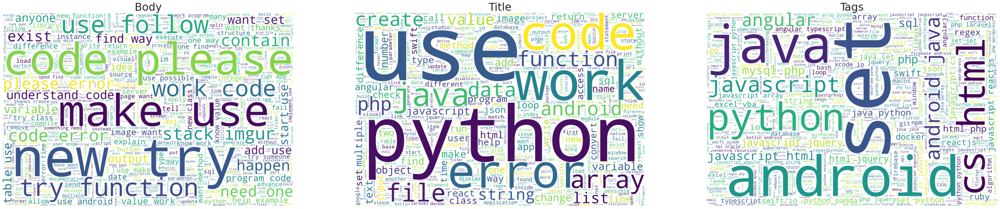

In [ ]:
word_cloud_on_features(word_cloud_body, word_cloud_title, word_cloud_tags)

#### Word Cloud on Each Target by Feature

In [ ]:
def word_cloud_on_target(wc0, wc1, wc2):
  fig, axs = plt.subplots(1, 3, figsize=(50, 10))

  axs[0].imshow(wc0 , interpolation = 'bilinear')
  axs[0].axis('off')
  axs[0].set_title('Target 0', fontsize=30)

  axs[1].imshow(wc1 , interpolation = 'bilinear')
  axs[1].axis('off')
  axs[1].set_title('Target 1', fontsize=30)

  axs[2].imshow(wc2 , interpolation = 'bilinear')
  axs[2].axis('off')
  axs[2].set_title('Target 2', fontsize=30)

  fig.show()

Здесь собраны такие же облака слов, как и предыдущее, только разбитые поразным таргетам

######Title

In [ ]:
word_cloud_title_0 = WordCloud(max_words=800, width=1500, height=1000, background_color='white').generate(" ".join(graphics_df[graphics_df['target'] == 0].Title))
word_cloud_title_1 = WordCloud(max_words=800, width=1500, height=1000, background_color='white').generate(" ".join(graphics_df[graphics_df['target'] == 1].Title))
word_cloud_title_2 = WordCloud(max_words=800, width=1500, height=1000, background_color='white').generate(" ".join(graphics_df[graphics_df['target'] == 2].Title))

Я не могу отметить что-то выдающееся. Во всех таргетах самые частые слова плюс минус одни и те же

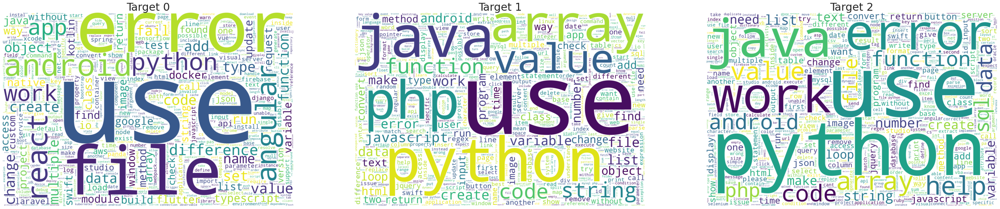

In [ ]:
word_cloud_on_target(word_cloud_title_0, word_cloud_title_1, word_cloud_title_2)

######Body

In [ ]:
word_cloud_body_0 = WordCloud(max_words=1200, width=1500, height=1000, background_color='white').generate(" ".join(graphics_df[graphics_df['target'] == 0].Body))
word_cloud_body_1 = WordCloud(max_words=1200, width=1500, height=1000, background_color='white').generate(" ".join(graphics_df[graphics_df['target'] == 1].Body))
word_cloud_body_2 = WordCloud(max_words=1200, width=1500, height=1000, background_color='white').generate(" ".join(graphics_df[graphics_df['target'] == 2].Body))

Ну тут все сразу стало понятно. Люди просто пишут мало thank, вот их и минусуют. Классификация закончена, расходимся.

Еще, можно отметить, что в таргете 2 часто встречается слово imgur. Видимо, на стак оверфлоу не очень любят кортинки. Код любят больше. Слово stack тоже часто встречается, могу предположить что это кусок от ссылки на stackoverflow с повторяющимся вопросом на который дан ответ, но это лишь домыслы

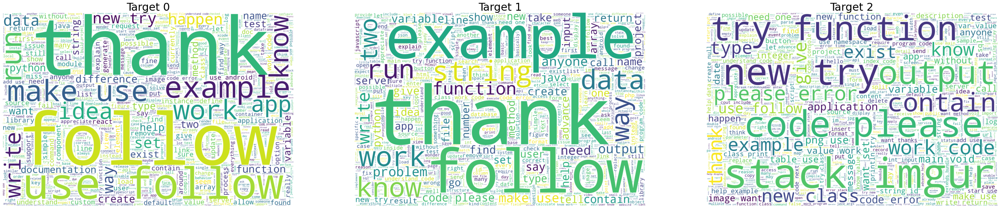

In [ ]:
word_cloud_on_target(word_cloud_body_0, word_cloud_body_1, word_cloud_body_2)

######Tags

In [ ]:
word_cloud_tags_0 = WordCloud(max_words=200, width=1500, height=1000, background_color='white').generate(" ".join(graphics_df[graphics_df['target'] == 0].Tags))
word_cloud_tags_1 = WordCloud(max_words=200, width=1500, height=1000, background_color='white').generate(" ".join(graphics_df[graphics_df['target'] == 1].Tags))
word_cloud_tags_2 = WordCloud(max_words=200, width=1500, height=1000, background_color='white').generate(" ".join(graphics_df[graphics_df['target'] == 2].Tags))

Опять же, сложно что-то сказать конкретное. Выглядит очень похоже

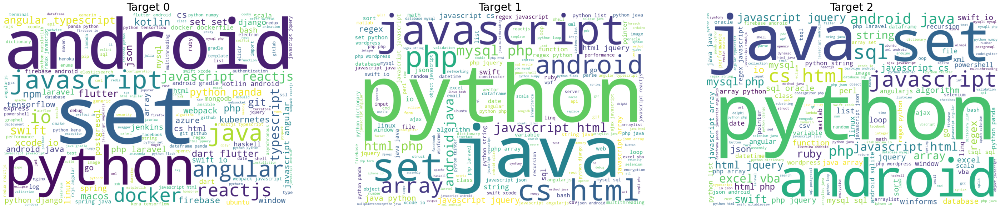

In [ ]:
word_cloud_on_target(word_cloud_tags_0, word_cloud_tags_1, word_cloud_tags_2)

### Neaural Network


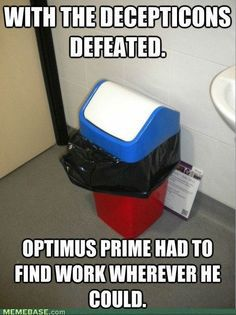


Если кто не знает, после всех войн во вселенной трансформеров, автоботы превратили мегатрона в однослойный перцептрон, а сами основали либу под названием Transformers

So, here come Transformers...

#### Transformers

Сама по себе либа представляет из себя сборник моделей на архитектуре transformer. Причем, как предобученных так и голых (для любителей делать себе больно, видимо). Архитектура transformer тоже довольно интересна. По сути, это такая next level RNN архитектура с принципами акцентирования внимания (All you need is attention!), но при этом, предоставляющая возможность использовать gpu для обучения модели. Слава богам параллелизма!

 Попробуем взять одну из классических моделей, которая уже предобучена на некотором датасете. После чего, соберем на ее основе классификатор для нашей задачи

Рискнем завести все это дело на гпу

In [ ]:
device = torch.device("cuda")

Новый датасет. Здесь мы используем отдельный токенайзер для модели, поэтому нам просто нужен очищенный текст для обучения

In [ ]:
nn_df = df.copy()
nn_df['Body'] = nn_df.Body.apply(remove_html)
nn_df['Tags'] = nn_df.Tags.apply(clean_up_tags)
nn_df['Title'] = nn_df.Title.apply(remove_html)

X_train_t, X_test_t, target_train_t, target_test_t = train_test_split(nn_df.Body, nn_df.target, random_state=2018, test_size=0.3)

Возьмем классическую натренированную bert модель. Uncased потому что выглядит так, что в нашей задаче регистр не важен

In [ ]:
PRE_TRAINED_MODEL_NAME = 'bert-base-uncased'

bert = AutoModel.from_pretrained(PRE_TRAINED_MODEL_NAME)
tokenizer = BertTokenizerFast.from_pretrained(PRE_TRAINED_MODEL_NAME)

Токенизируем входные данные для трейна и теста. У bert тензор может максимально иметь размер 512, поэтому обрежем наш текст до 512 слов

In [ ]:
tokens_train = tokenizer.batch_encode_plus(
    X_train_t.tolist(),
    max_length=512,
    padding=True,
    truncation=True
)

tokens_test = tokenizer.batch_encode_plus(
    X_test_t.tolist(),
    max_length=512,
    padding=True,
    truncation=True
)

Создаем сами тензоры

In [ ]:
train_seq = torch.tensor(tokens_train['input_ids'])
train_mask = torch.tensor(tokens_train['attention_mask'])
train_y = torch.tensor(target_train_t.tolist())

test_seq = torch.tensor(tokens_test['input_ids'])
test_mask = torch.tensor(tokens_test['attention_mask'])
test_y = torch.tensor(target_test_t.tolist())

Создадим data loader который и будет подгружать данные постепенно, небольшими батчами, чтобы колабовская гпу не одурела от десятка тысяч записей. Тут мы пробовали подбирать разный размер батчей. Но явного отличия не заметили

In [ ]:
batch_size = 32

train_data = TensorDataset(train_seq, train_mask, train_y)
train_sampler = RandomSampler(train_data)
train_dataloader = DataLoader(train_data, sampler=train_sampler, batch_size=batch_size)

Здесь мы фризим предобученные веса. Так как наш датасет сравнительно не большой (если сравнивать с датасетом на котором модель предобучена), то очень маловероятно, что мы сможем ей чем то помочь и поднять качество классификации если будем менять эти веса относительно нашей скромной выборки. Так что it seems fair enough

In [ ]:
for param in bert.parameters():
    param.requires_grad = False

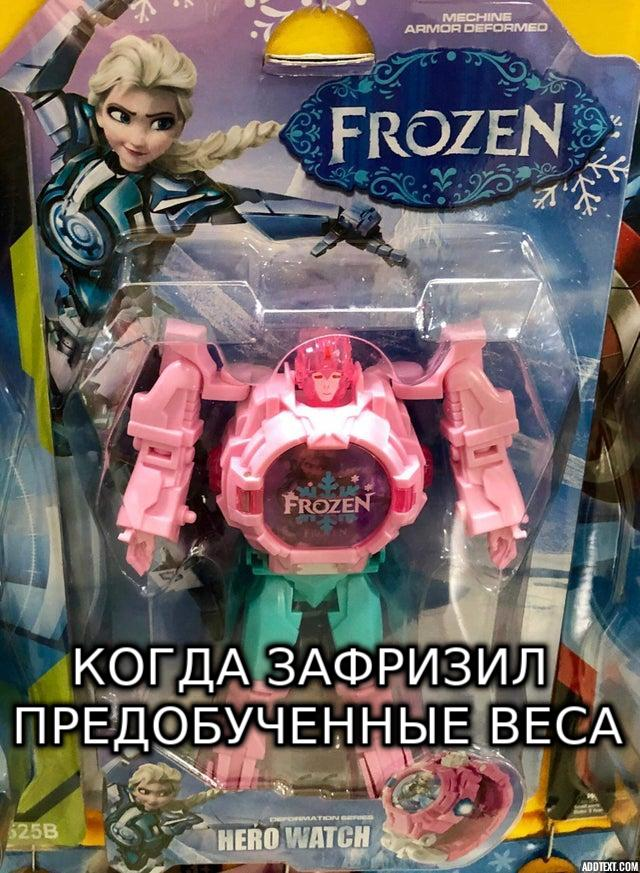

Дальше, создадим обертку в которую положим нашу претрейненную модель, а так же добавим пару полносвязных слоев на выход, которые уже будут решать нашу конкретную задачу. Собственно их мы и будем тренировать, по факту

In [ ]:
class Bert_Classification(nn.Module):

    def __init__(self, bert):
      super(Bert_Classification, self).__init__()
      self.bert = bert 
      self.dropout = nn.Dropout(0.1)
      self.relu =  nn.ReLU()
      # dense layer 1
      self.fc1 = nn.Linear(768, 512)
      # dense layer 2 (output)
      self.fc2 = nn.Linear(512, 3)
      self.softmax = nn.LogSoftmax(dim=1)

    def forward(self, sent_id, mask): 
      _, cls_hs = self.bert(sent_id, attention_mask=mask)
      x = self.fc1(cls_hs)
      x = self.relu(x)
      x = self.dropout(x)
      # output layer
      x = self.fc2(x)
      x = self.softmax(x)
      return x

На выходе поставили софтмакс, как самую адекватную функцию активации для классификации

Создаем нашу обертку, говорим ей на каком железе обучаться

In [ ]:
model = Bert_Classification(bert)
model = model.to(device)

Взяли оптимизатор adam потому что в среднем, на большинстве моделей он работает лучше остальных оптимизаторов. Поэтому, так как возможностей запустить нормальное обучение сетки у нас не много (ограниченное время и ресурсы) то остановили выбор именно на нем

In [ ]:
optimizer = AdamW(model.parameters(), lr = 1e-5)

Функция тренировки. Считаем функцию потерь, выводим среднее. Так же логгируем каждый 500й батч

In [ ]:
cross_entropy  = nn.NLLLoss() 

def train():
  model.train()
  total_loss = 0
  
  for step, batch in enumerate(train_dataloader):
    if step % 500 == 0:
      print('  Batch {:>5,}  of  {:>5,}.'.format(step, len(train_dataloader)))

    batch = [r.to(device) for r in batch]
    sent_id, mask, labels = batch
    model.zero_grad()        
    preds = model(sent_id, mask)

    loss = cross_entropy(preds, labels)
    total_loss = total_loss + loss.item()
    loss.backward()
    torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)

    optimizer.step()
    preds = preds.detach().cpu().numpy()

  avg_loss = total_loss / len(train_dataloader)
  return avg_loss

Собственно, запускаем само обучение. Выставили 10 эпох, лучшую модель сохраняем для теста

Запускали несколько раз. При одной эпохе была точность примерно 0.57. Еще несколько раз все это дело почему то падало по памяти. В итоге, удалось запустить модель на 10 эпох. Удалось достичь 0.66 точности. Скромный результат для такой нейронки, точно знаем, что можно лучше. Можно было еще поэксперементировать с параметрами, но такая модель отрабатывает несколько часов (примерно 6) на 10 эпохах. Этот факт и не позволил еще повысить точность

In [ ]:
best_loss = 100
epochs = 10

for epoch in range(epochs):
  print('\n Epoch {:} / {:}'.format(epoch + 1, epochs))
  curr_loss = train()  
    
  if curr_loss < best_loss:
    best_loss = curr_loss
    torch.save(model.state_dict(), 'drive/MyDrive/data/trained_bert_10_epoch.pt')

print(f'\nBest training Loss: {best_loss:.3f}')


 Epoch 1 / 10
  Batch     0  of  1,050.
  Batch   500  of  1,050.
  Batch 1,000  of  1,050.

 Epoch 2 / 10
  Batch     0  of  1,050.
  Batch   500  of  1,050.
  Batch 1,000  of  1,050.

 Epoch 3 / 10
  Batch     0  of  1,050.
  Batch   500  of  1,050.
  Batch 1,000  of  1,050.

 Epoch 4 / 10
  Batch     0  of  1,050.
  Batch   500  of  1,050.
  Batch 1,000  of  1,050.

 Epoch 5 / 10
  Batch     0  of  1,050.
  Batch   500  of  1,050.
  Batch 1,000  of  1,050.

 Epoch 6 / 10
  Batch     0  of  1,050.
  Batch   500  of  1,050.
  Batch 1,000  of  1,050.

 Epoch 7 / 10
  Batch     0  of  1,050.
  Batch   500  of  1,050.
  Batch 1,000  of  1,050.

 Epoch 8 / 10
  Batch     0  of  1,050.
  Batch   500  of  1,050.
  Batch 1,000  of  1,050.

 Epoch 9 / 10
  Batch     0  of  1,050.
  Batch   500  of  1,050.
  Batch 1,000  of  1,050.

 Epoch 10 / 10
  Batch     0  of  1,050.
  Batch   500  of  1,050.
  Batch 1,000  of  1,050.

Best training Loss: 100.000


In [ ]:
#torch.save(model.state_dict(), 'drive/MyDrive/data/trained_bert_1_epoch.pt')

После рестарта ядра (для очистки памяти) подгружаем натренированную модель

In [ ]:
model.load_state_dict(torch.load('drive/MyDrive/data/trained_bert_10_epoch.pt'))

<All keys matched successfully>

Пробуем очистить отработанный кеш модели

In [ ]:
torch.cuda.empty_cache() 

Мониторинг памяти дает понять, что все очень плохо. Некоторые разы колаб не давал залить тестовый датасет больше чем из 300 записей

In [ ]:
import gc
torch.cuda.empty_cache() 
print(torch.cuda.memory_summary(device=None, abbreviated=False))

|===========================================================================|
|                  PyTorch CUDA memory summary, device ID 0                 |
|---------------------------------------------------------------------------|
|            CUDA OOMs: 3            |        cudaMalloc retries: 3         |
|===========================================================================|
|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |
|---------------------------------------------------------------------------|
| Allocated memory      |   11234 MB |   12134 MB |   19118 MB |    7883 MB |
|       from large pool |   11232 MB |   12132 MB |   19109 MB |    7877 MB |
|       from small pool |       2 MB |       3 MB |       8 MB |       6 MB |
|---------------------------------------------------------------------------|
| Active memory         |   11234 MB |   12134 MB |   19118 MB |    7883 MB |
|       from large pool |   11232 MB |   12132 MB |   19109 MB |

Предиктим

In [ ]:
with torch.no_grad():
  preds = model(test_seq.to(device), test_mask.to(device))
  preds = preds.detach().cpu().numpy()w

In [ ]:
preds = np.argmax(preds, axis = 1)

Результаты, в целом, грустные. Можно лучше. Даже простые алгоритмы машинного обучения на наших данных отработали лучше. Но все равно было интересно покопаться в модели, понять примерную архитектуру и как ее лучше завести (getting started на гитхабе, к сожалению, не дает на это ответа)

In [ ]:
print(classification_report(test_y[:100], preds))

              precision    recall  f1-score   support

           0       0.57      0.46      0.51        28
           1       0.63      0.72      0.67        40
           2       0.77      0.75      0.76        32

    accuracy                           0.66       100
   macro avg       0.66      0.65      0.65       100
weighted avg       0.66      0.66      0.66       100



### One Hot Encoding

Хочется отдельно сказать пару слов про one hot encoding. Мы перепробовали разные варианты как это можно сделать на все датасете. Все они были один хуже другого. Насколько мне известно, это больше применимо для категориальных данных и их приведение к бинарным. Собственно, именно так мы им и пользовались всю жизнь. Гугление на тему применимости такого подхода к нлп практически не дало никаких результатов. То есть, конечно можно найти статьи где люди две строки переводят в бинарную матрицу, но чего то более реального найти не удалось. Все попытки воссоздать это самим закончились неудачно - либо просто не запускалось, либо размерность не совпадала, либо out of memory. Касательно размерности, есть подозрения, что она получится неадекватно большой (примерно 13к уникальных слов). Так что какие-то наработки ниже остались. Не хочется подменять понятия и потом говорить что мы что-то поняли. Сдаемся

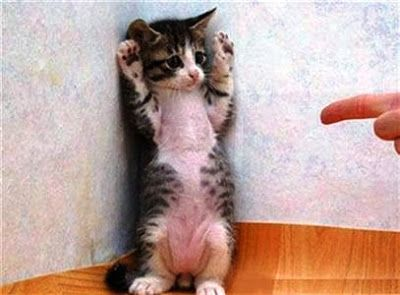

In [ ]:
import itertools
itertools.chain.from_iterable(df_train_embedding.Text)

In [ ]:
def test(df):
  tokens = itertools.chain.from_iterable(df.Text)
  word_to_id = {t: idx for idx, t in enumerate(set(tokens))}

  token_ids = [[word_to_id[t] for t in row] for row in df.Text]
  onehot_encoder = OneHotEncoder()
  X = onehot_encoder.fit_transform(token_ids)
  return X

In [ ]:
label_encoder = LabelEncoder()
onehot_encoder = OneHotEncoder(sparse=False)

def onehot_encoded(data):
  integer_encoded = label_encoder.fit_transform(list(data))

  integer_encoded = integer_encoded.reshape(len(integer_encoded), 1)
  onehot_encoded = onehot_encoder.fit_transform(integer_encoded)

  return onehot_encoded

In [ ]:
all_words = set()
for row in df_train_embedding.Text[:500]:
  for w in row:
    all_words.add(w)

In [ ]:
encoded = label_encoder.fit_transform(list(all_words))
encoded2 = encoded.reshape(len(encoded), 1)

In [ ]:
tokens = itertools.chain.from_iterable(df_train_embedding.Text)
word_to_id = {t: idx for idx, t in enumerate(set(tokens))}

n = 100

matrix = np.ndarray((0, n))

def get_vector(sentence):   
  l = np.full(n, 0)
  for i, w in enumerate(sentence):
    if i + 1 > n:
      break
    l[i] = word_to_id[w]
  return l

for row in df_train_embedding.Text:
  matrix = np.vstack((matrix, get_vector(row)))

#token_ids = [[word_to_id[t] for t in row] for row in df_train_embedding.Text]
onehot_encoder = OneHotEncoder(categories=n)

## ML Algorithms

Секция с алгоритмами машинного обучения. Мы решили взять такой список


*   KNN
*   Naive Bayes
*   Logistic Regression
*   Random Forest
*   Decision Tree
*   XGBoost
*   AdaBoost

К каждому из этих алгоритмов так же добавили версию с грид серчем. Будем запускать их последовательно на разных эмбедингов. При вызове функции так же сразу строится график и выводятся метрики обученной модели








### KNN

In [ ]:
def knn_grid_search(X,Y):
  params = {'n_neighbors': [1,3,5,13,15,20],
            'weights': ['uniform','distance'],
            'metric':['euclidean','manhattan']}
  knn_grid = GridSearchCV(KNeighborsClassifier(), param_grid=params, n_jobs=10, cv=5, verbose=1)
  knn_grid.fit(X,Y)
  return knn_grid.best_params_


def knn_on_df(df, target, sample, isGridSearch=True):
  X_train, X_test, target_train, target_test = train_test_split(df[:sample], target[:sample], test_size=0.3, random_state=33)
  if (isGridSearch):
    start = time.time()
    best_params = knn_grid_search(X_train, target_train)
    finish = time.time()
    print(f"Finished in: {finish - start}")
    print(best_params)
    knn = KNeighborsClassifier(n_neighbors=best_params['n_neighbors'],weights=best_params['weights'],metric=best_params['metric'])
  else:
    knn = KNeighborsClassifier()
  KNeighborsClassifier()
  knn.fit(X_train, target_train)
  predicted = knn.predict(X_test)

  fig, ax = plt.subplots(1, 1, figsize=(17, 9))

  ax.plot(predicted, "b-", label="Predicted")
  ax.plot(target_test.values, "r-", label="True")
  ax.set_title("Knn ")
  ax.label_outer()
  plt.legend(loc="best")
  fig.show()

  acc = metrics.accuracy_score(y_true=target_test, y_pred=predicted)
  report = metrics.classification_report(
      y_true=target_test,
      y_pred=predicted,
      target_names=["0", "1", "2"])
  print(report)
  print("    accuracy      %0.3f" % acc)


### Naive Bayes


In [ ]:
def naive_bayes_grid_search(X,Y):
  params = {'alpha': [0.01, 0.1, 0.5, 1.0, 10.0]}
  nb_grid = GridSearchCV(BernoulliNB(), param_grid=params, n_jobs=-1, cv=5, verbose=5)
  nb_grid.fit(X,Y)
  return nb_grid.best_params_


def naive_bayes_on_df(df, target, sample, isGridSearch=True):
  X_train, X_test, target_train, target_test = train_test_split(df[:sample], target[:sample], test_size=0.3, random_state=33)
  if (isGridSearch):
    start = time.time()
    best_params = naive_bayes_grid_search(X_train, target_train)
    finish = time.time()
    print(f"Finished in: {finish - start}")
    print(best_params)
    nb = BernoulliNB()
  else:
    nb = BernoulliNB()
  nb.fit(X_train, target_train)
  predicted = nb.predict(X_test)

  fig, ax = plt.subplots(1, 1, figsize=(17, 9))

  ax.plot(predicted, "b-", label="Predicted")
  ax.plot(target_test.values, "r-", label="True")
  ax.set_title("Naive Bayes ")
  ax.label_outer()
  plt.legend(loc="best")
  fig.show()

  acc = metrics.accuracy_score(y_true=target_test, y_pred=predicted)
  report = metrics.classification_report(
      y_true=target_test,
      y_pred=predicted,
      target_names=["0", "1", "2"])
  print(report)
  print("    accuracy      %0.3f" % acc)



### Logistic Regression


In [ ]:
def logistic_regression_grid_search(X, y, nfolds):
  clf = LogisticRegression()
  grid_values = {'penalty': ['l1', 'l2'],"C":np.logspace(-3,1,7)}
  grid_clf_acc = GridSearchCV(clf, param_grid = grid_values, cv=nfolds)
  grid_clf_acc.fit(X, y)
  return grid_clf_acc.best_params_

def logistic_regression_on_df(df, target, sample, isGridSearch=True):
  X_train, X_test, target_train, target_test = train_test_split(df[:sample], target[:sample], test_size=0.3, random_state=33)
  if (isGridSearch):
    start = time.time()
    best_params = logistic_regression_grid_search(X_train, target_train, 5)
    finish = time.time()
    print(f"Finished in: {finish - start}")
    print(best_params)
    lr = LogisticRegression(penalty=best_params["penalty"],C=best_params["C"])
  else:
    lr = LogisticRegression()
  lr.fit(X_train, target_train)
  predicted = lr.predict(X_test)

  fig, ax = plt.subplots(1, 1, figsize=(17, 9))

  ax.plot(predicted, "b-", label="Predicted")
  ax.plot(target_test.values, "r-", label="True")
  ax.set_title("Logistic Regression")
  ax.label_outer()
  plt.legend(loc="best")
  fig.show()

  acc = metrics.accuracy_score(y_true=target_test, y_pred=predicted)
  report = metrics.classification_report(
      y_true=target_test,
      y_pred=predicted,
      target_names=["0", "1", "2"])
  print(report)
  print("    accuracy      %0.3f" % acc)

### Random Forest

In [ ]:
def random_forest_grid_search(X, y, nfolds):
    param_grid = { 'criterion':['gini','entropy'],'max_leaf_nodes': [1, None], 'bootstrap': [True, False]}
    model=RandomForestClassifier()
    model_gscv = GridSearchCV(model, param_grid, cv=nfolds, n_jobs=10, verbose=2)
    model_gscv.fit(X, y)
    del model
    return model_gscv.best_params_

def random_forest_on_df(df, target, sample, isGridSearch=True):
  X_train, X_test, target_train, target_test = train_test_split(df[:sample], target[:sample], test_size=0.3, random_state=33)
  if (isGridSearch):
    start = time.time()
    best_params = random_forest_grid_search(X_train, target_train, 5)
    finish = time.time()
    print(f"Finished in: {finish - start}")
    print(best_params)
    rf = RandomForestClassifier(criterion=best_params["criterion"],max_leaf_nodes=best_params["max_leaf_nodes"], random_state=33, bootstrap=best_params["bootstrap"],verbose=1)
  else:
    rf = RandomForestClassifier()
  rf.fit(X_train, target_train)
  predicted = rf.predict(X_test)
  fig, ax = plt.subplots(1, 1, figsize=(17, 9))

  ax.plot(predicted, "b-", label="Predicted")
  ax.plot(target_test.values, "r-", label="True")
  ax.set_title("Random Forest")
  ax.label_outer()
  plt.legend(loc="best")
  fig.show()

  acc = metrics.accuracy_score(y_true=target_test, y_pred=predicted)
  report = metrics.classification_report(
      y_true=target_test,
      y_pred=predicted,
      target_names=["0", "1", "2"])
  print(report)
  print("    accuracy      %0.3f" % acc)


### Decision Tree

In [ ]:
def dtree_grid_search(X, y, nfolds):
    param_grid = { 'criterion':['gini','entropy'],'max_features': ['auto', 'sqrt', 'log2']}
    dtree_model=DecisionTreeClassifier()
    dtree_gscv = GridSearchCV(dtree_model, param_grid, cv=nfolds)
    dtree_gscv.fit(X, y)
    return dtree_gscv.best_params_

def decision_tree_on_df(df, target, sample, isGridSearch=True):
  X_train, X_test, target_train, target_test = train_test_split(df[:sample], target[:sample], test_size=0.3, random_state=33)
  if (isGridSearch):
      best_params = dtree_grid_search(X_train, target_train, 5)
      print(best_params)
      dt = DecisionTreeClassifier(criterion=best_params["criterion"],max_features=best_params["max_features"])
  else:
      dt = DecisionTreeClassifier()
  dt.fit(X_train, target_train)
  predicted = dt.predict(X_test)

  fig, ax = plt.subplots(1, 1, figsize=(17, 9))

  ax.plot(predicted, "b-", label="Predicted")
  ax.plot(target_test.values, "r-", label="True")
  ax.set_title("Decision Tree")
  ax.label_outer()
  plt.legend(loc="best")
  fig.show()

  acc = metrics.accuracy_score(y_true=target_test, y_pred=predicted)
  report = metrics.classification_report(
      y_true=target_test,
      y_pred=predicted,
      target_names=["0", "1", "2"])
  print(report)
  print("    accuracy      %0.3f" % acc)

###XGBOOST

In [ ]:
import xgboost as xgb
from xgboost import XGBClassifier

def xgboost_greed_search(X, Y):
  params =  {'n_estimators':[10, 50, 100]}
  xg_gscv = GridSearchCV(XGBClassifier(), params, cv=5)
  xg_gscv.fit(X,Y)
  return xg_gscv.best_params_

def xgboost(df, target, sample, isGridSearch=True):
  X_train, X_test, target_train, target_test = train_test_split(df[:sample], target[:sample], test_size=0.3, random_state=33)
  if (isGridSearch):
    start = time.time()
    best_params = xgboost_greed_search(X_train, target_train)
    finish = time.time()
    print(f"Finished in: {finish - start}")
    print(best_params)
    xg = XGBClassifier(n_estimators =best_params['n_estimators'])
  else:
    xg = XGBClassifier()
  xg.fit(X_train, target_train)
  predicted = xg.predict(X_test)
  
  fig, ax = plt.subplots(1, 1, figsize=(17, 9))

  ax.plot(predicted, "b-", label="Predicted")
  ax.plot(target_test.values, "r-", label="True")
  ax.set_title("Knn ")
  ax.label_outer()
  plt.legend(loc="best")
  fig.show()

  acc = metrics.accuracy_score(y_true=target_test, y_pred=predicted)
  report = metrics.classification_report(
      y_true=target_test,
      y_pred=predicted,
      target_names=["0", "1", "2"])
  print(report)
  print("    accuracy      %0.3f" % acc)

###ADABOOST

In [ ]:
def adaboost_greed_search(X, Y):
  params =  {'n_estimators':[10, 50, 100]}
  ab_gscv = GridSearchCV(AdaBoostClassifier(), params, cv=5)
  ab_gscv.fit(X,Y)
  return ab_gscv.best_params_

def adaboost(df, target, sample, isGridSearch=True):
  X_train, X_test, target_train, target_test = train_test_split(df[:sample], target[:sample], test_size=0.3, random_state=33)
  if (isGridSearch):
    start = time.time()
    best_params = adaboost_greed_search(X_train, target_train)
    finish = time.time()
    print(f"Finished in: {finish - start}")
    print(best_params)
    ab = AdaBoostClassifier(n_estimators =best_params['n_estimators'])
  else:
    ab = AdaBoostClassifier()
  ab.fit(X_train, target_train)
  predicted = ab.predict(X_test)
  
  fig, ax = plt.subplots(1, 1, figsize=(17, 9))

  ax.plot(predicted, "b-", label="Predicted")
  ax.plot(target_test.values, "r-", label="True")
  ax.set_title("Knn ")
  ax.label_outer()
  plt.legend(loc="best")
  fig.show()

  acc = metrics.accuracy_score(y_true=target_test, y_pred=predicted)
  report = metrics.classification_report(
      y_true=target_test,
      y_pred=predicted,
      target_names=["0", "1", "2"])
  print(report)
  print("    accuracy      %0.3f" % acc)

## Embeddings

### Plot Utils


Функции для отрисовки разных графиков

In [ ]:
def show_word_cloud(vocab):
    plot_pd = pd.DataFrame(columns=['ft']).from_dict(dict(vocab), orient='index')
    plot_pd.columns = ['ft']
    text = plot_pd.sort_values(by=['ft'], ascending=True).index
    text = ' '.join(list(text))
    wordcloud = WordCloud(max_font_size=300, width=800, height= 400, max_words=200).generate(text)

    plt.figure(figsize=(25, 25))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.show()

In [ ]:
def bokeh_representation(model, vocab, title, limit):
    output_notebook()
    plot = bp.figure(plot_width=1024, plot_height=768, title=title,
        tools="pan,wheel_zoom,box_zoom,reset,hover",
        x_axis_type=None, y_axis_type=None, min_border=1)

    word_vectors = [model[w] for w in list(vocab.keys())[:limit]]

    tsne_model = TSNE(n_components=2, verbose=1, random_state=0)
    tsne = tsne_model.fit_transform(word_vectors)

    tsne_df = pd.DataFrame(tsne, columns=['x', 'y'])
    tsne_df['words'] = list(vocab.keys())[:limit]

    plot.scatter(x='x', y='y', source=tsne_df)
    hover = plot.select(dict(type=HoverTool))
    hover.tooltips={"word": "@words"}
    show(plot)

In [ ]:
def tsne_plot_similar_words(keys, model, a=0.5):
    embedding_clusters = []
    word_clusters = []
    for word in keys:
        embeddings = []
        words = []
        for similar_word, _ in model.most_similar(word, topn=30):
            words.append(similar_word)
            embeddings.append(model[similar_word])
        embedding_clusters.append(embeddings)
        word_clusters.append(words)
    tsne_model_en_2d = TSNE(perplexity=15, n_components=2, init='pca', n_iter=3500, random_state=32)
    embedding_clusters = np.array(embedding_clusters)
    n, m, k = embedding_clusters.shape
    embeddings_en_2d = np.array(tsne_model_en_2d.fit_transform(embedding_clusters.reshape(n * m, k))).reshape(n, m, 2)
    
    plt.figure(figsize=(16, 9))
    colors = cm.rainbow(np.linspace(0, 1, len(keys)))
    for label, embeddings, words, color in zip(keys, embedding_clusters, word_clusters, colors):
        x = embeddings[:,0]
        y = embeddings[:,1]
        plt.scatter(x, y, c=color, alpha=a, label=label)
        for i, word in enumerate(words):
            plt.annotate(word, alpha=0.5, xy=(x[i], y[i]), xytext=(5, 2), 
                         textcoords='offset points', ha='right', va='bottom', size=8)
    plt.legend(loc=4)
    plt.grid(True)
    plt.show()

###Data preparation

Утил функции. Также, собираем новый датафрейм, склеиваем текст в один признак

In [ ]:
def get_model_vectors(corpus, model):    
    
  def get_vector(sentence):   
    word_tokens = word_tokenize(sentence)
    vector = 0
    for word in word_tokens:
      try: 
        vector += model.wv[word]
      except:
        continue
    return vector
    
  out_corpus = np.stack(corpus.apply(lambda x: get_vector(x)).to_numpy())
    
  return out_corpus

In [ ]:
df_train_embedding = processed_df.copy()
df_train_embedding['RawTitle'] = df_train_embedding.Title.apply(lambda l: ' '.join(str(e) for e in l))
df_train_embedding['RawBody'] = df_train_embedding.Body.apply(lambda l: ' '.join(str(e) for e in l))
df_train_embedding['Text'] = df_train_embedding[['Body', 'Title']].apply(lambda s: s[0].union(s[1]), axis=1)
df_train_embedding['RawText'] = df_train_embedding[['RawBody', 'RawTitle']].apply(lambda s: s[0]+' '+(s[1]), axis=1)
df_train_embedding.drop(['Body', 'Title', 'RawTitle', 'RawBody'], axis=1, inplace=True)
df_train_embedding = df_train_embedding.dropna()

In [ ]:
repeat_vocab = [item for sublist in df_train_embedding.Text for item in sublist]  
vocab = set(repeat_vocab)

In [ ]:
keys = ['java', 'error', 'android', 'function', 'program', 'string']

### FastText

####Model generation

Обычный фаст текст. Натренируем его с нуля

In [ ]:
FT_FILE = "/content/drive/MyDrive/data/ft_trained.model"

In [ ]:
ft = FT_trainable(size=100, window=5)
ft.build_vocab(df_train_embedding.Text)
ft.train(
    sentences=df_train_embedding.Text, epochs=ft.epochs,
    total_examples=ft.corpus_count, total_words=ft.corpus_total_words
)
print(ft)
ft.save(FT_FILE)

FastText(vocab=10382, size=100, alpha=0.025)


In [ ]:
ft = FT_trainable.load(FT_FILE)

####Visualization

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB o

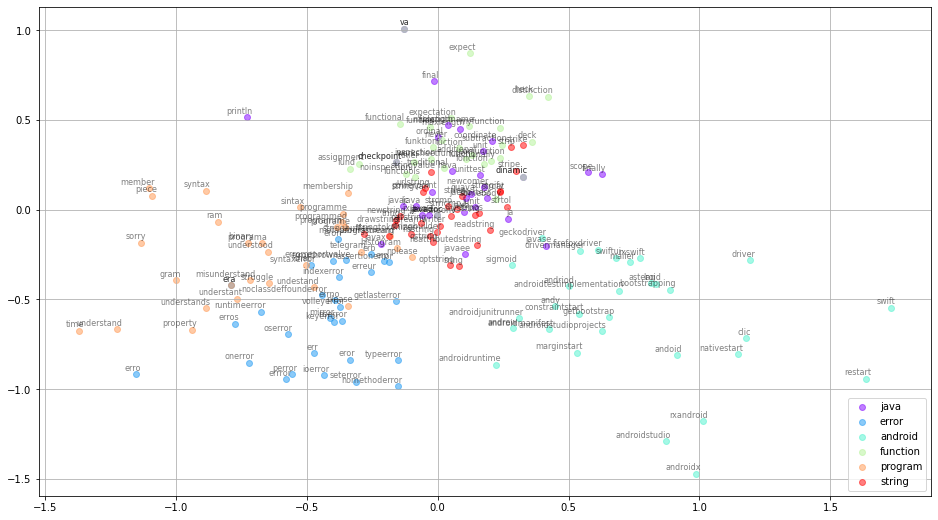

In [ ]:
tsne_plot_similar_words(keys, ft)

Тут можем посмотреть распределение слов. Тут сложно что-то сказать. У других эмбеддингов получились более четкие кластеры

In [ ]:
bokeh_representation(ft, ft.wv.vocab, "FastText", 1000)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1000 samples in 0.019s...
[t-SNE] Computed neighbors for 1000 samples in 0.488s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1000
[t-SNE] Mean sigma: 2.285600
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.830429
[t-SNE] KL divergence after 1000 iterations: 1.111572


In [ ]:
tsne_plot_similar_words(keys, embeddings_en_2d, word_clusters)

Странные слова. Очень много странных слов. Показывает какой вокабуляр мы натренировали

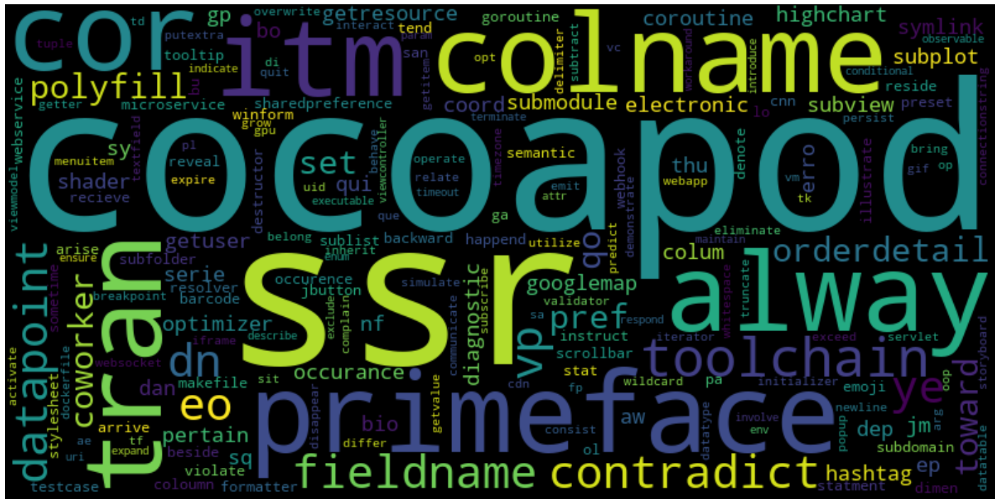

In [ ]:
show_word_cloud(ft.wv.vocab)

####Vectorization

Векторизуем наши данные с помощью натренированной модели, чтобы потом запушить их в машинное обучение

In [ ]:
ft_matrix = get_model_vectors(df_train_embedding.RawText, ft)

####Alghorithm test

Ну и сами алгоритмы. KNN очень плох. Практически рандом гесс. Тут еще стоит оговориться, что почти везде берем выбрку из 2к записей для трейна. Опыт показал, что большее число в нашем случае либо не играет роли вообще, либо ухудшает метрики

              precision    recall  f1-score   support

           0       0.50      0.71      0.59       195
           1       0.44      0.42      0.43       192
           2       0.74      0.48      0.58       213

    accuracy                           0.54       600
   macro avg       0.56      0.54      0.53       600
weighted avg       0.57      0.54      0.54       600

    accuracy      0.537


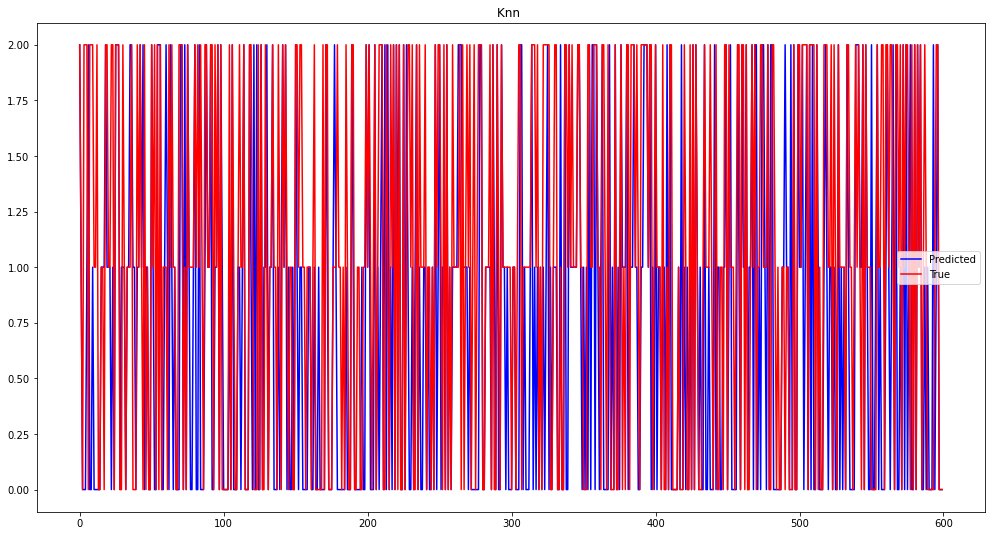

In [ ]:
knn_on_df(ft_matrix, processed_df.target, 2000, False)

KNN с гридсерчем, уже лучше

Fitting 5 folds for each of 24 candidates, totalling 120 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.0s
[Parallel(n_jobs=10)]: Done 120 out of 120 | elapsed:    7.1s finished


Finished in: 7.090100526809692
{'metric': 'euclidean', 'n_neighbors': 20, 'weights': 'distance'}
              precision    recall  f1-score   support

           0       0.59      0.74      0.66       195
           1       0.47      0.51      0.49       192
           2       0.76      0.51      0.61       213

    accuracy                           0.59       600
   macro avg       0.60      0.59      0.59       600
weighted avg       0.61      0.59      0.59       600

    accuracy      0.587


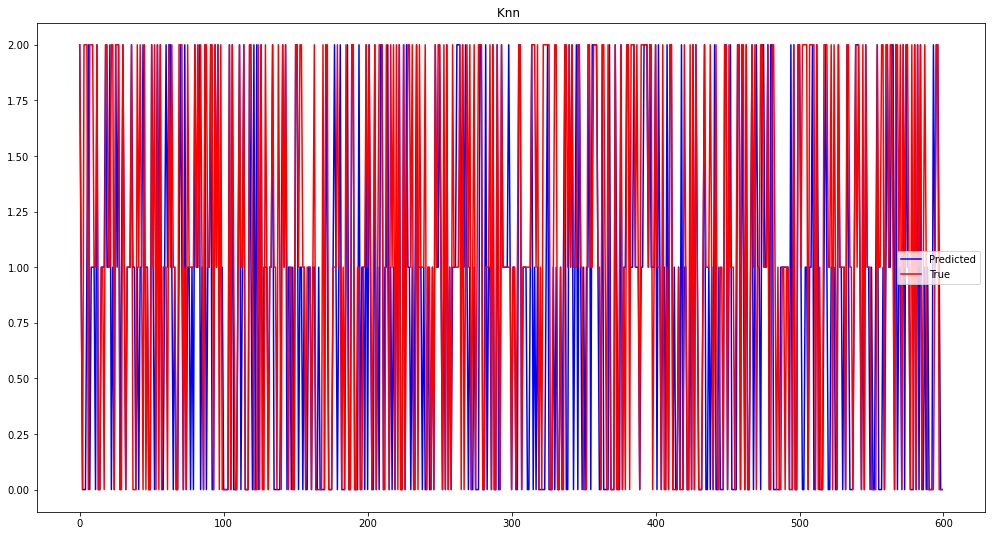

In [ ]:
knn_on_df(ft_matrix, processed_df.target, 2000, True)

Наивный баес в обоих случаях показал себя ровно как KNN

Fitting 5 folds for each of 5 candidates, totalling 25 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:    0.2s finished


Finished in: 0.8529953956604004
{'alpha': 0.01}
              precision    recall  f1-score   support

           0       0.58      0.74      0.65       195
           1       0.48      0.32      0.39       192
           2       0.66      0.69      0.67       213

    accuracy                           0.59       600
   macro avg       0.57      0.58      0.57       600
weighted avg       0.58      0.59      0.57       600

    accuracy      0.588


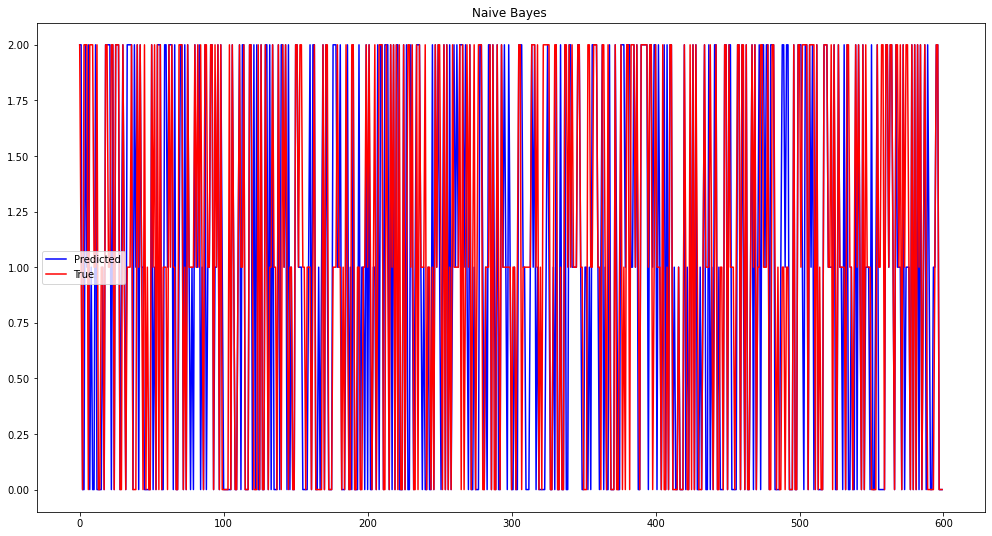

In [ ]:
naive_bayes_on_df(ft_matrix, processed_df.target, 2000)

              precision    recall  f1-score   support

           0       0.58      0.74      0.65       195
           1       0.48      0.32      0.39       192
           2       0.66      0.69      0.67       213

    accuracy                           0.59       600
   macro avg       0.57      0.58      0.57       600
weighted avg       0.58      0.59      0.57       600

    accuracy      0.588


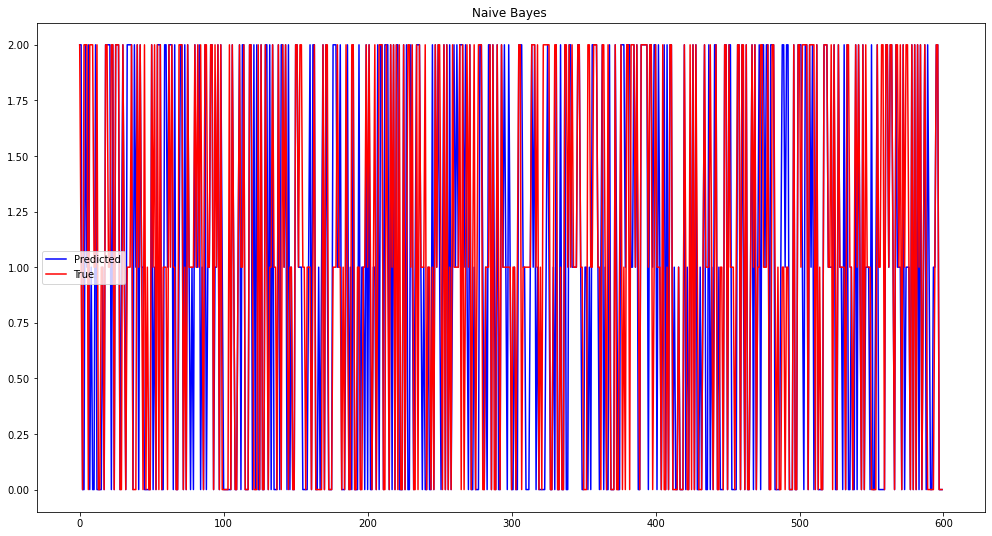

In [ ]:
naive_bayes_on_df(ft_matrix, processed_df.target, 2000, False)

С десижен три явно что-то пошло не так. Метрики хуже рандом гесса

{'criterion': 'entropy', 'max_features': 'log2'}
              precision    recall  f1-score   support

           0       0.51      0.56      0.53       195
           1       0.40      0.40      0.40       192
           2       0.56      0.51      0.54       213

    accuracy                           0.49       600
   macro avg       0.49      0.49      0.49       600
weighted avg       0.49      0.49      0.49       600

    accuracy      0.492


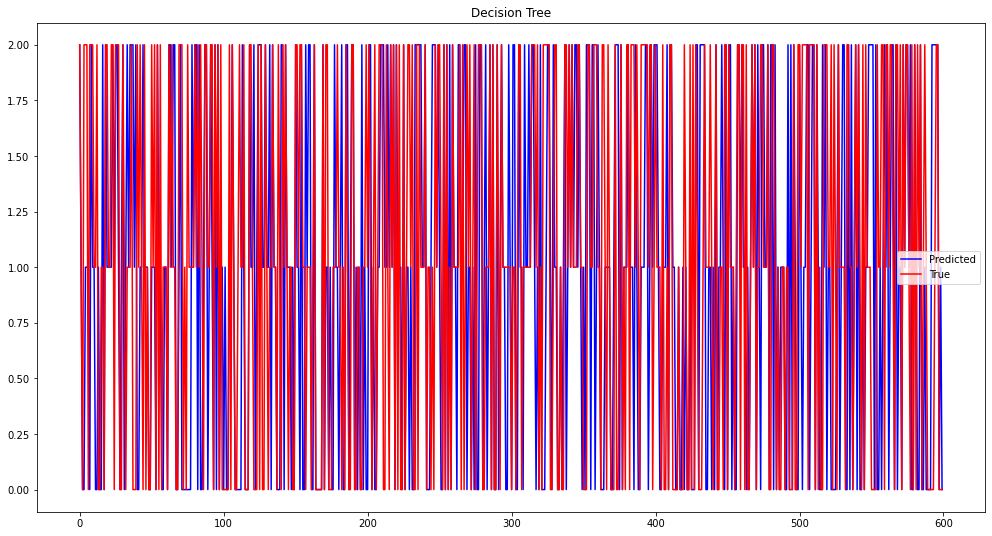

In [ ]:
decision_tree_on_df(ft_matrix, processed_df.target, 2000)

              precision    recall  f1-score   support

           0       0.55      0.48      0.51       195
           1       0.35      0.38      0.37       192
           2       0.56      0.58      0.57       213

    accuracy                           0.48       600
   macro avg       0.49      0.48      0.48       600
weighted avg       0.49      0.48      0.48       600

    accuracy      0.483


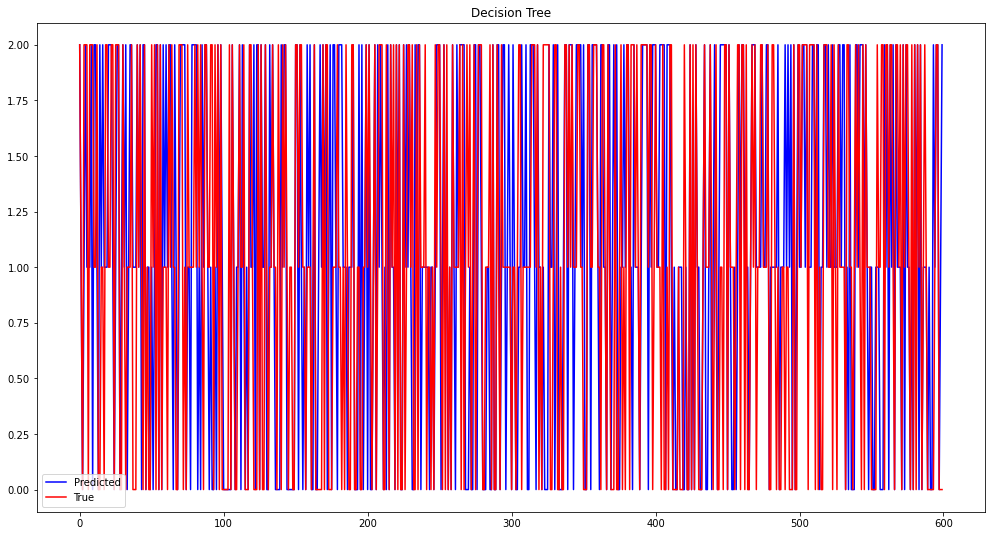

In [ ]:
decision_tree_on_df(ft_matrix, processed_df.target, 2000, False)

Чуть лучше, чем у остальных, но в целом, в рамках обычной статистической погрешности

Fitting 5 folds for each of 8 candidates, totalling 40 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  21 tasks      | elapsed:   14.3s
[Parallel(n_jobs=10)]: Done  40 out of  40 | elapsed:   25.1s finished


Finished in: 27.705408573150635
{'bootstrap': False, 'criterion': 'gini', 'max_leaf_nodes': None}


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    1.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    0.0s finished


              precision    recall  f1-score   support

           0       0.59      0.71      0.64       195
           1       0.47      0.42      0.44       192
           2       0.71      0.65      0.68       213

    accuracy                           0.59       600
   macro avg       0.59      0.59      0.59       600
weighted avg       0.59      0.59      0.59       600

    accuracy      0.593


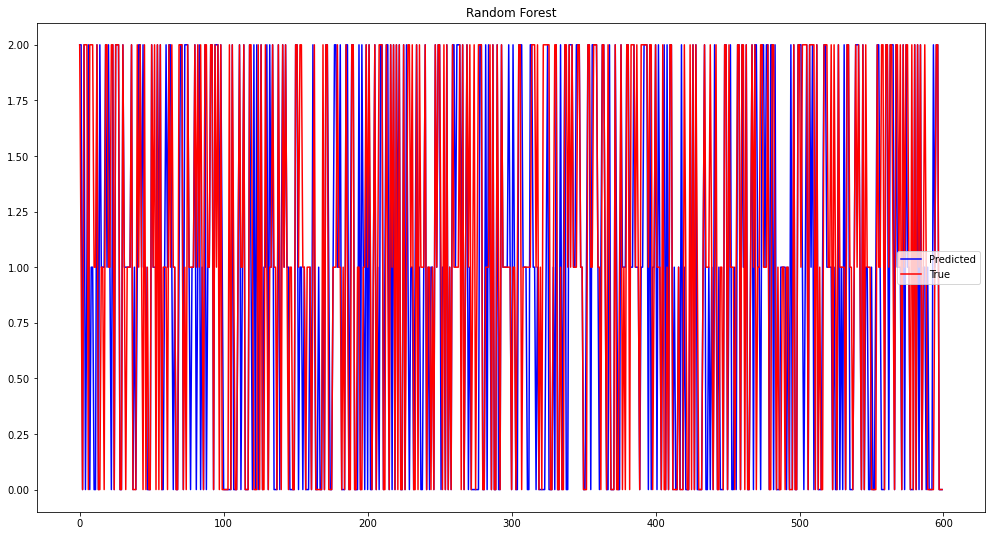

In [ ]:
random_forest_on_df(ft_matrix, processed_df.target, 2000)

Пробуем на всем датасете. Графикам уже стало плохо от такого количества данных. Но метрики уже веселее

              precision    recall  f1-score   support

           0       0.68      0.73      0.70      4820
           1       0.58      0.59      0.58      4835
           2       0.75      0.67      0.71      4745

    accuracy                           0.66     14400
   macro avg       0.67      0.66      0.67     14400
weighted avg       0.67      0.66      0.67     14400

    accuracy      0.665


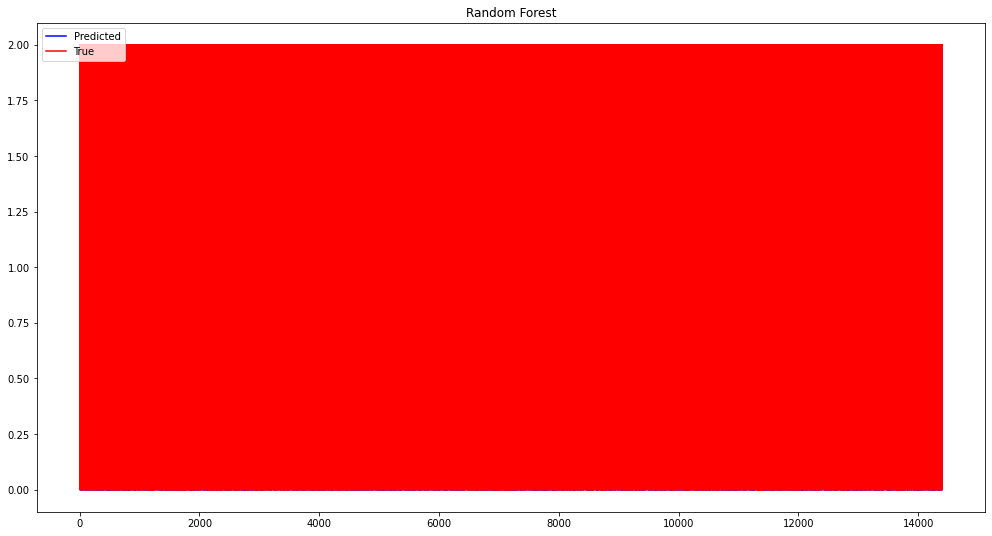

In [ ]:
random_forest_on_df(ft_matrix, processed_df.target, 48000, False)

Ну все, логистическая регрессия вин

Finished in: 4.837781667709351
{'C': 0.001, 'penalty': 'l2'}
              precision    recall  f1-score   support

           0       0.71      0.75      0.73       195
           1       0.55      0.54      0.54       192
           2       0.73      0.71      0.72       213

    accuracy                           0.67       600
   macro avg       0.67      0.67      0.67       600
weighted avg       0.67      0.67      0.67       600

    accuracy      0.670


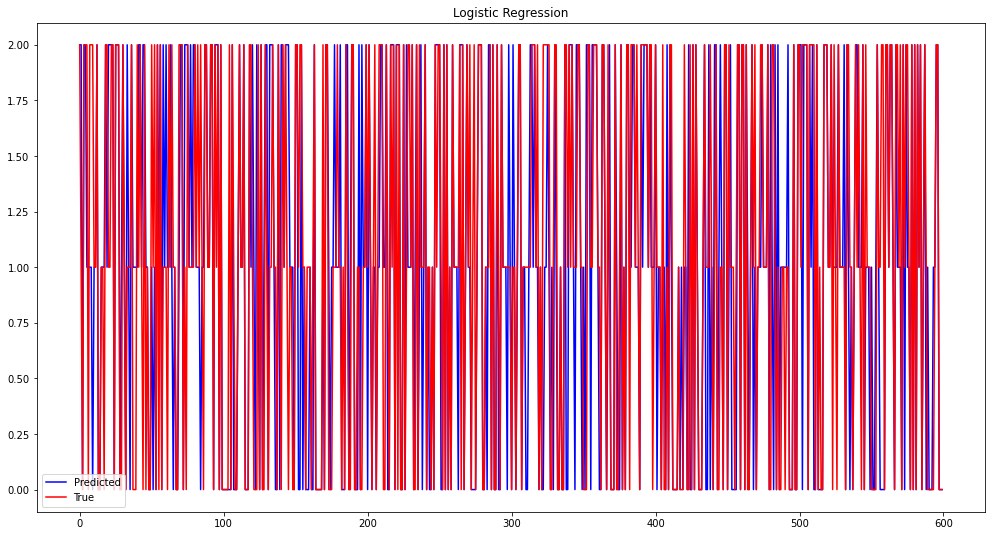

In [ ]:
logistic_regression_on_df(ft_matrix, processed_df.target, 2000)

              precision    recall  f1-score   support

           0       0.70      0.73      0.71       195
           1       0.56      0.54      0.55       192
           2       0.71      0.71      0.71       213

    accuracy                           0.66       600
   macro avg       0.66      0.66      0.66       600
weighted avg       0.66      0.66      0.66       600

    accuracy      0.660


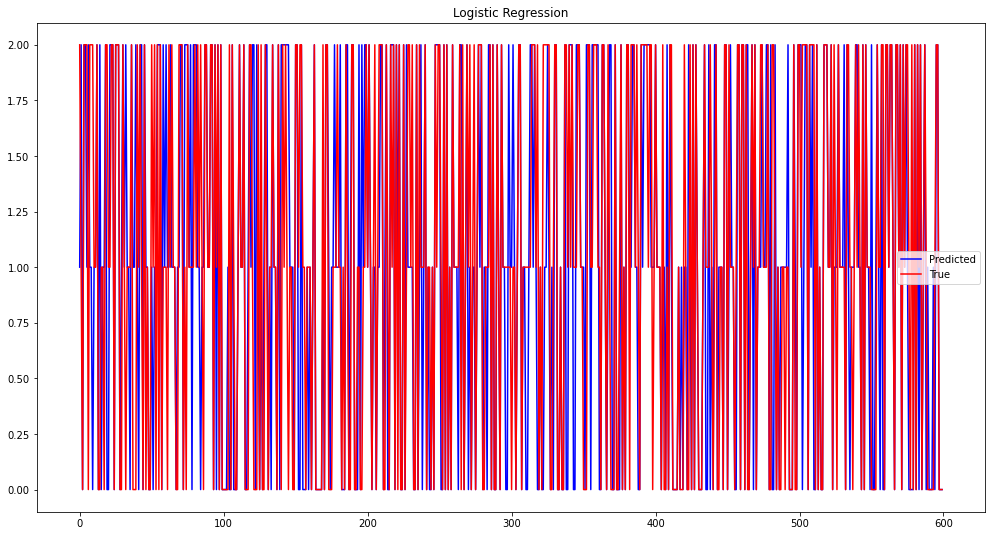

In [ ]:
logistic_regression_on_df(ft_matrix, processed_df.target, 2000, False)

С бустингом как-то тоже не задалось

              precision    recall  f1-score   support

           0       0.66      0.75      0.70       195
           1       0.50      0.47      0.49       192
           2       0.72      0.66      0.69       213

    accuracy                           0.63       600
   macro avg       0.63      0.63      0.63       600
weighted avg       0.63      0.63      0.63       600

    accuracy      0.630


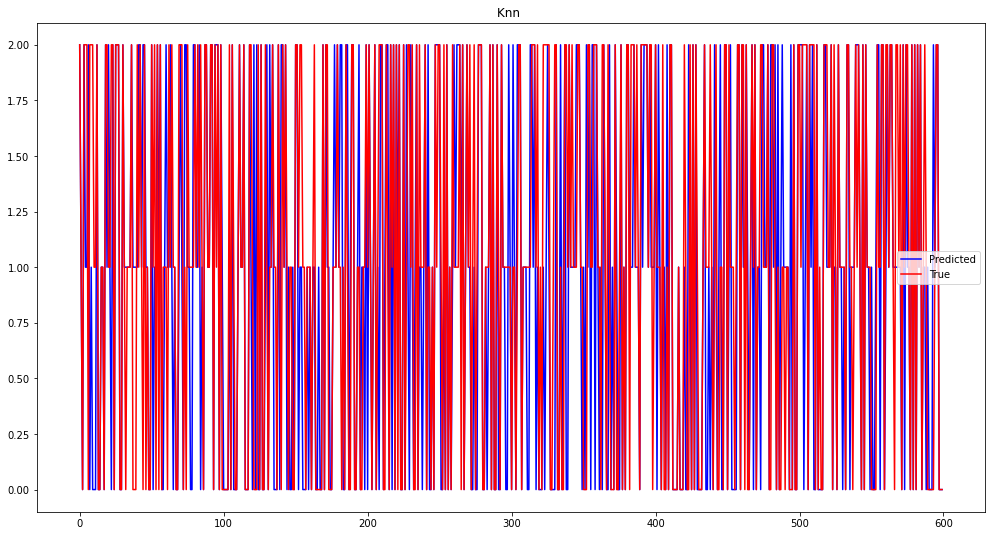

In [ ]:
xgboost(ft_matrix, processed_df.target, 2000, False)

Finished in: 17.954594135284424
{'n_estimators': 100}
              precision    recall  f1-score   support

           0       0.66      0.75      0.70       195
           1       0.50      0.47      0.49       192
           2       0.72      0.66      0.69       213

    accuracy                           0.63       600
   macro avg       0.63      0.63      0.63       600
weighted avg       0.63      0.63      0.63       600

    accuracy      0.630


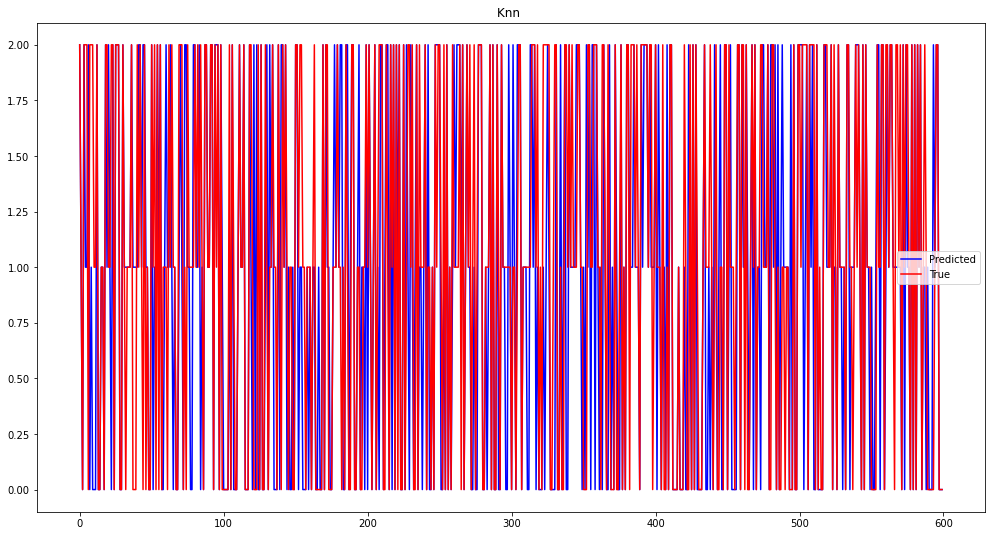

In [ ]:
xgboost(ft_matrix, processed_df.target, 2000, True)

              precision    recall  f1-score   support

           0       0.62      0.64      0.63       195
           1       0.49      0.53      0.51       192
           2       0.74      0.67      0.70       213

    accuracy                           0.61       600
   macro avg       0.62      0.61      0.61       600
weighted avg       0.62      0.61      0.62       600

    accuracy      0.613


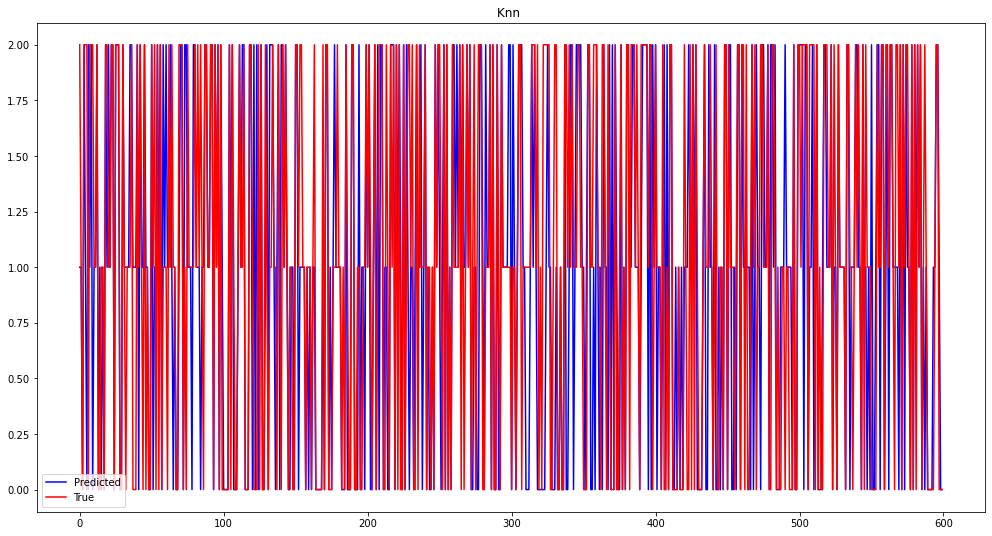

In [ ]:
adaboost(ft_matrix, processed_df.target, 2000, False)

Finished in: 12.064436435699463
{'n_estimators': 100}
              precision    recall  f1-score   support

           0       0.65      0.68      0.67       195
           1       0.51      0.55      0.53       192
           2       0.73      0.65      0.68       213

    accuracy                           0.63       600
   macro avg       0.63      0.63      0.63       600
weighted avg       0.63      0.63      0.63       600

    accuracy      0.627


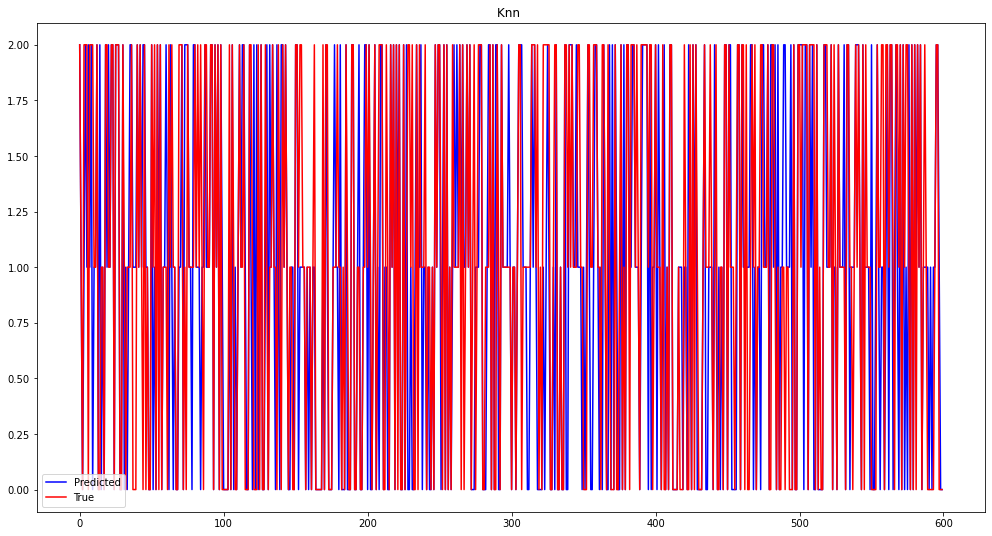

In [ ]:
adaboost(ft_matrix, processed_df.target, 2000, True)

### Ft pretrain

В самый последний момент мы все таки смогли подрубить предобученный фаст текст. И спустя еще бесконечность попыток не упасть по памяти смогли что-то запустить

In [ ]:
ft_pretrained = KeyedVectors.load_word2vec_format('/content/drive/My Drive/data/wiki-news-300d-1M.vec')

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB o

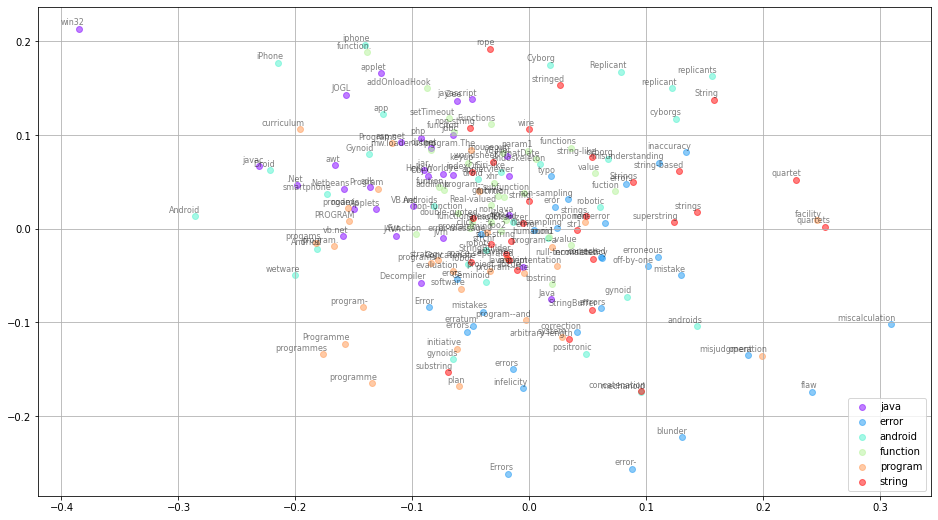

In [ ]:
tsne_plot_similar_words(keys, ft_pretrained)

In [ ]:
ft_pretrain_matrix = get_model_vectors(df_train_embedding.RawText, ft_pretrained)

####Alghorithm test

              precision    recall  f1-score   support

           0       0.58      0.64      0.61       195
           1       0.45      0.53      0.49       192
           2       0.76      0.57      0.65       213

    accuracy                           0.58       600
   macro avg       0.60      0.58      0.58       600
weighted avg       0.60      0.58      0.59       600

    accuracy      0.582


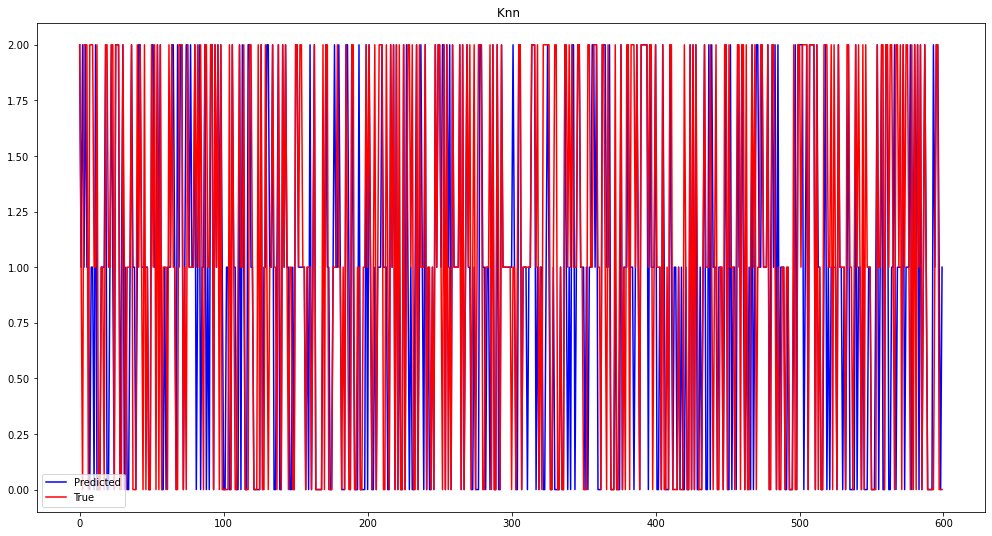

In [ ]:
knn_on_df(ft_pretrain_matrix, processed_df.target, 2000, False)

Fitting 5 folds for each of 24 candidates, totalling 120 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    7.6s
[Parallel(n_jobs=10)]: Done 120 out of 120 | elapsed:   19.3s finished


Finished in: 19.969948768615723
{'metric': 'manhattan', 'n_neighbors': 20, 'weights': 'uniform'}
              precision    recall  f1-score   support

           0       0.64      0.64      0.64       195
           1       0.48      0.61      0.54       192
           2       0.77      0.59      0.67       213

    accuracy                           0.61       600
   macro avg       0.63      0.61      0.62       600
weighted avg       0.64      0.61      0.62       600

    accuracy      0.612


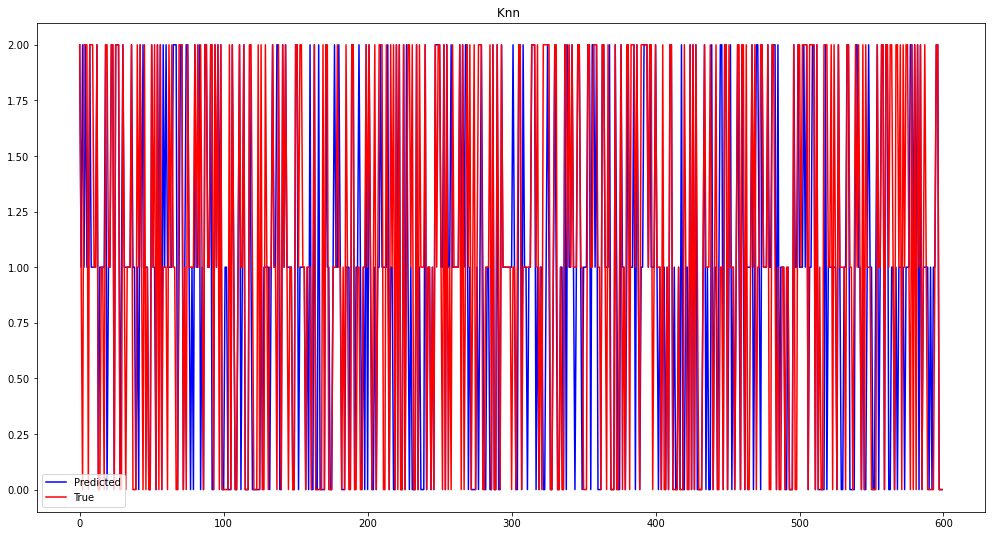

In [ ]:
knn_on_df(ft_pretrain_matrix, processed_df.target, 2000, True)

Fitting 5 folds for each of 5 candidates, totalling 25 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:    0.3s finished


Finished in: 0.8571281433105469
{'alpha': 10.0}
              precision    recall  f1-score   support

           0       0.63      0.75      0.69       195
           1       0.54      0.47      0.50       192
           2       0.72      0.69      0.70       213

    accuracy                           0.64       600
   macro avg       0.63      0.63      0.63       600
weighted avg       0.63      0.64      0.63       600

    accuracy      0.637


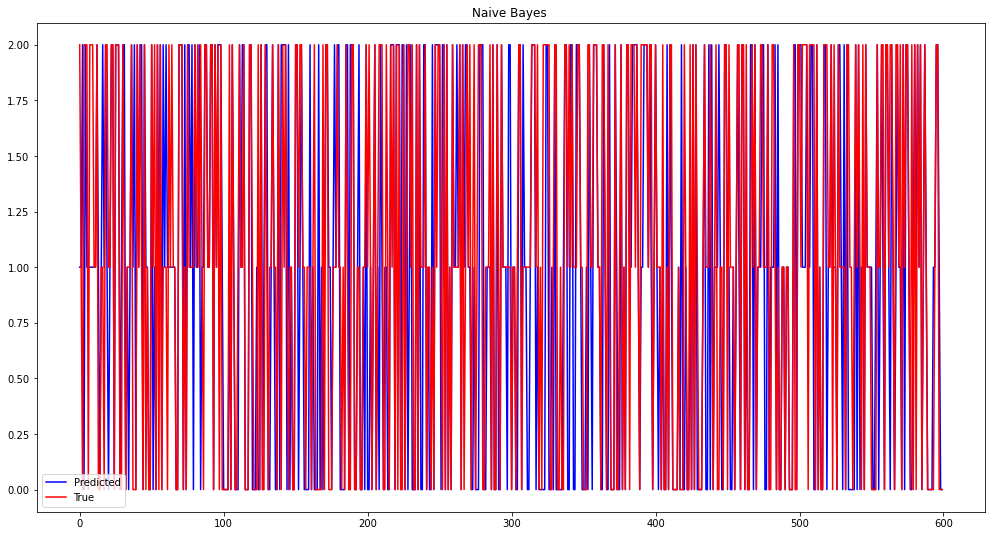

In [ ]:
naive_bayes_on_df(ft_pretrain_matrix, processed_df.target, 2000)

              precision    recall  f1-score   support

           0       0.63      0.75      0.69       195
           1       0.54      0.47      0.50       192
           2       0.72      0.69      0.70       213

    accuracy                           0.64       600
   macro avg       0.63      0.63      0.63       600
weighted avg       0.63      0.64      0.63       600

    accuracy      0.637


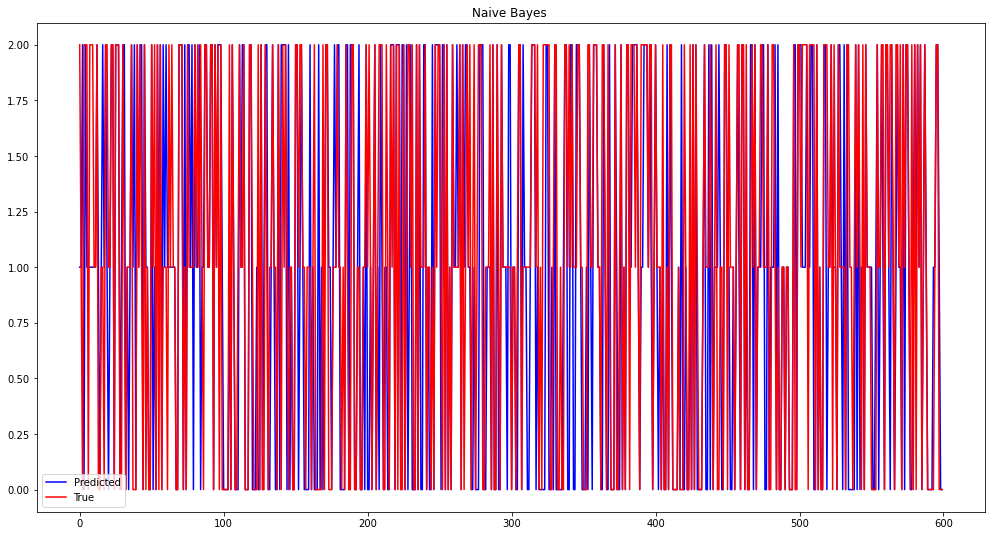

In [ ]:
naive_bayes_on_df(ft_pretrain_matrix, processed_df.target, 2000, False)

Не, ну деревья совсем какие-то деревянные, хе-хе

{'criterion': 'gini', 'max_features': 'sqrt'}
              precision    recall  f1-score   support

           0       0.45      0.48      0.47       195
           1       0.42      0.36      0.39       192
           2       0.52      0.55      0.54       213

    accuracy                           0.47       600
   macro avg       0.46      0.47      0.46       600
weighted avg       0.47      0.47      0.47       600

    accuracy      0.468


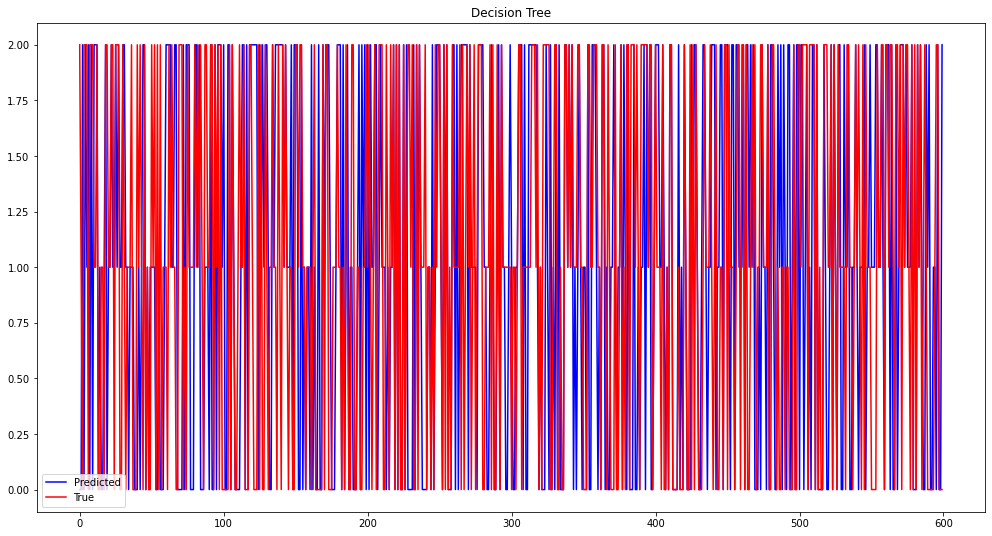

In [ ]:
decision_tree_on_df(ft_pretrain_matrix, processed_df.target, 2000)

              precision    recall  f1-score   support

           0       0.46      0.44      0.45       195
           1       0.40      0.43      0.41       192
           2       0.59      0.57      0.58       213

    accuracy                           0.48       600
   macro avg       0.48      0.48      0.48       600
weighted avg       0.48      0.48      0.48       600

    accuracy      0.482


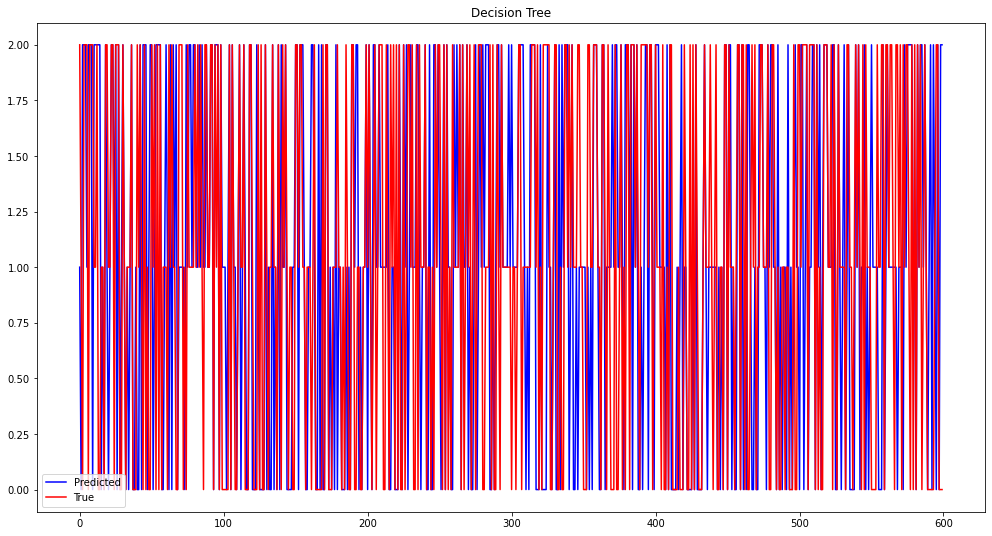

In [ ]:
decision_tree_on_df(ft_pretrain_matrix, processed_df.target, 2000, False)

Fitting 5 folds for each of 8 candidates, totalling 40 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  21 tasks      | elapsed:   22.1s
[Parallel(n_jobs=10)]: Done  40 out of  40 | elapsed:   38.7s finished


Finished in: 44.38154339790344
{'bootstrap': False, 'criterion': 'entropy', 'max_leaf_nodes': None}


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    5.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    0.0s finished


              precision    recall  f1-score   support

           0       0.66      0.72      0.69       195
           1       0.56      0.57      0.56       192
           2       0.73      0.66      0.70       213

    accuracy                           0.65       600
   macro avg       0.65      0.65      0.65       600
weighted avg       0.65      0.65      0.65       600

    accuracy      0.652


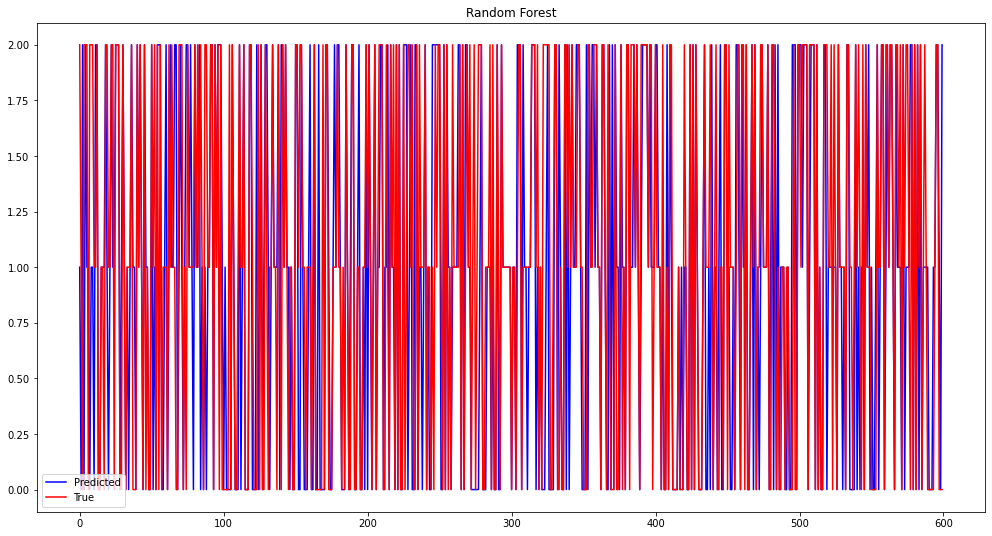

In [ ]:
random_forest_on_df(ft_pretrain_matrix, processed_df.target, 2000)

              precision    recall  f1-score   support

           0       0.67      0.74      0.70      4820
           1       0.60      0.59      0.60      4835
           2       0.73      0.68      0.71      4745

    accuracy                           0.67     14400
   macro avg       0.67      0.67      0.67     14400
weighted avg       0.67      0.67      0.67     14400

    accuracy      0.668


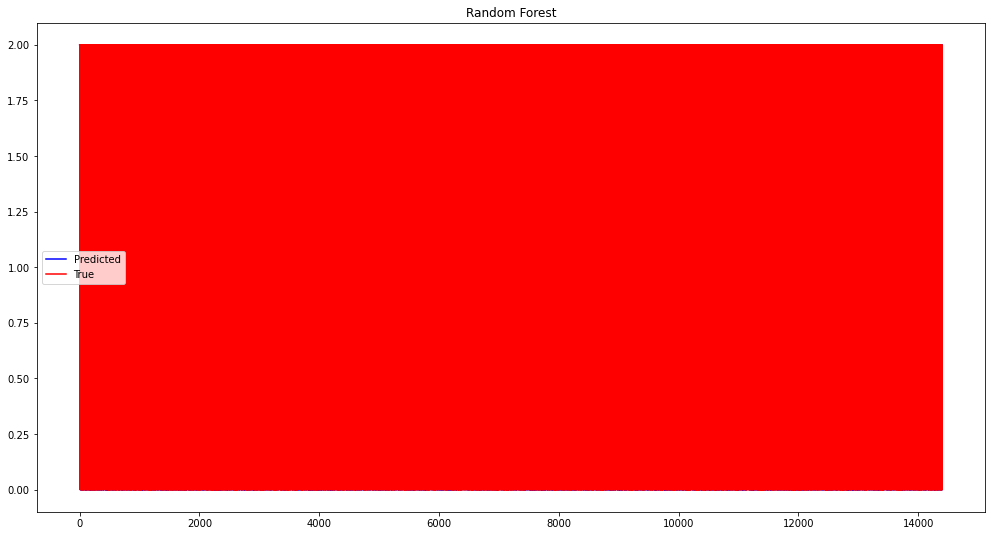

In [ ]:
random_forest_on_df(ft_pretrain_matrix, processed_df.target, 48000, False)

Логистическая регрессия пока что снова вин

Finished in: 159.68731331825256
{'C': 10.0, 'penalty': 'l2'}
              precision    recall  f1-score   support

           0       0.74      0.76      0.75      4820
           1       0.63      0.68      0.65      4835
           2       0.78      0.70      0.74      4745

    accuracy                           0.71     14400
   macro avg       0.72      0.71      0.71     14400
weighted avg       0.71      0.71      0.71     14400

    accuracy      0.710


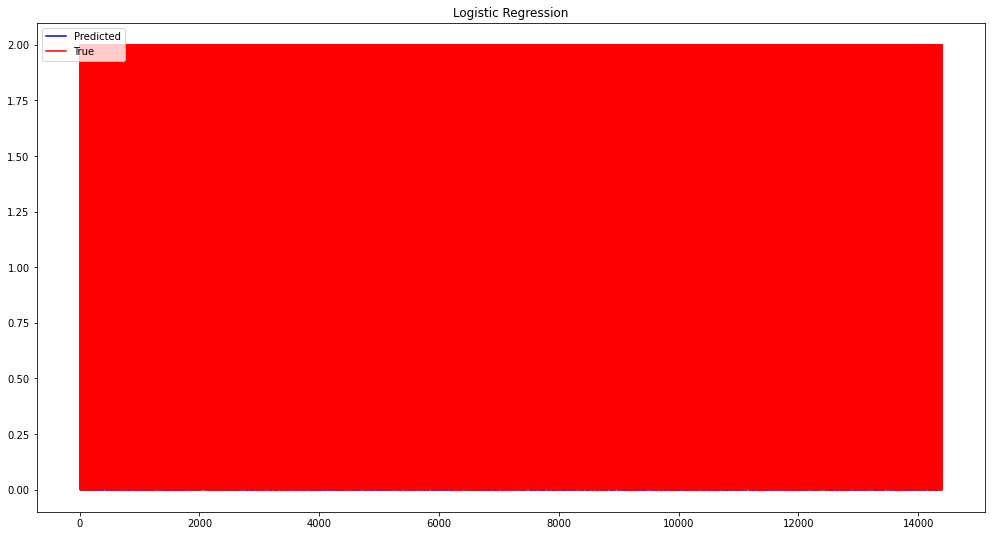

In [ ]:
logistic_regression_on_df(ft_pretrain_matrix, processed_df.target, 48000)

              precision    recall  f1-score   support

           0       0.64      0.68      0.66       195
           1       0.53      0.49      0.51       192
           2       0.67      0.67      0.67       213

    accuracy                           0.62       600
   macro avg       0.61      0.62      0.61       600
weighted avg       0.62      0.62      0.62       600

    accuracy      0.618


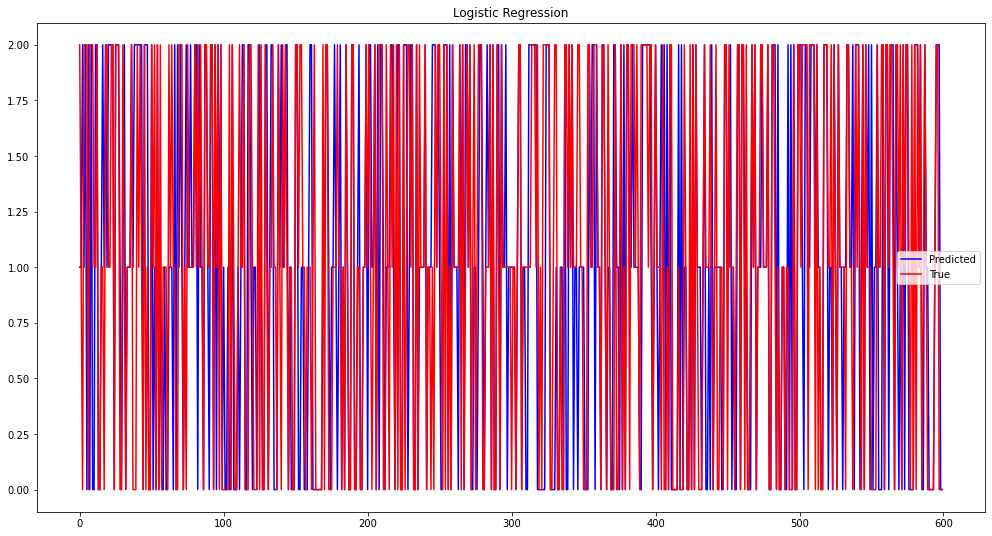

In [ ]:
logistic_regression_on_df(ft_pretrain_matrix, processed_df.target, 2000, False)

              precision    recall  f1-score   support

           0       0.65      0.68      0.67       195
           1       0.53      0.56      0.54       192
           2       0.75      0.68      0.71       213

    accuracy                           0.64       600
   macro avg       0.64      0.64      0.64       600
weighted avg       0.65      0.64      0.64       600

    accuracy      0.642


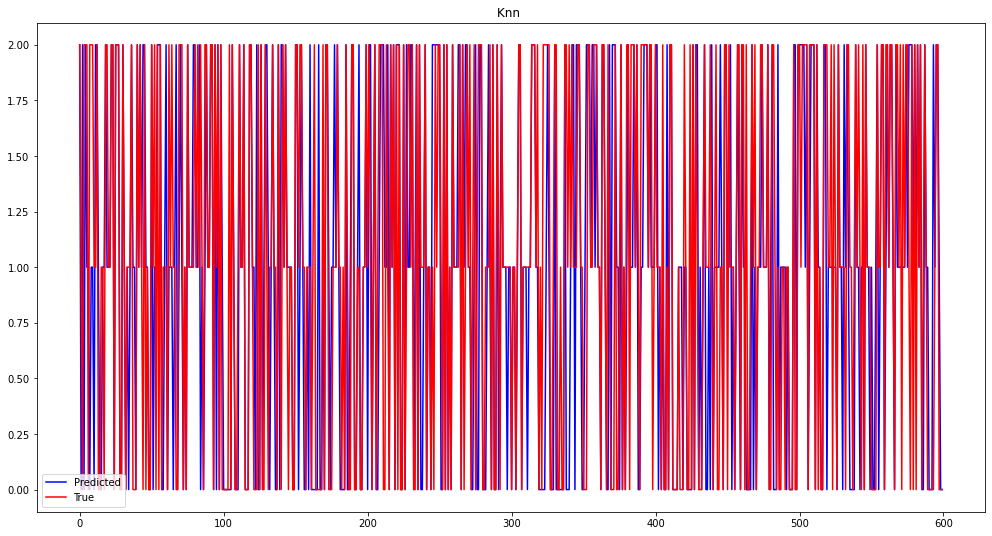

In [ ]:
xgboost(ft_pretrain_matrix, processed_df.target, 2000, False)

Finished in: 52.389673948287964
{'n_estimators': 100}
              precision    recall  f1-score   support

           0       0.65      0.68      0.67       195
           1       0.53      0.56      0.54       192
           2       0.75      0.68      0.71       213

    accuracy                           0.64       600
   macro avg       0.64      0.64      0.64       600
weighted avg       0.65      0.64      0.64       600

    accuracy      0.642


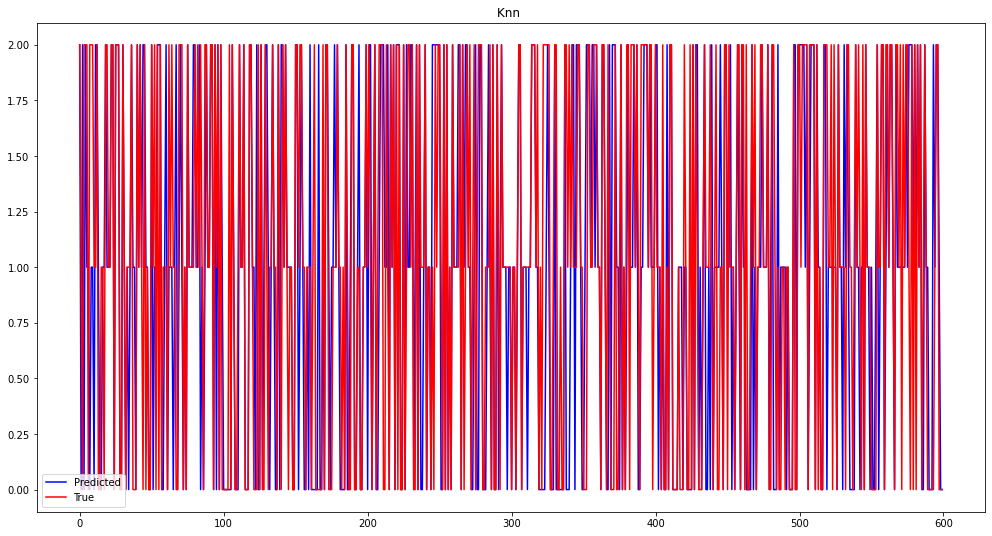

In [ ]:
xgboost(ft_pretrain_matrix, processed_df.target, 2000, True)

              precision    recall  f1-score   support

           0       0.65      0.69      0.67      4820
           1       0.56      0.55      0.55      4835
           2       0.70      0.67      0.68      4745

    accuracy                           0.63     14400
   macro avg       0.63      0.63      0.63     14400
weighted avg       0.63      0.63      0.63     14400

    accuracy      0.634


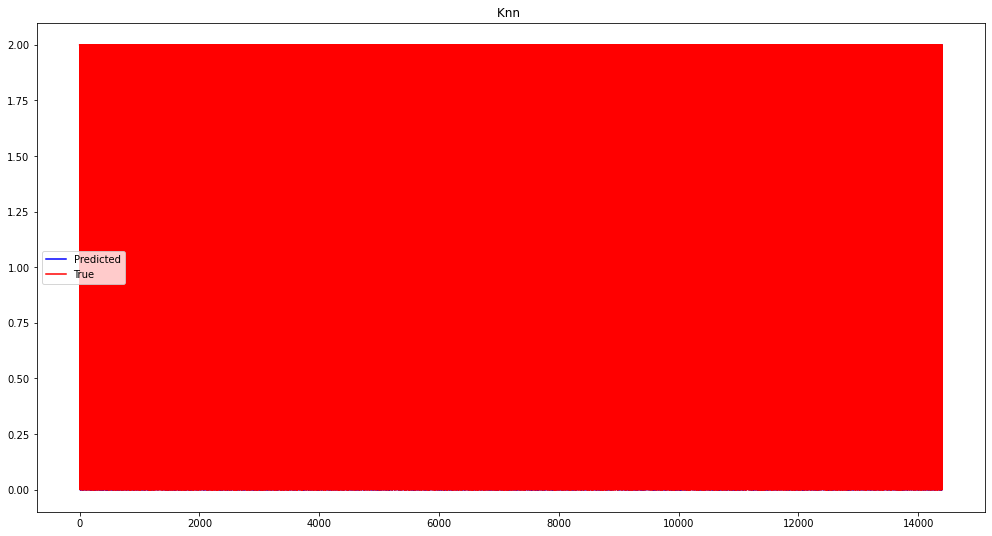

In [ ]:
adaboost(ft_pretrain_matrix, processed_df.target, 48000, False)

Finished in: 33.15392875671387
{'n_estimators': 100}
              precision    recall  f1-score   support

           0       0.68      0.62      0.65       195
           1       0.49      0.62      0.55       192
           2       0.72      0.60      0.65       213

    accuracy                           0.61       600
   macro avg       0.63      0.61      0.61       600
weighted avg       0.63      0.61      0.62       600

    accuracy      0.612


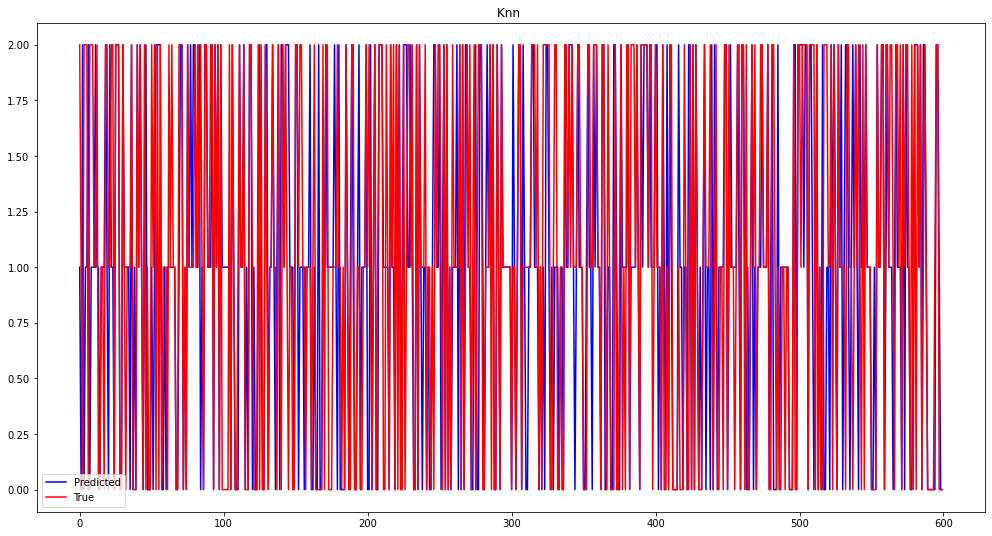

In [ ]:
adaboost(ft_pretrain_matrix, processed_df.target, 2000, True)

### Word2Vec

####Generation and/or model load

Голая модель word2vec. Попробуем обучить ее на своей скромной выборке

In [ ]:
W2V_FILE = "/content/drive/MyDrive/data/w2v_trained_2000.model"

In [ ]:
w2v = Word2Vec(df_train_embedding.Text, min_count = 1, size = 1000, workers = 3, window = 3, sg = 1)
w2v.save(W2V_FILE)

In [ ]:
w2v = Word2Vec.load(W2V_FILE)

####Visualization

In [ ]:
w2v.most_similar('java')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning: Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.
  if np.issubdtype(vec.dtype, np.int):


[('akun', 0.9916293621063232),
 ('react', 0.9915151000022888),
 ('orchestrator', 0.9914239048957825),
 ('abysmal', 0.9913201332092285),
 ('resource', 0.9908803701400757),
 ('linting', 0.9906982183456421),
 ('discuss', 0.9902827143669128),
 ('login', 0.9900734424591064),
 ('progressive', 0.9897968769073486),
 ('interchangeably', 0.9896388053894043)]

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  import sys
/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning: Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.
  if np.issubdtype(vec.dtype, np.int):
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  if __name__ == '__main__':
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value 

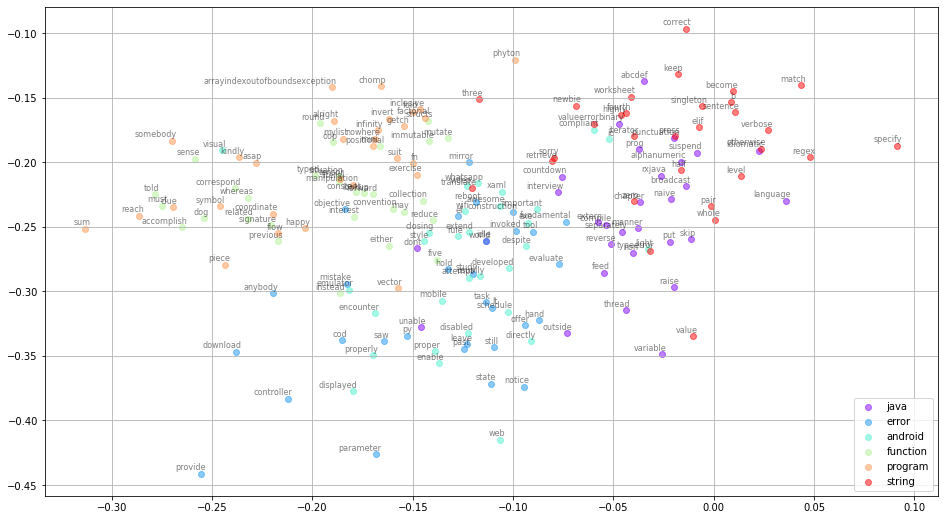

In [ ]:
tsne_plot_similar_words(keys, w2v)

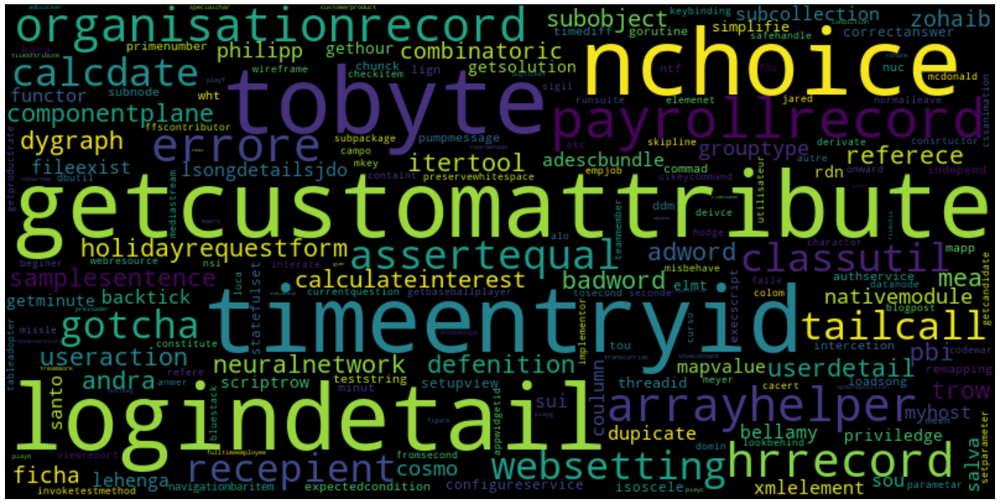

In [ ]:
show_word_cloud(w2v.wv.vocab)

На такой график уже явно интереснее смотреть. Можем выделить 4-5 кластеров

In [ ]:
bokeh_representation(w2v, w2v.wv.vocab, "Word2Vec", 2000)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  import sys


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2000 samples in 0.236s...
[t-SNE] Computed neighbors for 2000 samples in 7.669s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2000
[t-SNE] Computed conditional probabilities for sample 2000 / 2000
[t-SNE] Mean sigma: 0.226582
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.798157
[t-SNE] KL divergence after 1000 iterations: 0.942406


####Vectorization

In [ ]:
w2v_matrix = get_model_vectors(df_train_embedding.RawText, w2v)

####Alghorithm test

              precision    recall  f1-score   support

           0       0.53      0.78      0.64       195
           1       0.46      0.43      0.45       192
           2       0.78      0.49      0.60       213

    accuracy                           0.57       600
   macro avg       0.59      0.57      0.56       600
weighted avg       0.60      0.57      0.56       600

    accuracy      0.567


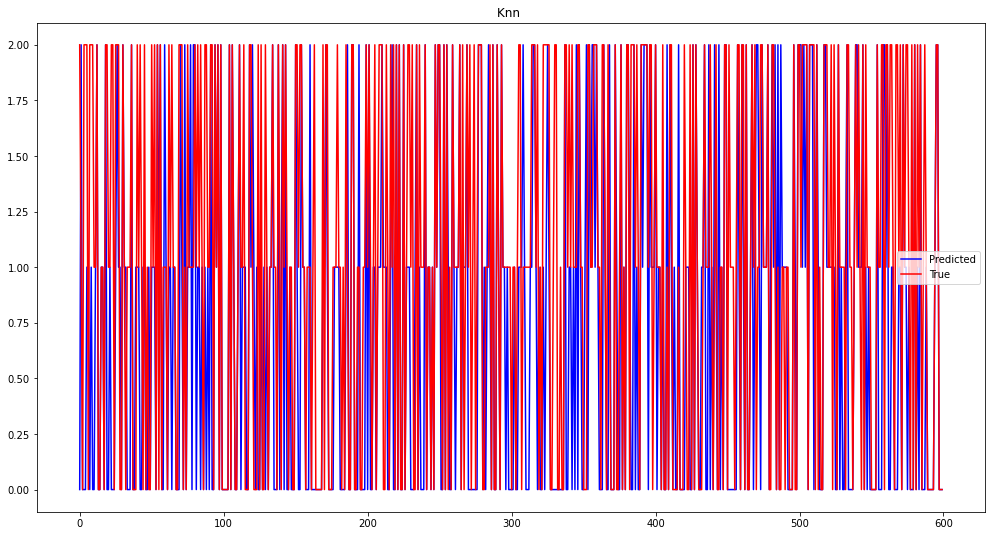

In [ ]:
knn_on_df(w2v_matrix, processed_df.target, 2000, False)

Fitting 5 folds for each of 24 candidates, totalling 120 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   11.3s
[Parallel(n_jobs=10)]: Done 120 out of 120 | elapsed:   42.3s finished


Finished in: 42.45169687271118
{'metric': 'manhattan', 'n_neighbors': 20, 'weights': 'distance'}
              precision    recall  f1-score   support

           0       0.60      0.75      0.67       195
           1       0.52      0.56      0.54       192
           2       0.81      0.58      0.67       213

    accuracy                           0.63       600
   macro avg       0.64      0.63      0.63       600
weighted avg       0.65      0.63      0.63       600

    accuracy      0.627


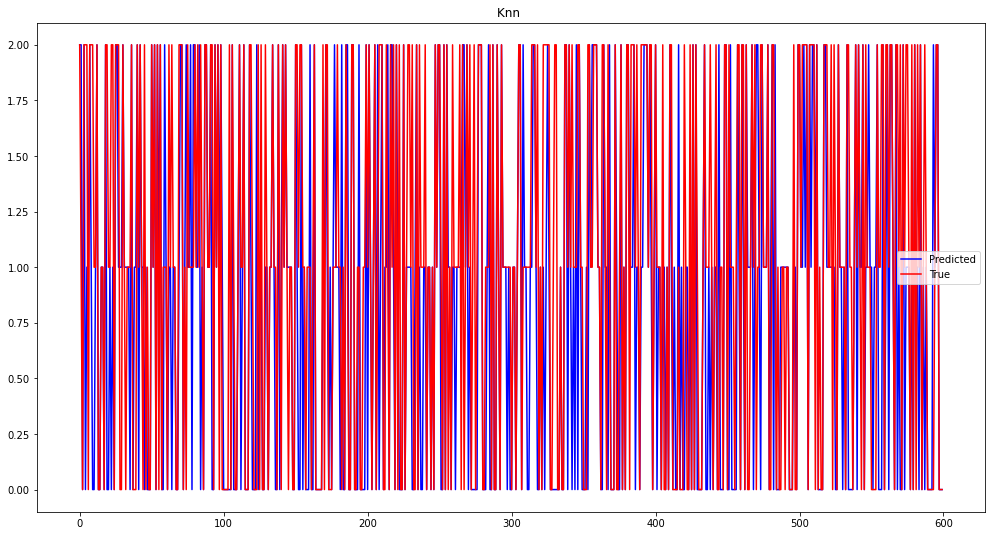

In [ ]:
knn_on_df(w2v_matrix, processed_df.target, 2000, True)

Fitting 5 folds for each of 5 candidates, totalling 25 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:    0.7s finished


Finished in: 1.4046025276184082
{'alpha': 0.01}
              precision    recall  f1-score   support

           0       0.64      0.77      0.70       195
           1       0.56      0.42      0.48       192
           2       0.70      0.72      0.71       213

    accuracy                           0.64       600
   macro avg       0.63      0.64      0.63       600
weighted avg       0.63      0.64      0.63       600

    accuracy      0.640


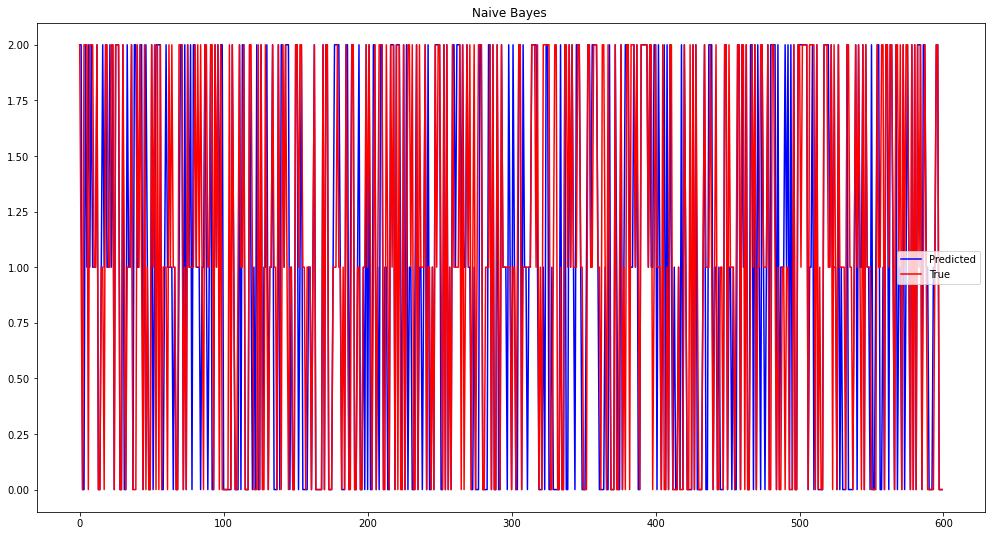

In [ ]:
naive_bayes_on_df(w2v_matrix, processed_df.target, 2000)

              precision    recall  f1-score   support

           0       0.64      0.77      0.70       195
           1       0.56      0.42      0.48       192
           2       0.70      0.72      0.71       213

    accuracy                           0.64       600
   macro avg       0.63      0.64      0.63       600
weighted avg       0.63      0.64      0.63       600

    accuracy      0.640


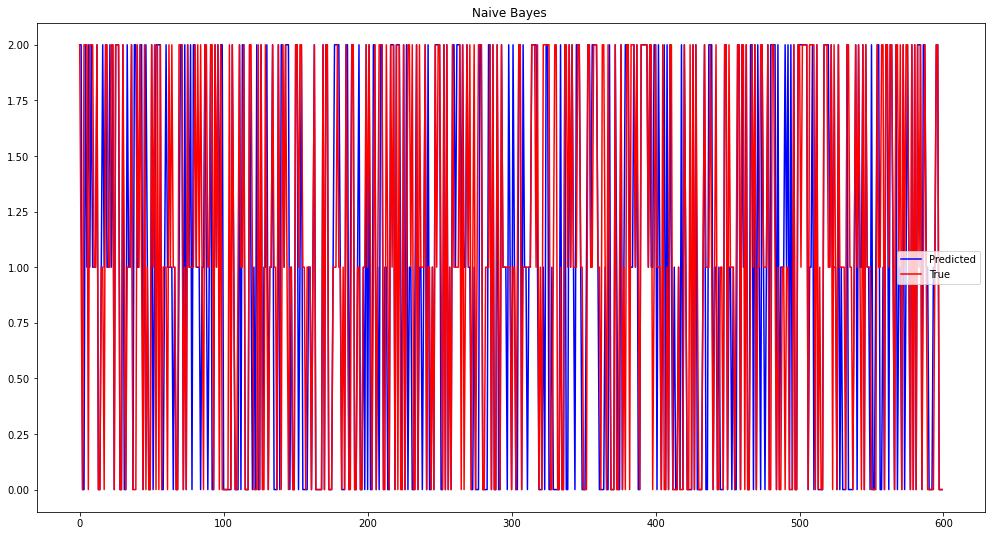

In [ ]:
naive_bayes_on_df(w2v_matrix, processed_df.target, 2000, False)

{'criterion': 'entropy', 'max_features': 'auto'}
              precision    recall  f1-score   support

           0       0.60      0.60      0.60       195
           1       0.43      0.44      0.43       192
           2       0.59      0.57      0.58       213

    accuracy                           0.54       600
   macro avg       0.54      0.54      0.54       600
weighted avg       0.54      0.54      0.54       600

    accuracy      0.540


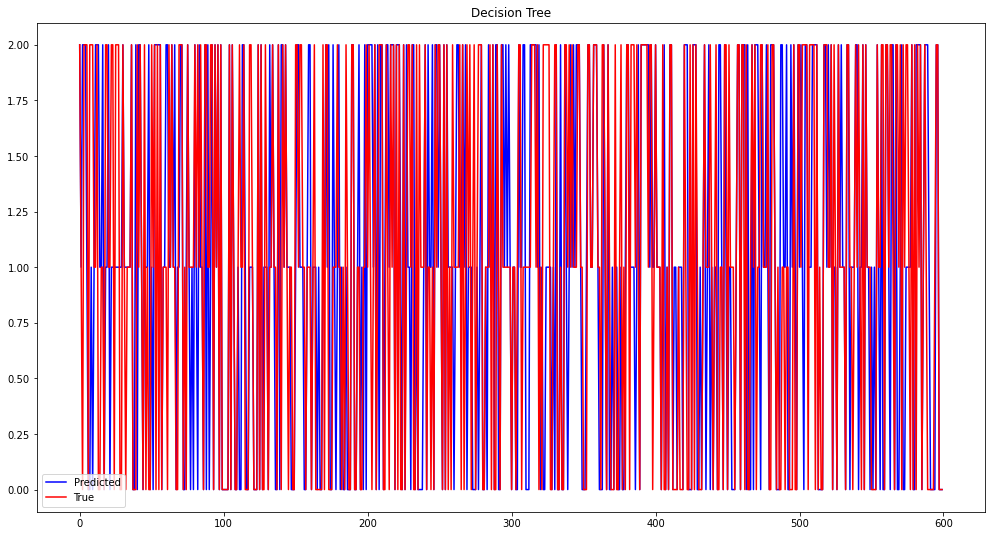

In [ ]:
decision_tree_on_df(w2v_matrix, processed_df.target, 2000)

              precision    recall  f1-score   support

           0       0.63      0.61      0.62       195
           1       0.45      0.46      0.45       192
           2       0.60      0.60      0.60       213

    accuracy                           0.56       600
   macro avg       0.56      0.56      0.56       600
weighted avg       0.56      0.56      0.56       600

    accuracy      0.558


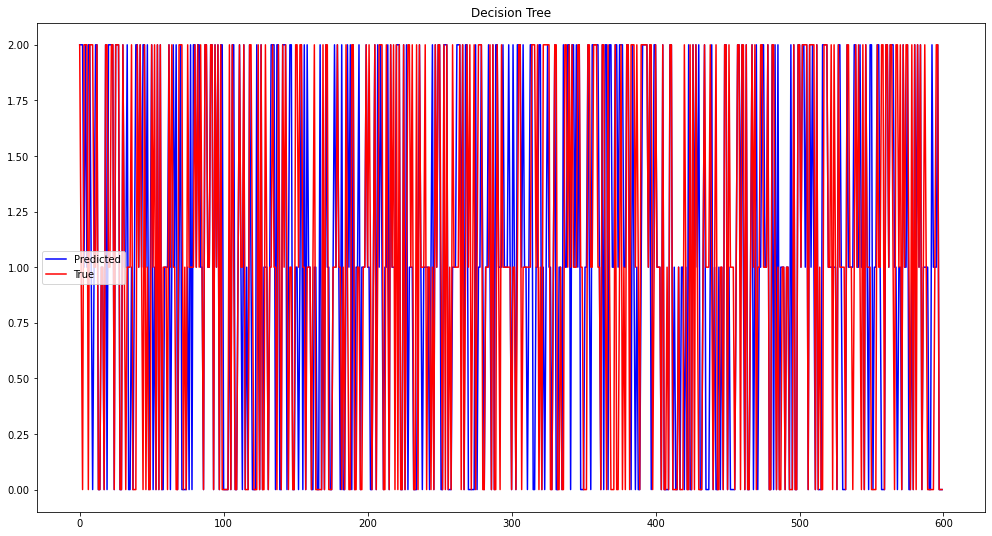

In [ ]:
decision_tree_on_df(w2v_matrix, processed_df.target, 2000, False)

Fitting 5 folds for each of 8 candidates, totalling 40 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  21 tasks      | elapsed:   34.1s
[Parallel(n_jobs=10)]: Done  40 out of  40 | elapsed:  1.0min finished


Finished in: 68.69911670684814
{'bootstrap': True, 'criterion': 'entropy', 'max_leaf_nodes': None}


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    5.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    0.0s finished


              precision    recall  f1-score   support

           0       0.70      0.75      0.72       195
           1       0.54      0.57      0.55       192
           2       0.79      0.70      0.75       213

    accuracy                           0.68       600
   macro avg       0.68      0.67      0.67       600
weighted avg       0.68      0.68      0.68       600

    accuracy      0.675


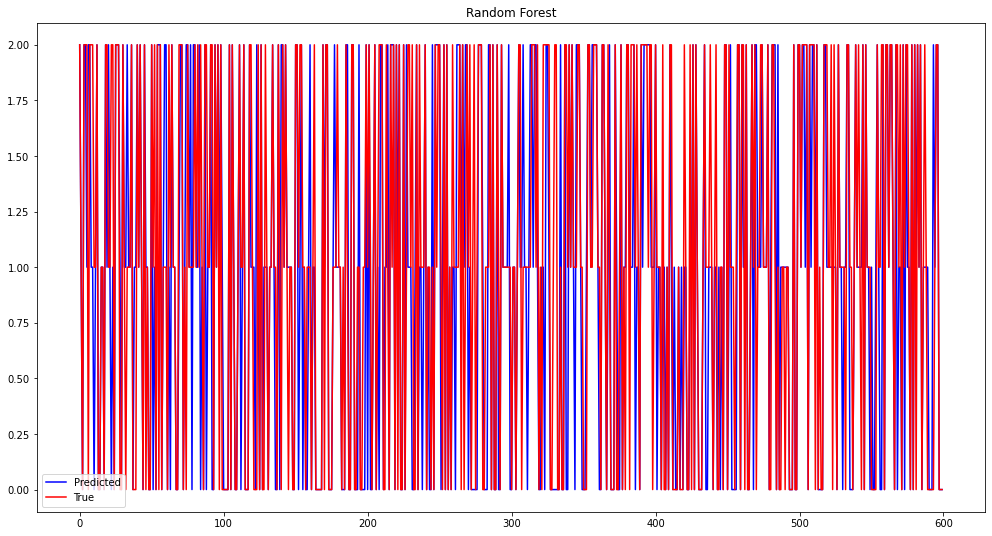

In [ ]:
random_forest_on_df(w2v_matrix, processed_df.target, 2000)

              precision    recall  f1-score   support

           0       0.73      0.79      0.76       195
           1       0.60      0.61      0.61       192
           2       0.80      0.72      0.76       213

    accuracy                           0.71       600
   macro avg       0.71      0.71      0.71       600
weighted avg       0.71      0.71      0.71       600

    accuracy      0.710


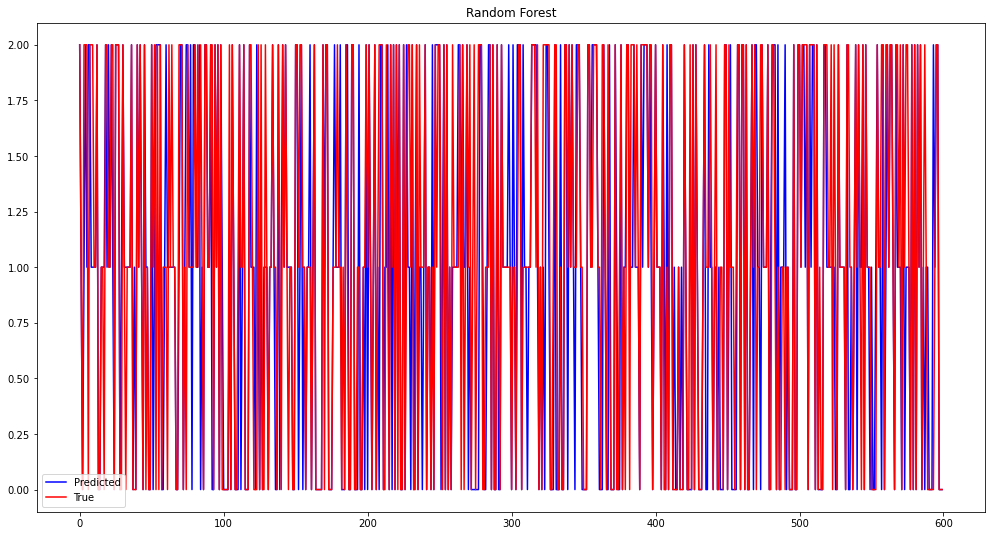

In [ ]:
random_forest_on_df(w2v_matrix, processed_df.target, 2000, False)

Finished in: 526.20543217659
{'C': 0.001, 'penalty': 'l2'}
              precision    recall  f1-score   support

           0       0.75      0.77      0.76      4820
           1       0.63      0.64      0.64      4835
           2       0.75      0.72      0.73      4745

    accuracy                           0.71     14400
   macro avg       0.71      0.71      0.71     14400
weighted avg       0.71      0.71      0.71     14400

    accuracy      0.708


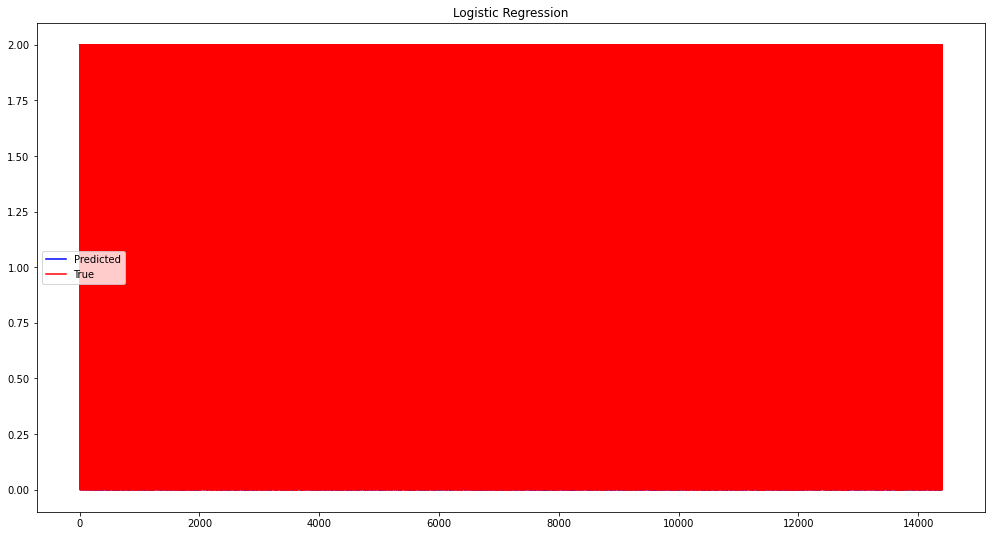

In [ ]:
logistic_regression_on_df(w2v_matrix, processed_df.target, 48000)

              precision    recall  f1-score   support

           0       0.74      0.77      0.75      4820
           1       0.63      0.65      0.64      4835
           2       0.75      0.70      0.73      4745

    accuracy                           0.71     14400
   macro avg       0.71      0.71      0.71     14400
weighted avg       0.71      0.71      0.71     14400

    accuracy      0.705


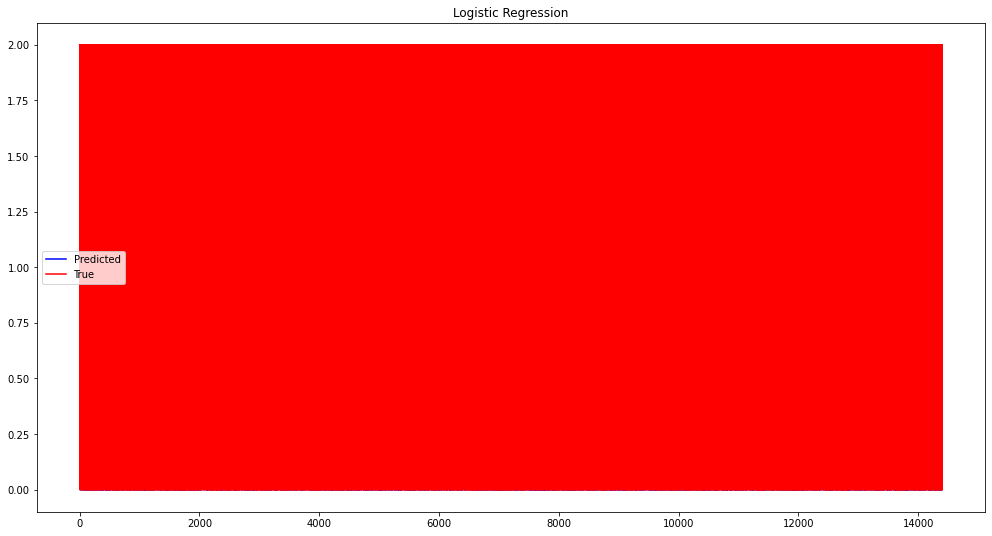

In [ ]:
logistic_regression_on_df(w2v_matrix, processed_df.target, 48000, False)

              precision    recall  f1-score   support

           0       0.73      0.77      0.75      4820
           1       0.62      0.66      0.64      4835
           2       0.79      0.69      0.74      4745

    accuracy                           0.71     14400
   macro avg       0.71      0.71      0.71     14400
weighted avg       0.71      0.71      0.71     14400

    accuracy      0.707


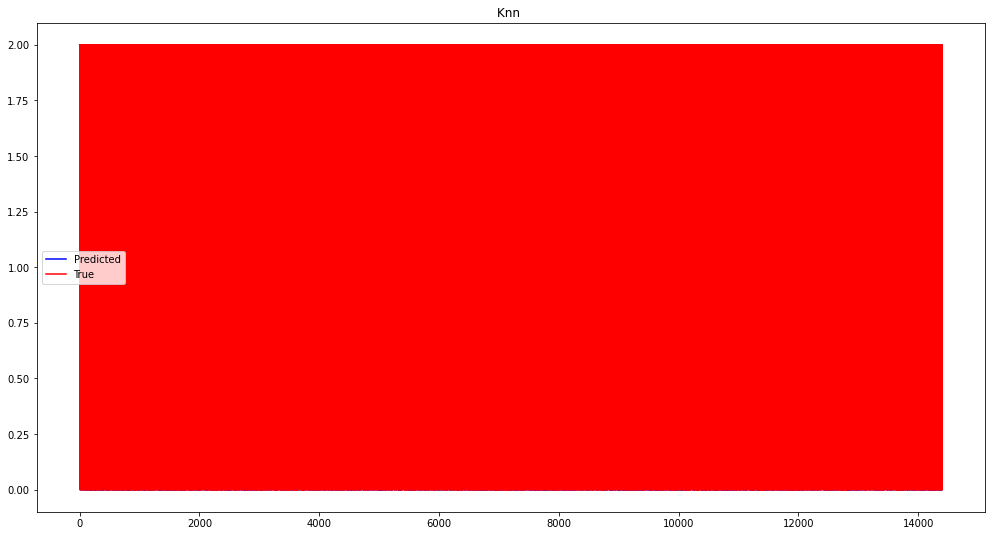

In [ ]:
xgboost(w2v_matrix, processed_df.target, 48000, False)

Finished in: 158.1867322921753
{'n_estimators': 50}
              precision    recall  f1-score   support

           0       0.71      0.76      0.74       195
           1       0.59      0.59      0.59       192
           2       0.78      0.72      0.75       213

    accuracy                           0.69       600
   macro avg       0.69      0.69      0.69       600
weighted avg       0.70      0.69      0.70       600

    accuracy      0.695


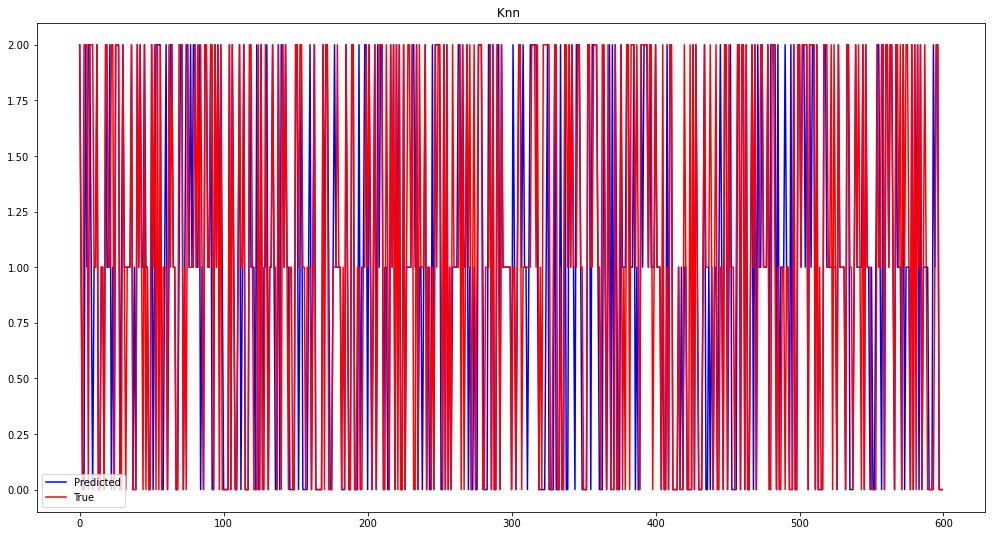

In [ ]:
xgboost(w2v_matrix, processed_df.target, 2000, True)

              precision    recall  f1-score   support

           0       0.70      0.72      0.71       195
           1       0.50      0.51      0.50       192
           2       0.71      0.69      0.70       213

    accuracy                           0.64       600
   macro avg       0.64      0.64      0.64       600
weighted avg       0.64      0.64      0.64       600

    accuracy      0.640


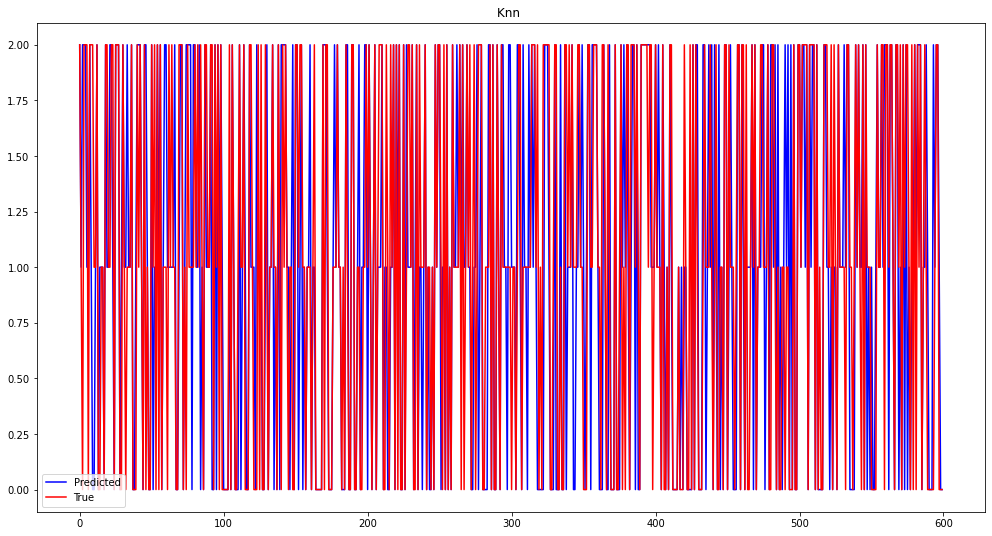

In [ ]:
adaboost(w2v_matrix, processed_df.target, 2000, False)

Finished in: 100.56082439422607
{'n_estimators': 50}
              precision    recall  f1-score   support

           0       0.70      0.72      0.71       195
           1       0.50      0.51      0.50       192
           2       0.71      0.69      0.70       213

    accuracy                           0.64       600
   macro avg       0.64      0.64      0.64       600
weighted avg       0.64      0.64      0.64       600

    accuracy      0.640


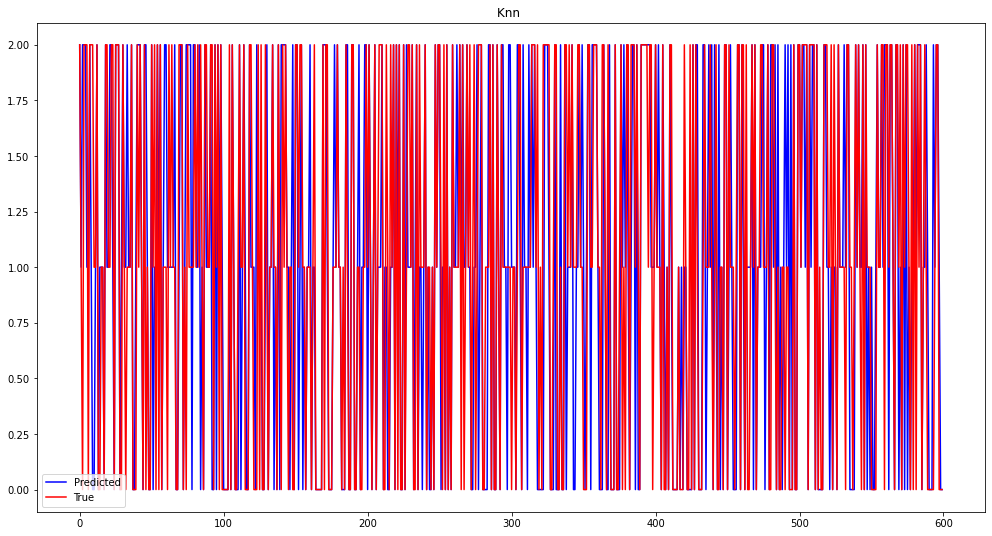

In [ ]:
adaboost(w2v_matrix, processed_df.target, 2000, True)

Можно заключить, что голам модель w2v показала себя идентично голой модели фаст текста. Довольно плохо. Метрики грустные

###W2V pretrain

Это было очень больно, но мы смогли. Смогли запустить предобученную модель w2v. На самом деле, w2v был самым проблемным эмбедингом (если one hot не считать)

In [ ]:
w2v_pretrained = KeyedVectors.load_word2vec_format('/content/drive/My Drive/data/GoogleNews-vectors-negative300.bin.gz', binary=True)

In [ ]:
tsne_plot_similar_words(keys, w2v_pretrained)

In [ ]:
w2v_pretrained_matrix = get_model_vectors(df_train_embedding.RawText, w2v_pretrained)

####Alghorithm test

              precision    recall  f1-score   support

           0       0.55      0.63      0.59       195
           1       0.43      0.47      0.45       192
           2       0.73      0.56      0.63       213

    accuracy                           0.56       600
   macro avg       0.57      0.55      0.56       600
weighted avg       0.57      0.56      0.56       600

    accuracy      0.555


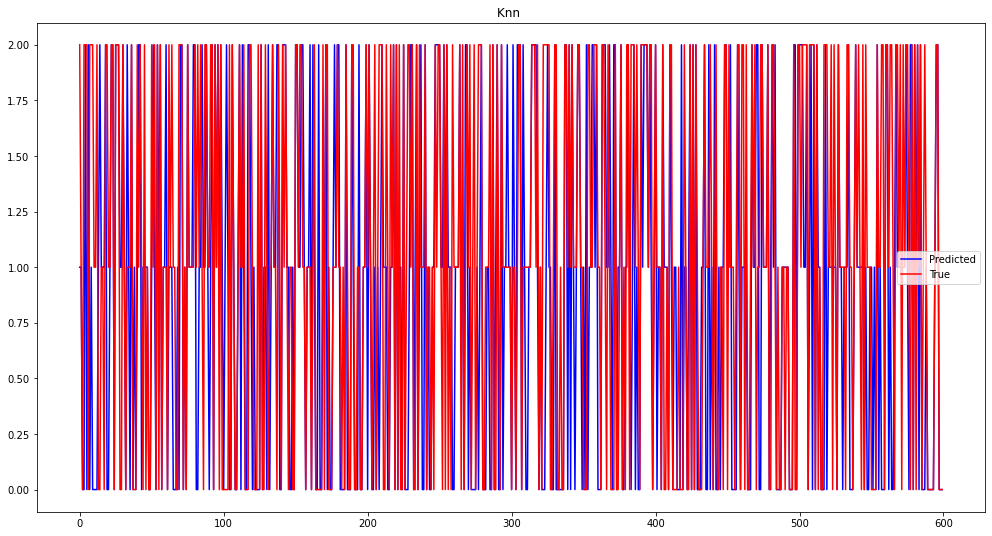

In [ ]:
knn_on_df(w2v_pretrained_matrix, processed_df.target, 2000, False)

Fitting 5 folds for each of 24 candidates, totalling 120 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   11.8s
[Parallel(n_jobs=10)]: Done 120 out of 120 | elapsed:   24.8s finished


Finished in: 24.902461290359497
{'metric': 'manhattan', 'n_neighbors': 20, 'weights': 'uniform'}
              precision    recall  f1-score   support

           0       0.60      0.58      0.59       195
           1       0.47      0.59      0.52       192
           2       0.73      0.57      0.64       213

    accuracy                           0.58       600
   macro avg       0.60      0.58      0.58       600
weighted avg       0.60      0.58      0.59       600

    accuracy      0.582


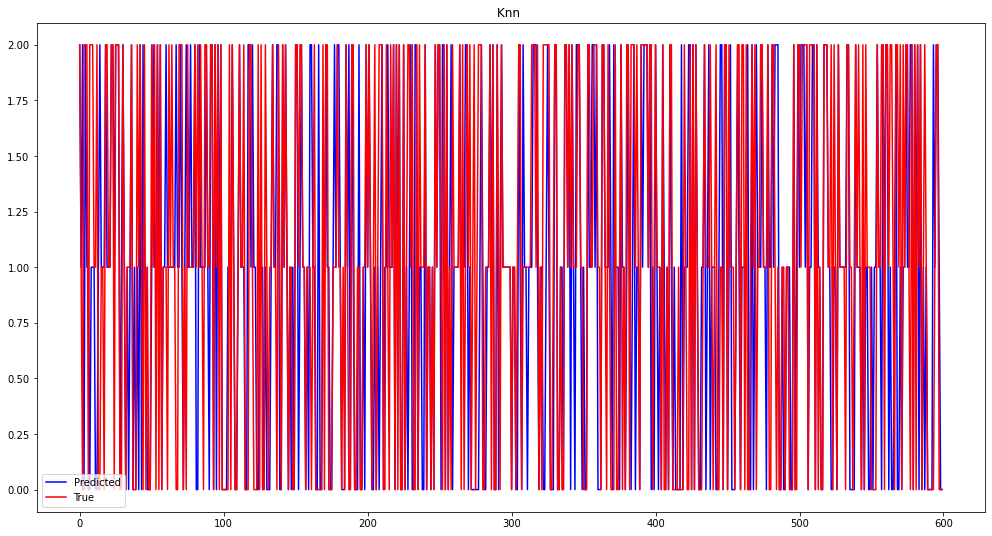

In [ ]:
knn_on_df(w2v_pretrained_matrix, processed_df.target, 2000, True)

Fitting 5 folds for each of 5 candidates, totalling 25 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:    0.3s finished


Finished in: 0.9563107490539551
{'alpha': 10.0}
              precision    recall  f1-score   support

           0       0.62      0.63      0.63       195
           1       0.51      0.46      0.49       192
           2       0.66      0.71      0.68       213

    accuracy                           0.60       600
   macro avg       0.60      0.60      0.60       600
weighted avg       0.60      0.60      0.60       600

    accuracy      0.605


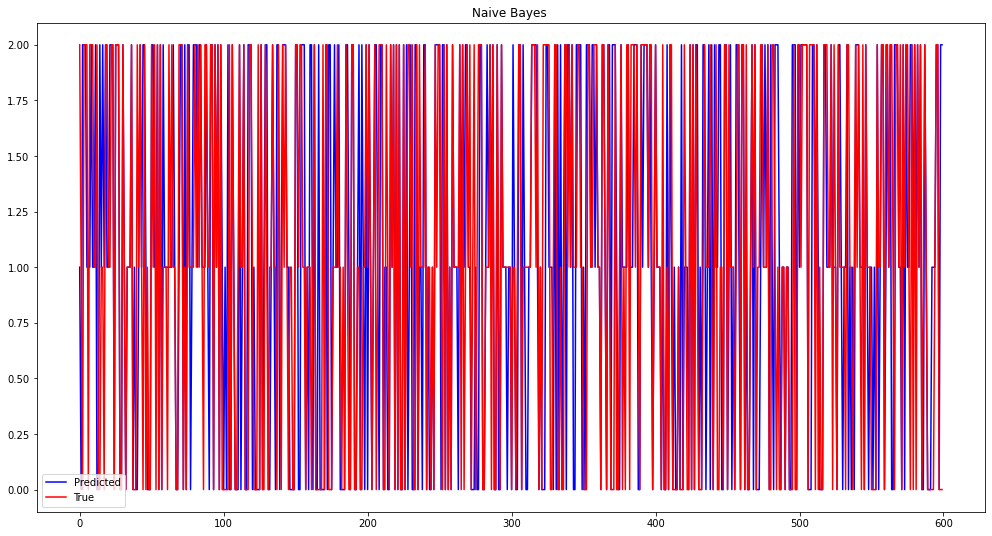

In [ ]:
naive_bayes_on_df(w2v_pretrained_matrix, processed_df.target, 2000)

              precision    recall  f1-score   support

           0       0.62      0.63      0.63       195
           1       0.51      0.46      0.49       192
           2       0.66      0.71      0.68       213

    accuracy                           0.60       600
   macro avg       0.60      0.60      0.60       600
weighted avg       0.60      0.60      0.60       600

    accuracy      0.605


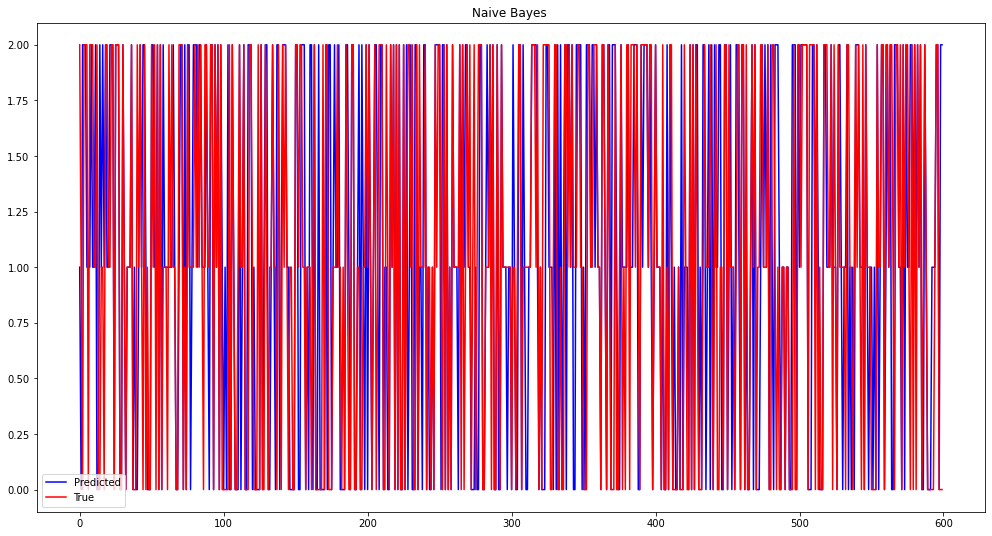

In [ ]:
naive_bayes_on_df(w2v_pretrained_matrix, processed_df.target, 2000, False)

{'criterion': 'gini', 'max_features': 'auto'}
              precision    recall  f1-score   support

           0       0.49      0.47      0.48       195
           1       0.42      0.44      0.43       192
           2       0.51      0.50      0.51       213

    accuracy                           0.47       600
   macro avg       0.47      0.47      0.47       600
weighted avg       0.47      0.47      0.47       600

    accuracy      0.472


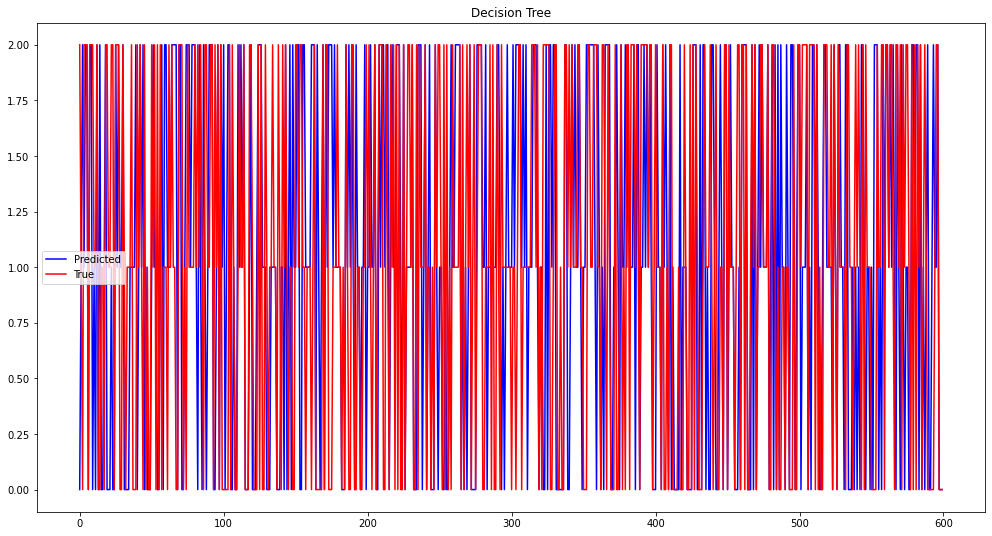

In [ ]:
decision_tree_on_df(w2v_pretrained_matrix, processed_df.target, 2000)

              precision    recall  f1-score   support

           0       0.46      0.51      0.48       195
           1       0.43      0.38      0.40       192
           2       0.56      0.57      0.57       213

    accuracy                           0.49       600
   macro avg       0.48      0.48      0.48       600
weighted avg       0.49      0.49      0.48       600

    accuracy      0.487


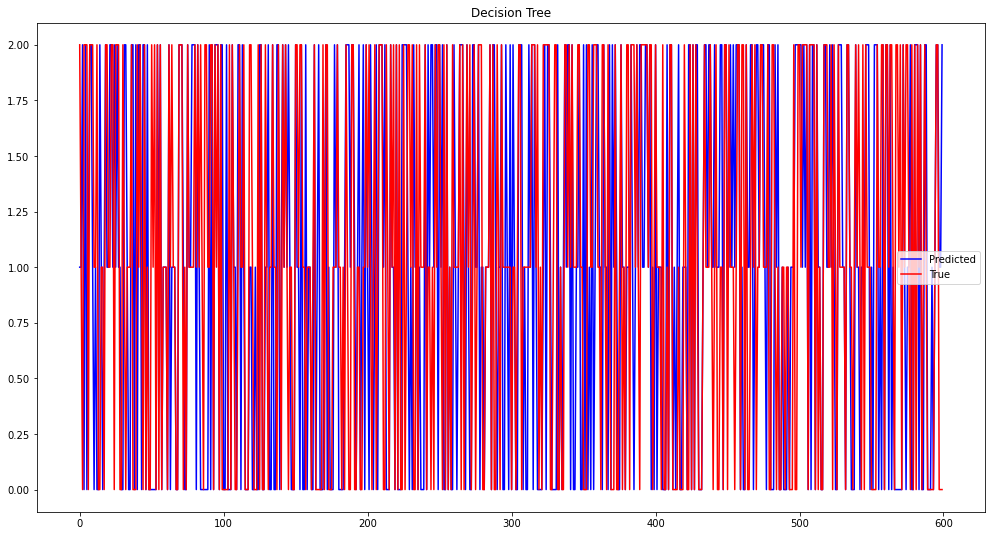

In [ ]:
decision_tree_on_df(w2v_pretrained_matrix, processed_df.target, 2000, False)

Fitting 5 folds for each of 8 candidates, totalling 40 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  21 tasks      | elapsed:   22.0s
[Parallel(n_jobs=10)]: Done  40 out of  40 | elapsed:   38.4s finished


Finished in: 42.49863815307617
{'bootstrap': False, 'criterion': 'gini', 'max_leaf_nodes': None}


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    2.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    0.0s finished


              precision    recall  f1-score   support

           0       0.63      0.66      0.64       195
           1       0.48      0.52      0.50       192
           2       0.68      0.61      0.65       213

    accuracy                           0.60       600
   macro avg       0.60      0.60      0.60       600
weighted avg       0.60      0.60      0.60       600

    accuracy      0.597


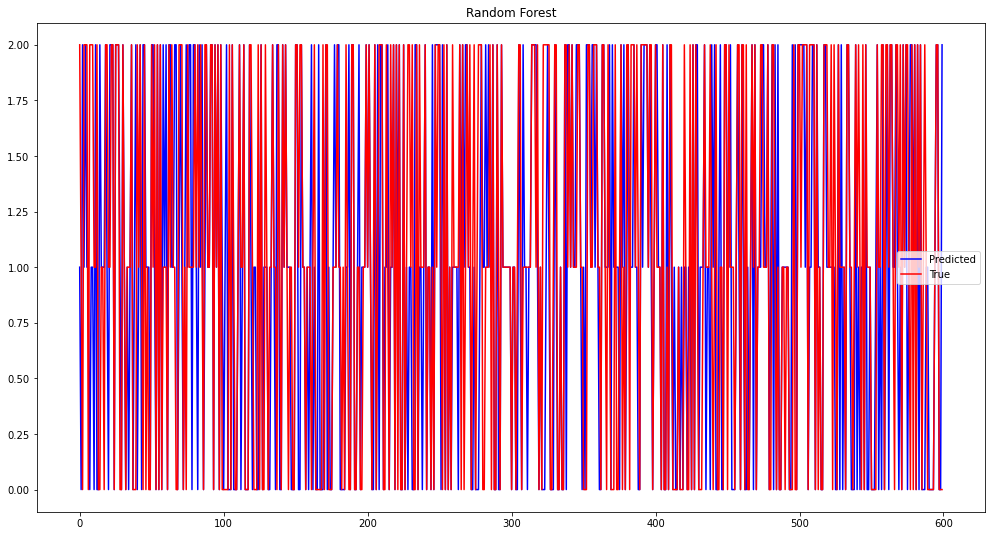

In [ ]:
random_forest_on_df(w2v_pretrained_matrix, processed_df.target, 2000)

              precision    recall  f1-score   support

           0       0.62      0.66      0.64       195
           1       0.51      0.55      0.53       192
           2       0.71      0.62      0.66       213

    accuracy                           0.61       600
   macro avg       0.61      0.61      0.61       600
weighted avg       0.62      0.61      0.61       600

    accuracy      0.608


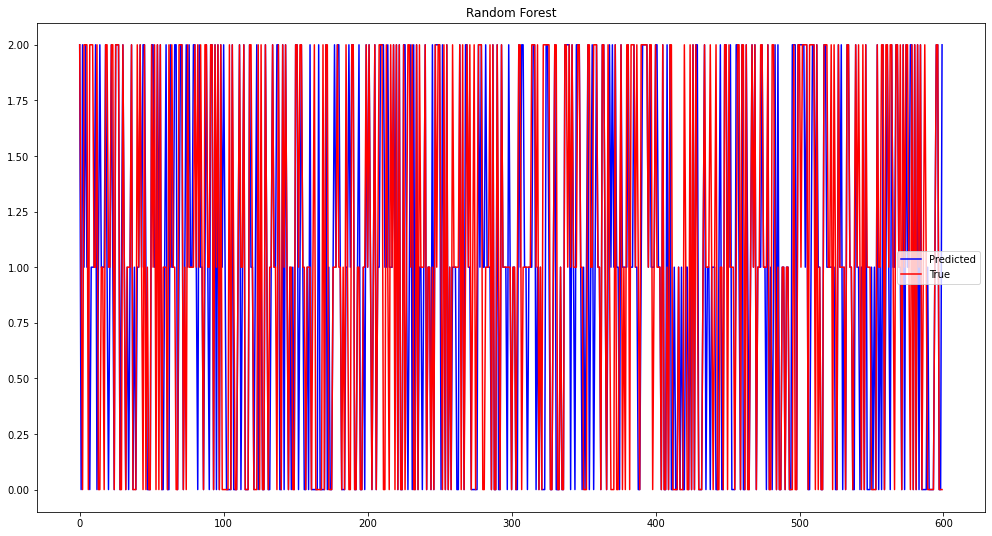

In [ ]:
random_forest_on_df(w2v_pretrained_matrix, processed_df.target, 2000, False)

Finished in: 7.346304416656494
{'C': 0.001, 'penalty': 'l2'}
              precision    recall  f1-score   support

           0       0.68      0.71      0.70       195
           1       0.54      0.59      0.57       192
           2       0.77      0.68      0.72       213

    accuracy                           0.66       600
   macro avg       0.67      0.66      0.66       600
weighted avg       0.67      0.66      0.66       600

    accuracy      0.662


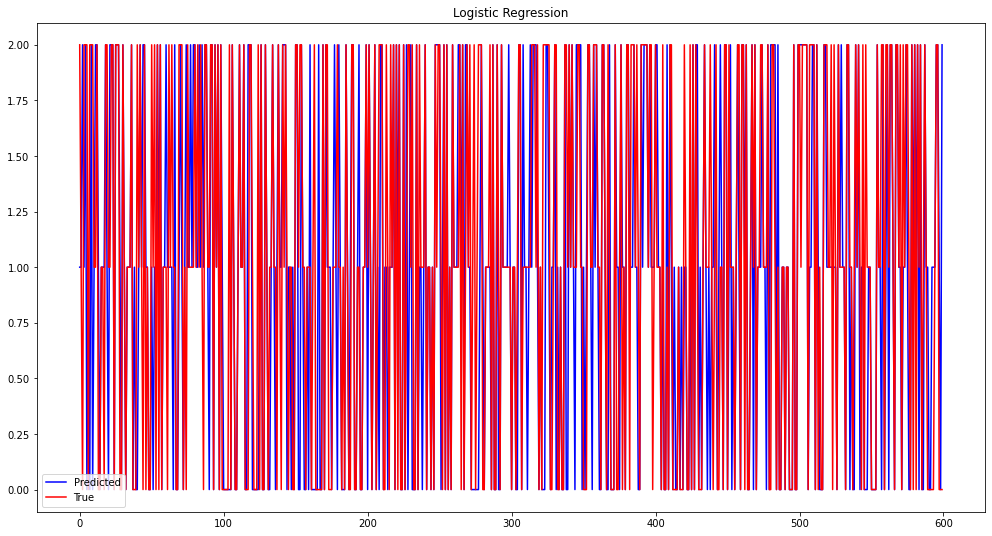

In [ ]:
logistic_regression_on_df(w2v_pretrained_matrix, processed_df.target, 2000)

              precision    recall  f1-score   support

           0       0.68      0.70      0.69       195
           1       0.48      0.47      0.48       192
           2       0.64      0.63      0.63       213

    accuracy                           0.60       600
   macro avg       0.60      0.60      0.60       600
weighted avg       0.60      0.60      0.60       600

    accuracy      0.603


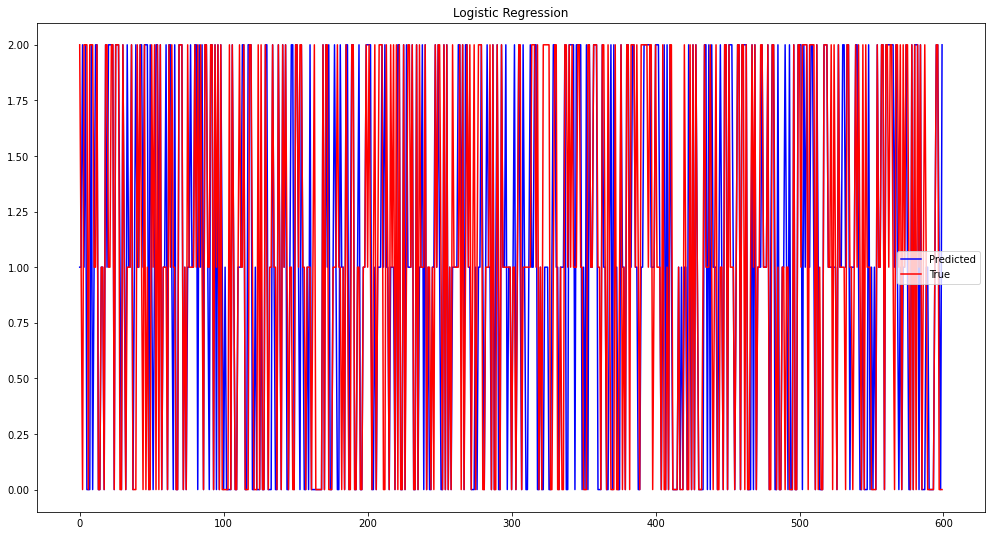

In [ ]:
logistic_regression_on_df(w2v_pretrained_matrix, processed_df.target, 2000, False)

              precision    recall  f1-score   support

           0       0.61      0.61      0.61       195
           1       0.48      0.56      0.52       192
           2       0.75      0.65      0.70       213

    accuracy                           0.61       600
   macro avg       0.62      0.61      0.61       600
weighted avg       0.62      0.61      0.61       600

    accuracy      0.607


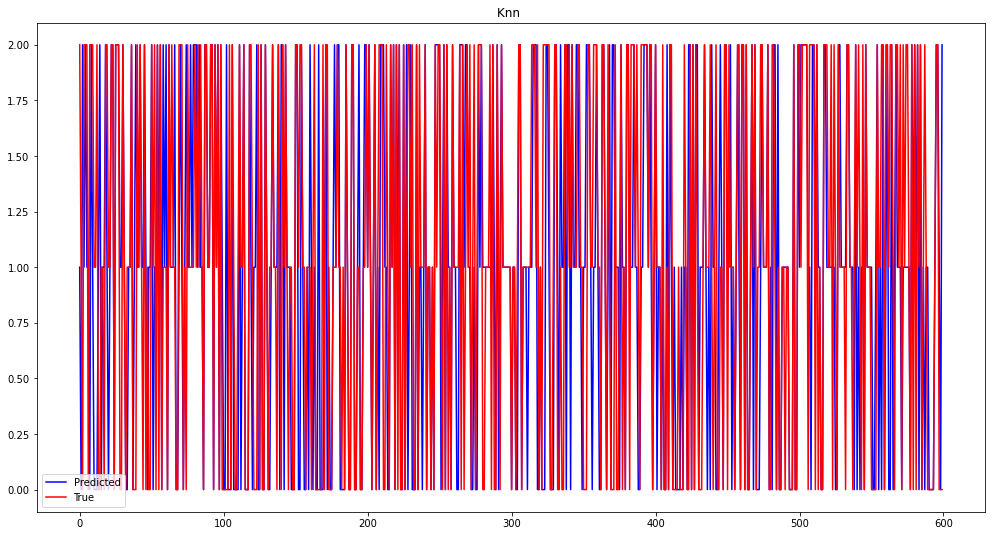

In [ ]:
xgboost(w2v_pretrained_matrix, processed_df.target, 2000, False)

Finished in: 51.236706256866455
{'n_estimators': 100}
              precision    recall  f1-score   support

           0       0.61      0.61      0.61       195
           1       0.48      0.56      0.52       192
           2       0.75      0.65      0.70       213

    accuracy                           0.61       600
   macro avg       0.62      0.61      0.61       600
weighted avg       0.62      0.61      0.61       600

    accuracy      0.607


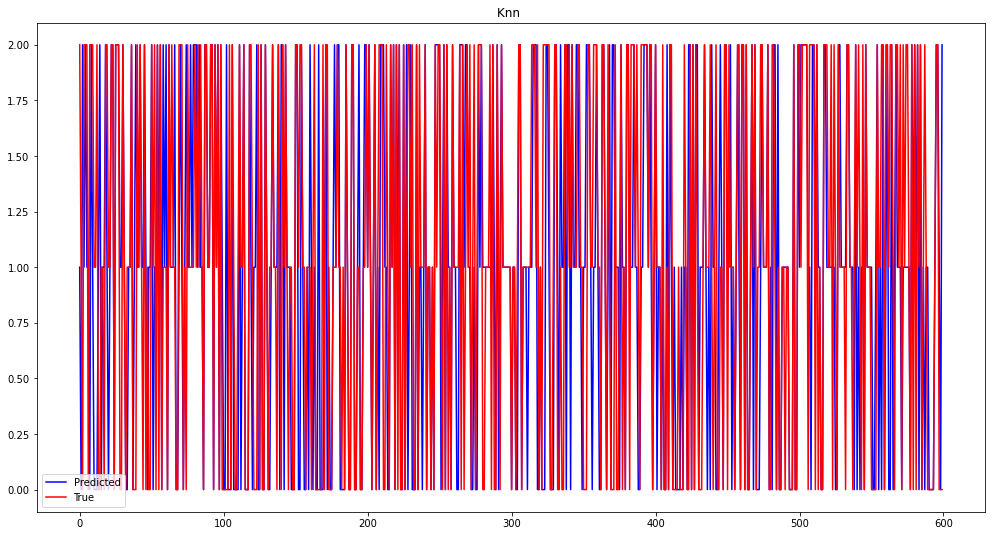

In [ ]:
xgboost(w2v_pretrained_matrix, processed_df.target, 2000, True)

              precision    recall  f1-score   support

           0       0.55      0.56      0.56       195
           1       0.42      0.46      0.44       192
           2       0.63      0.57      0.60       213

    accuracy                           0.53       600
   macro avg       0.54      0.53      0.53       600
weighted avg       0.54      0.53      0.53       600

    accuracy      0.532


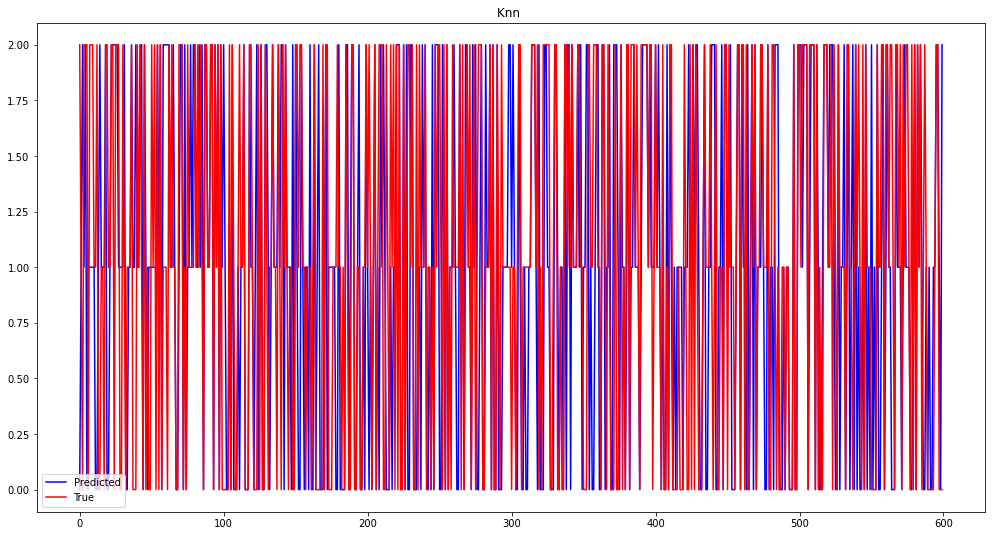

In [ ]:
adaboost(w2v_pretrained_matrix, processed_df.target, 2000, False)

Finished in: 30.975982904434204
{'n_estimators': 50}
              precision    recall  f1-score   support

           0       0.55      0.56      0.56       195
           1       0.42      0.46      0.44       192
           2       0.63      0.57      0.60       213

    accuracy                           0.53       600
   macro avg       0.54      0.53      0.53       600
weighted avg       0.54      0.53      0.53       600

    accuracy      0.532


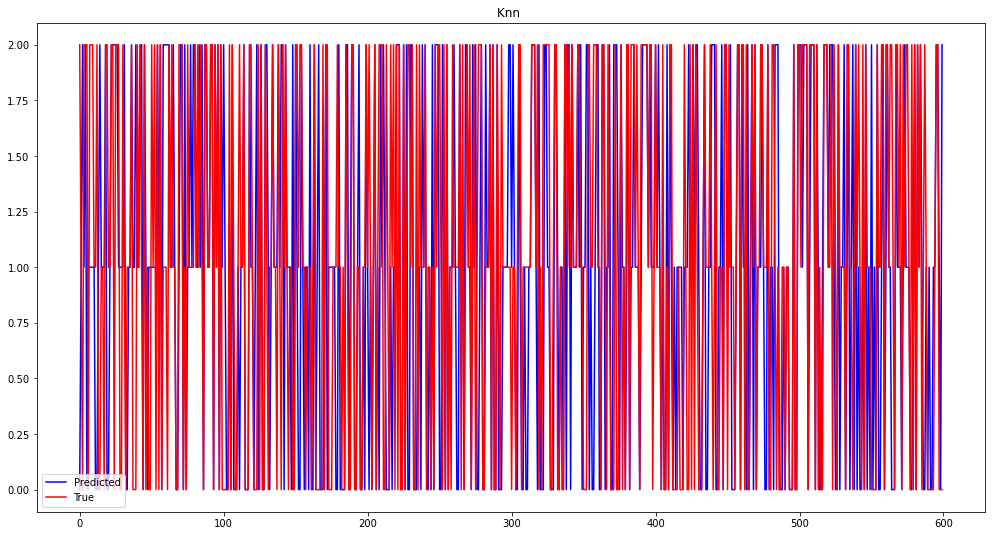

In [ ]:
adaboost(w2v_pretrained_matrix, processed_df.target, 2000, True)

Тут что-то даже регрессия не смогла перевалить за 70. Не вижу смысла что-то тут обсуждать. Цифры очень похожие, где-то лучше, где-то хуже

### TF IDF

Пожалуй самый простой эмббидинг в этой лабе. Заработал с первого раза

####Generation of matrix and vocab

In [ ]:
tfidf = TfidfVectorizer(min_df=5)
tfidf_matrix = tfidf.fit_transform(df_train_embedding.Text.apply(lambda s: " ".join(s)))
tfidf_vocabular = dict(zip(tfidf.get_feature_names(), tfidf.idf_))
print ('Vocabular size :', len(tfidf_vocabular))

Vocabular size : 10363


####Visualization

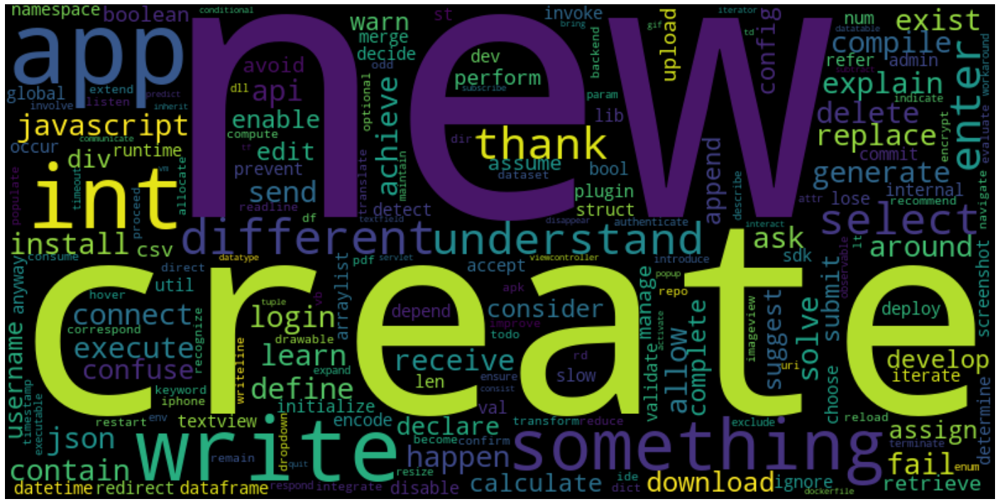

In [ ]:
show_word_cloud(tfidf_vocabular)

####Alghorithm test

Fitting 5 folds for each of 24 candidates, totalling 120 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    5.2s
[Parallel(n_jobs=10)]: Done 120 out of 120 | elapsed:   12.2s finished


Finished in: 12.235979795455933
{'metric': 'euclidean', 'n_neighbors': 20, 'weights': 'uniform'}
              precision    recall  f1-score   support

           0       0.76      0.61      0.67       195
           1       0.46      0.69      0.55       192
           2       0.73      0.53      0.61       213

    accuracy                           0.60       600
   macro avg       0.65      0.61      0.61       600
weighted avg       0.65      0.60      0.61       600

    accuracy      0.605


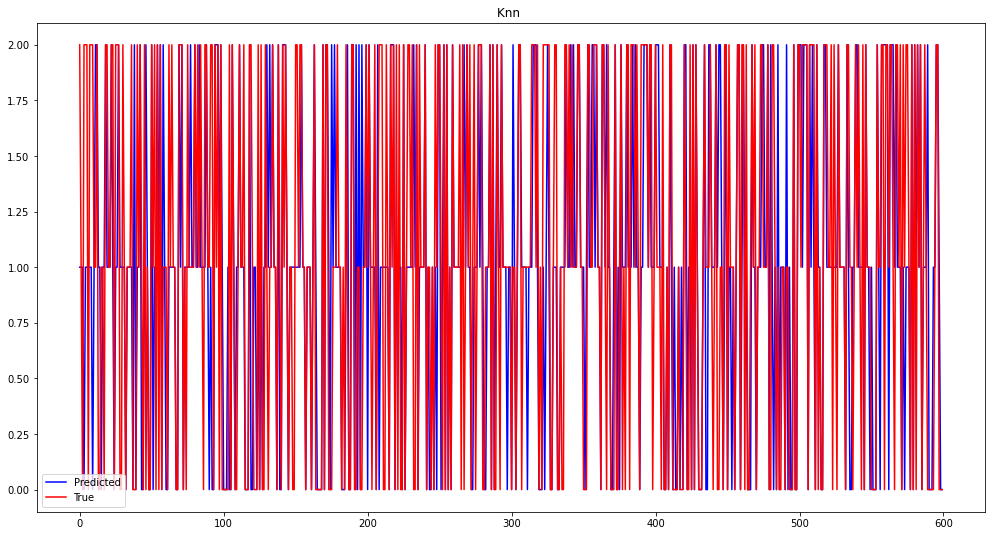

In [ ]:
knn_on_df(tfidf_matrix, processed_df.target, 2000)

              precision    recall  f1-score   support

           0       0.71      0.75      0.73      4820
           1       0.57      0.72      0.64      4835
           2       0.82      0.55      0.66      4745

    accuracy                           0.68     14400
   macro avg       0.70      0.68      0.68     14400
weighted avg       0.70      0.68      0.68     14400

    accuracy      0.676


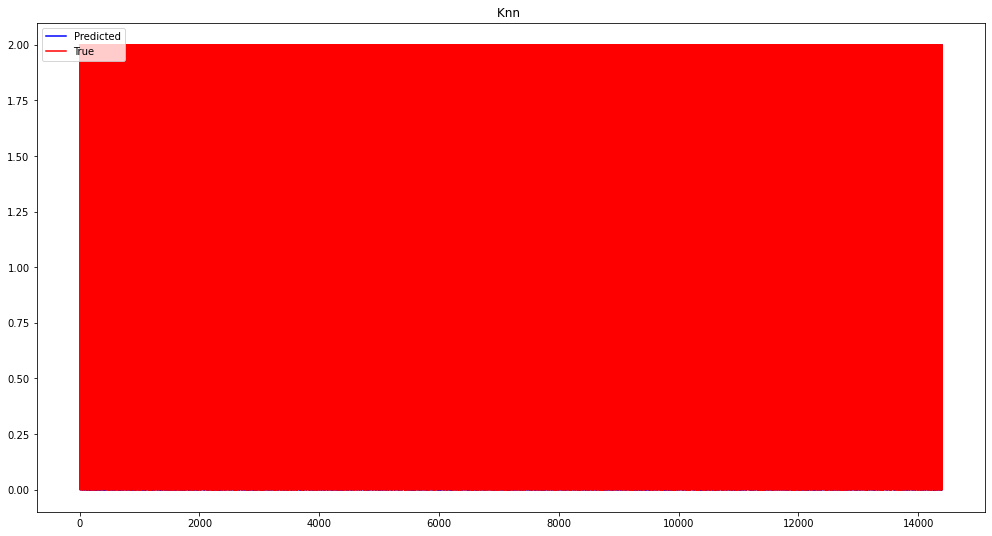

In [ ]:
knn_on_df(tfidf_matrix, processed_df.target, 48000, False)

Fitting 5 folds for each of 5 candidates, totalling 25 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:    0.6s finished


Finished in: 1.341456651687622
{'alpha': 0.1}
              precision    recall  f1-score   support

           0       0.78      0.73      0.76      4820
           1       0.58      0.81      0.68      4835
           2       0.88      0.59      0.70      4745

    accuracy                           0.71     14400
   macro avg       0.75      0.71      0.71     14400
weighted avg       0.75      0.71      0.71     14400

    accuracy      0.712


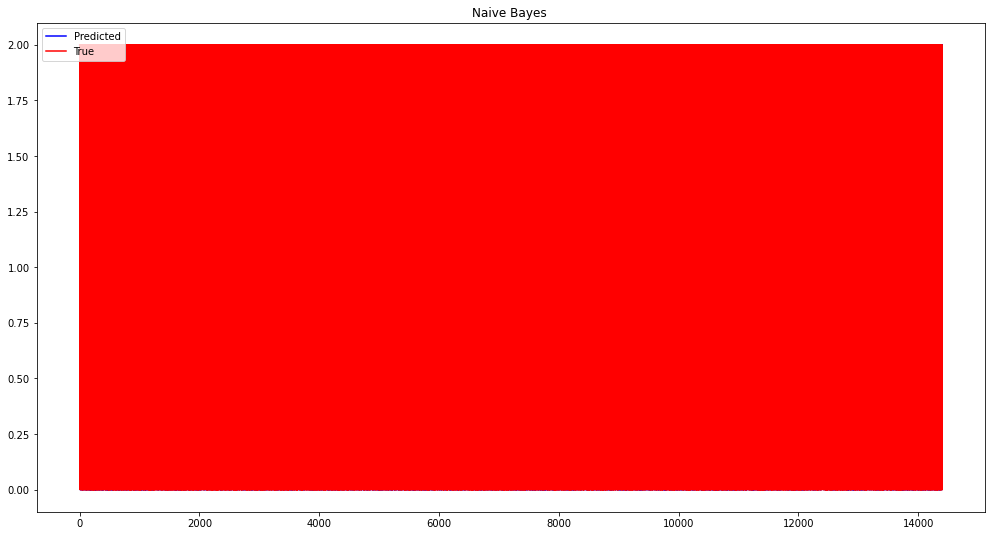

In [ ]:
naive_bayes_on_df(tfidf_matrix, processed_df.target, 48000)

Наивный баес во всей красе

              precision    recall  f1-score   support

           0       0.78      0.73      0.76      4820
           1       0.58      0.81      0.68      4835
           2       0.88      0.59      0.70      4745

    accuracy                           0.71     14400
   macro avg       0.75      0.71      0.71     14400
weighted avg       0.75      0.71      0.71     14400

    accuracy      0.712


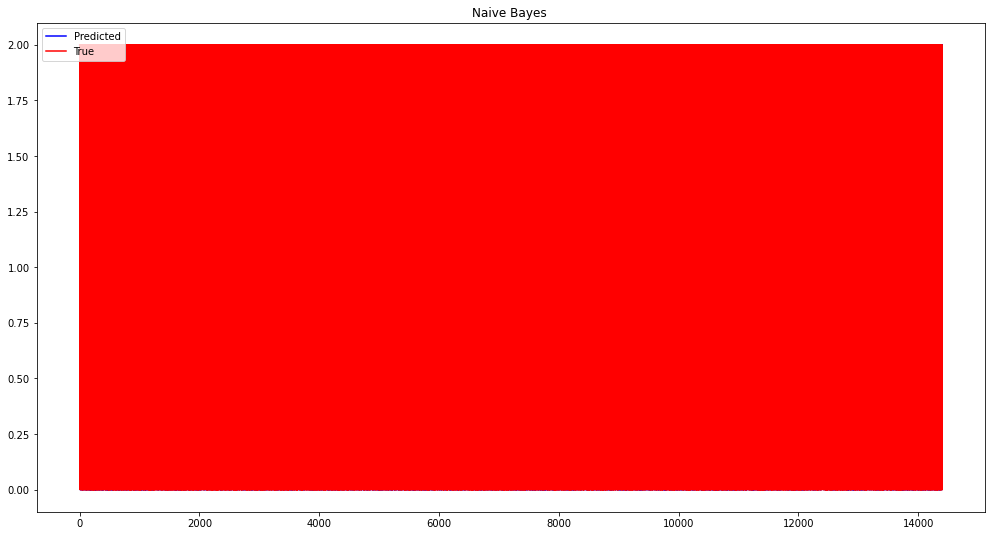

In [ ]:
naive_bayes_on_df(tfidf_matrix, processed_df.target, 48000, False)

{'criterion': 'gini', 'max_features': 'auto'}
              precision    recall  f1-score   support

           0       0.56      0.57      0.56      4820
           1       0.50      0.49      0.49      4835
           2       0.58      0.59      0.59      4745

    accuracy                           0.55     14400
   macro avg       0.55      0.55      0.55     14400
weighted avg       0.55      0.55      0.55     14400

    accuracy      0.548


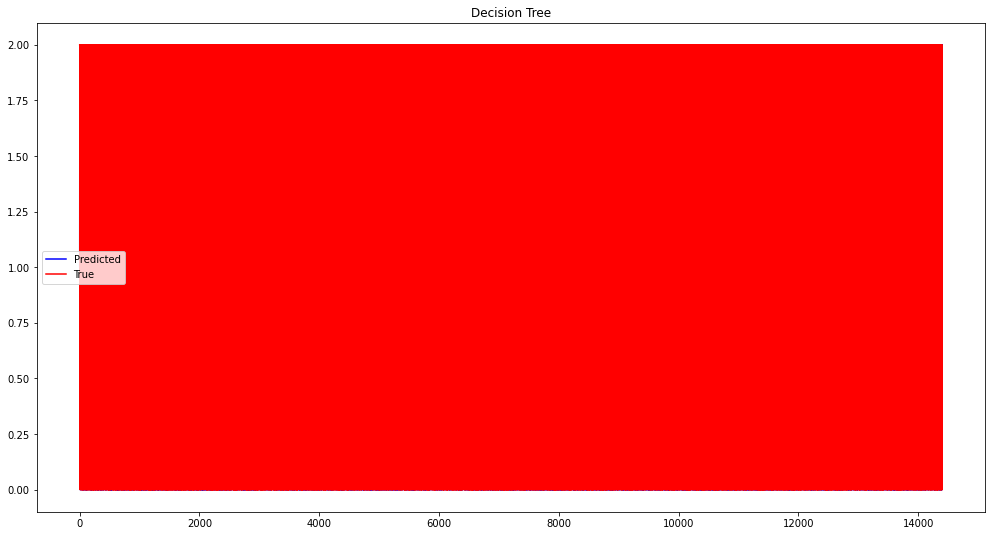

In [ ]:
decision_tree_on_df(tfidf_matrix, processed_df.target, 48000)

              precision    recall  f1-score   support

           0       0.60      0.59      0.60      4820
           1       0.52      0.54      0.53      4835
           2       0.63      0.62      0.63      4745

    accuracy                           0.58     14400
   macro avg       0.59      0.58      0.58     14400
weighted avg       0.59      0.58      0.58     14400

    accuracy      0.584


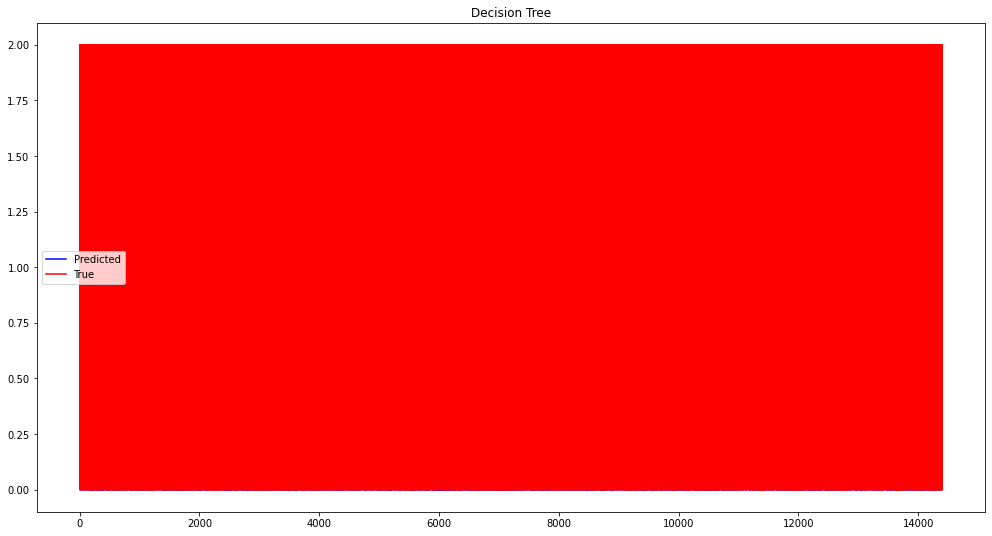

In [ ]:
decision_tree_on_df(tfidf_matrix, processed_df.target, 48000,False)

Fitting 5 folds for each of 8 candidates, totalling 40 fits


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  21 tasks      | elapsed:   15.3s
[Parallel(n_jobs=10)]: Done  40 out of  40 | elapsed:   26.1s finished


Finished in: 27.959861993789673
{'bootstrap': False, 'criterion': 'gini', 'max_leaf_nodes': None}


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    1.8s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 100 out of 100 | elapsed:    0.0s finished


              precision    recall  f1-score   support

           0       0.64      0.76      0.69       195
           1       0.53      0.49      0.51       192
           2       0.78      0.69      0.73       213

    accuracy                           0.65       600
   macro avg       0.65      0.65      0.65       600
weighted avg       0.65      0.65      0.65       600

    accuracy      0.650


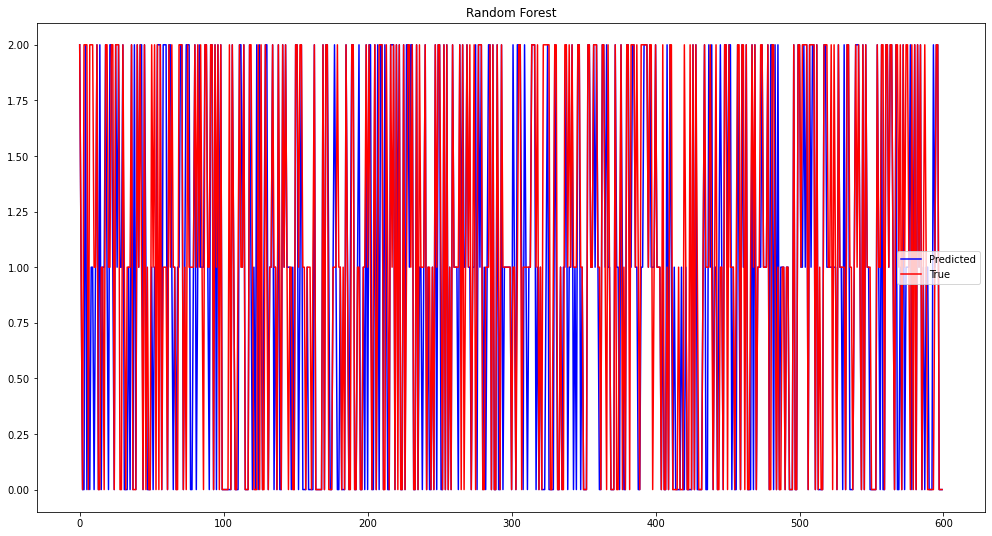

In [ ]:
random_forest_on_df(tfidf_matrix, processed_df.target, 2000)

              precision    recall  f1-score   support

           0       0.72      0.77      0.75      4820
           1       0.63      0.69      0.66      4835
           2       0.81      0.68      0.74      4745

    accuracy                           0.71     14400
   macro avg       0.72      0.71      0.71     14400
weighted avg       0.72      0.71      0.71     14400

    accuracy      0.713


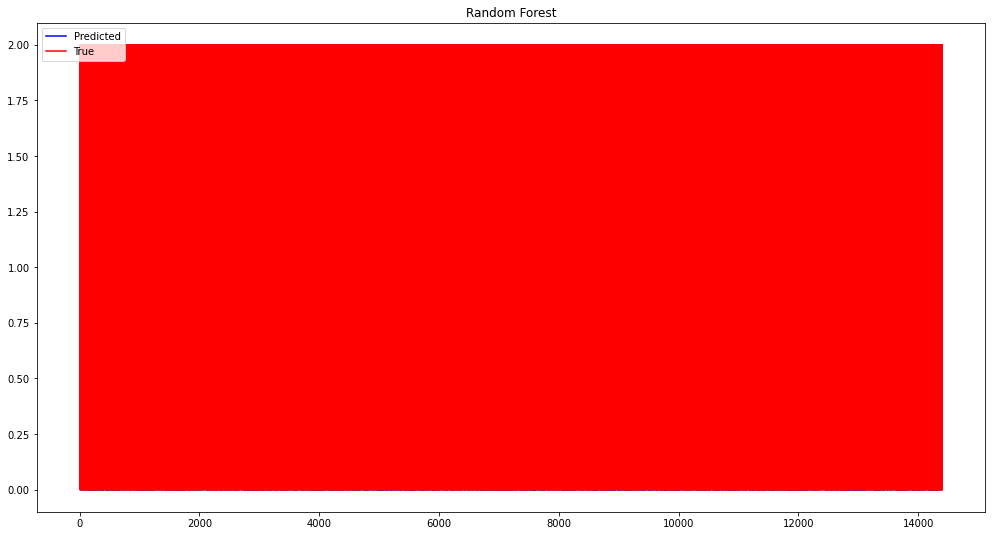

In [ ]:
random_forest_on_df(tfidf_matrix, processed_df.target, 48000, False)

Finished in: 6.015724182128906
{'C': 0.46415888336127775, 'penalty': 'l2'}
              precision    recall  f1-score   support

           0       0.65      0.83      0.73       195
           1       0.52      0.47      0.49       192
           2       0.79      0.67      0.72       213

    accuracy                           0.66       600
   macro avg       0.65      0.65      0.65       600
weighted avg       0.66      0.66      0.65       600

    accuracy      0.655


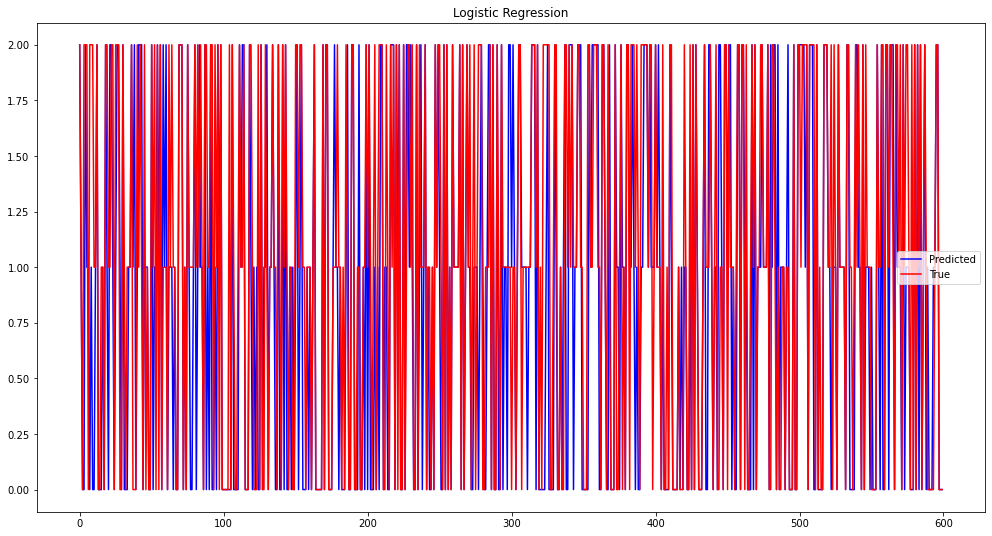

In [ ]:
logistic_regression_on_df(tfidf_matrix, processed_df.target, 2000, True)

Уфф, тут становится жарко. Претендент на победу среди почти-одинаковых скорингов

              precision    recall  f1-score   support

           0       0.77      0.82      0.80      4820
           1       0.67      0.70      0.68      4835
           2       0.81      0.72      0.76      4745

    accuracy                           0.75     14400
   macro avg       0.75      0.75      0.75     14400
weighted avg       0.75      0.75      0.75     14400

    accuracy      0.746


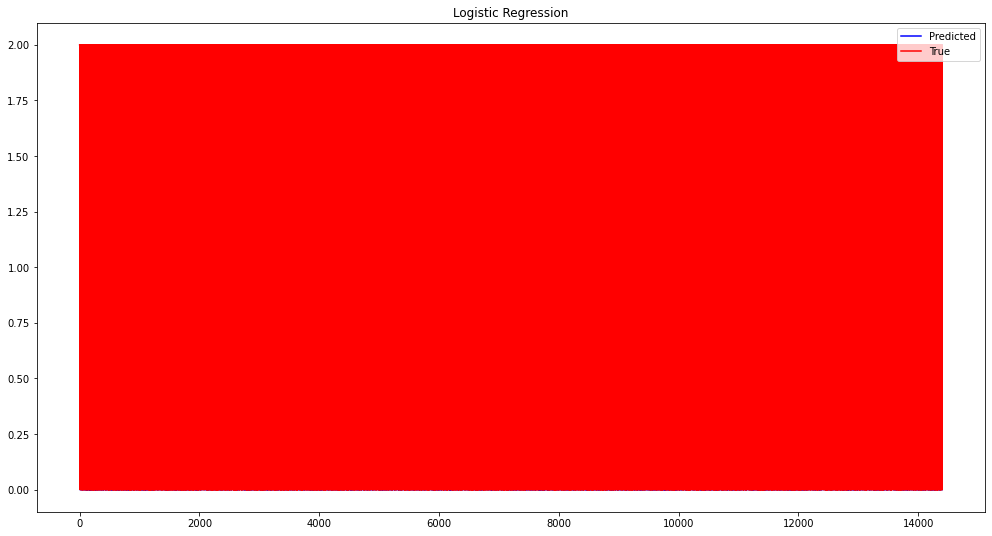

In [ ]:
logistic_regression_on_df(tfidf_matrix, processed_df.target, 48000, False)

              precision    recall  f1-score   support

           0       0.65      0.77      0.70      4820
           1       0.61      0.64      0.62      4835
           2       0.82      0.63      0.71      4745

    accuracy                           0.68     14400
   macro avg       0.69      0.68      0.68     14400
weighted avg       0.69      0.68      0.68     14400

    accuracy      0.677


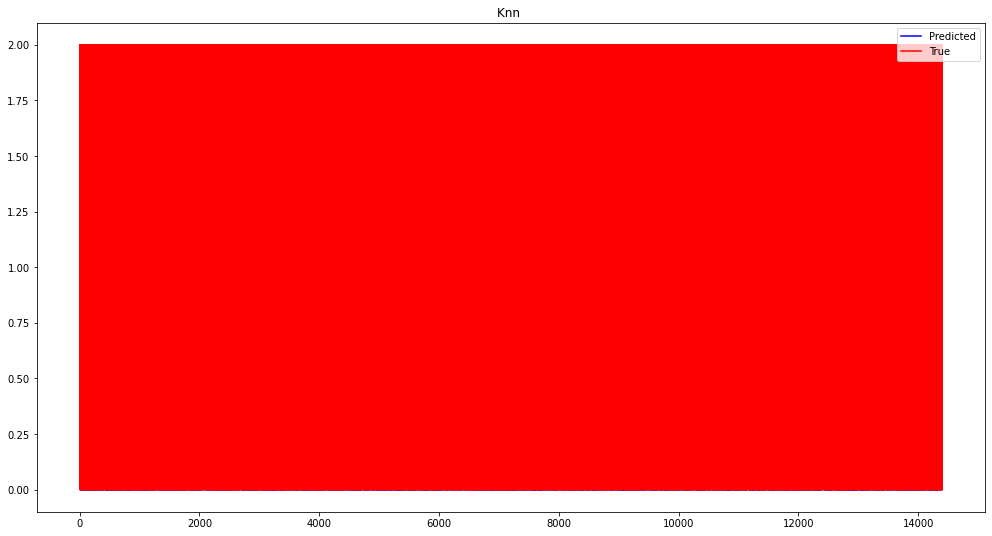

In [ ]:
xgboost(tfidf_matrix, processed_df.target, 48000, False)

Finished in: 34.09914803504944
{'n_estimators': 100}
              precision    recall  f1-score   support

           0       0.60      0.73      0.66       195
           1       0.49      0.46      0.48       192
           2       0.76      0.65      0.70       213

    accuracy                           0.62       600
   macro avg       0.62      0.61      0.61       600
weighted avg       0.62      0.62      0.62       600

    accuracy      0.617


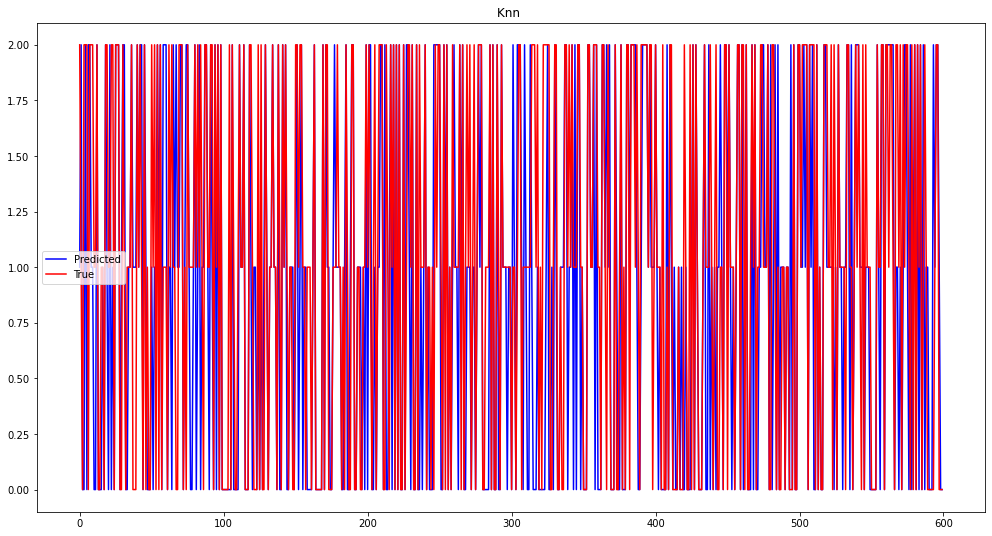

In [ ]:
xgboost(tfidf_matrix, processed_df.target, 2000, True)

              precision    recall  f1-score   support

           0       0.63      0.74      0.68      4820
           1       0.57      0.54      0.55      4835
           2       0.75      0.65      0.70      4745

    accuracy                           0.64     14400
   macro avg       0.65      0.64      0.64     14400
weighted avg       0.65      0.64      0.64     14400

    accuracy      0.642


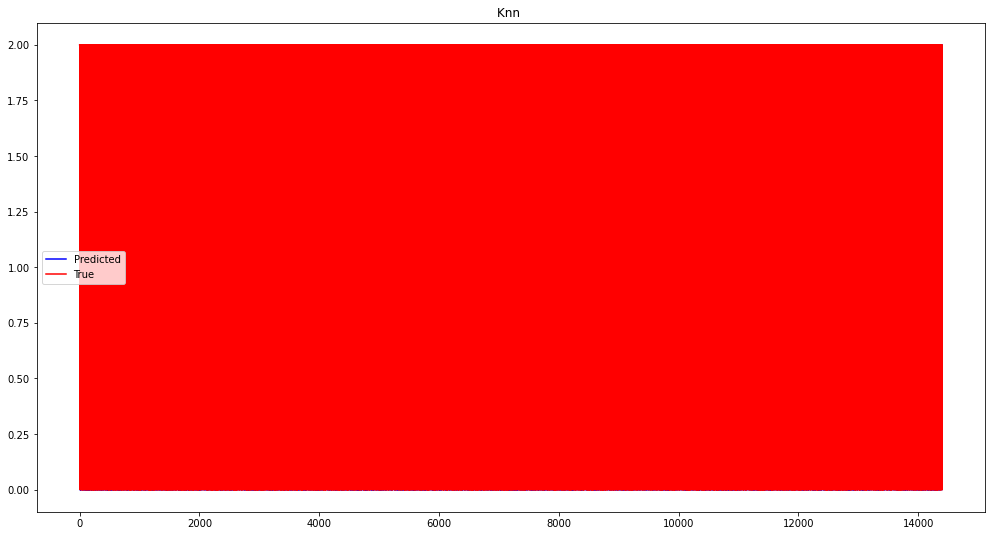

In [ ]:
adaboost(tfidf_matrix, processed_df.target, 48000, False)

Finished in: 7.061216115951538
{'n_estimators': 10}
              precision    recall  f1-score   support

           0       0.45      0.85      0.59       195
           1       0.40      0.12      0.19       192
           2       0.68      0.56      0.61       213

    accuracy                           0.52       600
   macro avg       0.51      0.51      0.47       600
weighted avg       0.52      0.52      0.47       600

    accuracy      0.515


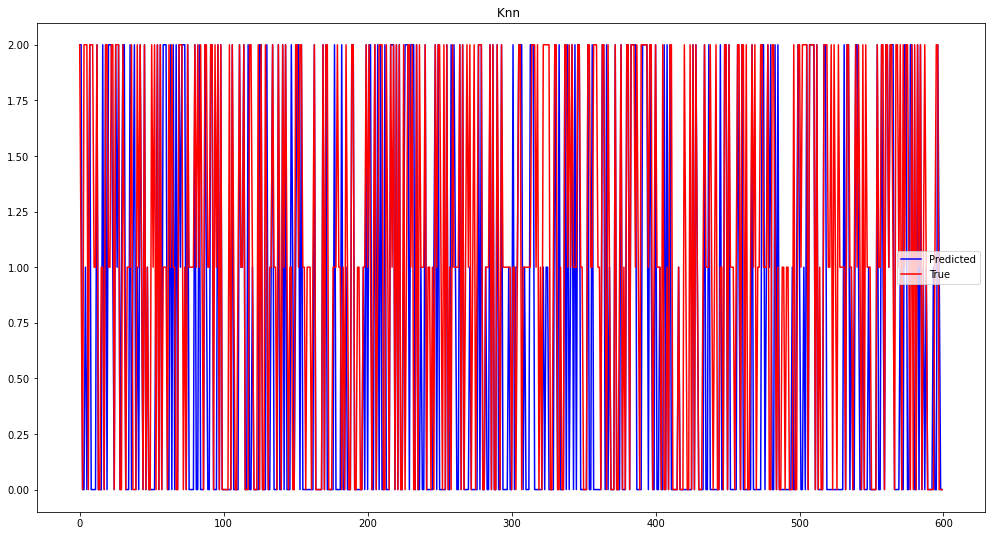

In [ ]:
adaboost(tfidf_matrix, processed_df.target, 2000, True)

## Create test predictions

В итоге, подгружаем тестовый датасет (тот что без лейблов) и предиктим его на плюс-минус лучшей модели

In [ ]:
test = pd.read_parquet('/content/drive/My Drive/data/test.parquet')

In [ ]:
test.head()

,Body,Tags,Title
Id,,,
46785369,I was given a decision tree with sample data i...,<math><machine-learning><artificial-intelligen...,Desecion trees ended up with same given tree a...
38908667,<p>I am moving a test application over to Xcod...,<ios><swift><swift3><xcode8><nserror>,Value of type 'Error' has no member 'code'
44703012,<p>I would like to be able to perform linting ...,<jenkins><jenkins-pipeline>,How do I lint Jenkins pipelines from the comma...
34910435,"<p>I’m using <a href=""https://github.com/ftlab...",<javascript><css><mobile-safari><fastclick.js>...,Is there a way to prevent fastclick from firin...
51632121,I have some 5 Test cases and I want them to ke...,<android><testing><appium><katalon-studio>,How to loop test cases in katalon Studio?


In [ ]:
processed_test_df = preprocessed(test)

In [ ]:
processed_test_df.to_csv('/content/drive/MyDrive/data/processed_test.csv', index = False, header=True)

In [ ]:
processed_test_df = pd.read_csv("/content/drive/MyDrive/data/processed_test.csv")
processed_test_df.Body = processed_test_df.Body.apply(lambda s: set(s.replace("{", "").replace("'", "").replace("}", "").strip().split(", ")))
processed_test_df.Title = processed_test_df.Title.apply(lambda s: set(s.replace("{", "").replace("'", "").replace("}", "").strip().split(", ")))
processed_test_df.Tags = processed_test_df.Tags.apply(lambda s: set(s.replace("{", "").replace("'", "").replace("}", "").strip().split(", ")))

processed_test_df.Body = processed_test_df[processed_test_df.Body.apply(lambda s: len(s) > 0)]
processed_test_df.dropna(inplace=True)

In [ ]:
processed_test_df['RawTitle'] = processed_test_df.Title.apply(lambda l: ' '.join(str(e) for e in l))
processed_test_df['RawBody'] = processed_test_df.Body.apply(lambda l: ' '.join(str(e) for e in l))
processed_test_df['RawText'] = processed_test_df[['RawBody', 'RawTitle']].apply(lambda s: s[0]+' '+(s[1]), axis=1)

In [ ]:
processed_test_df.head()

,Body,Tags,Title,RawTitle,RawBody,RawText
0,"{tree, gain, mean, provide, data, class, expla...","{entropy, math}","{tree, computation, gain, end, split, desecion...",tree computation gain end split desecion give,tree gain mean provide data class explain some...,tree gain mean provide data class explain some...
1,"{bug, convert, regard, application, left, swit...","{nserror, io, swift}","{member, value, code, error, type}",member value code error type,bug convert regard application left switch wit...,bug convert regard application left switch wit...
2,"{able, would, enough, groovy, perform, like, s...",{jenkins},"{lint, line, command, pipeline, jenkins}",lint line command pipeline jenkins,able would enough groovy perform like seem lin...,able would enough groovy perform like seem lin...
3,"{swipe, also, style, page, use, bypass, withou...","{javascript, cs, fastclick}","{state, fire, fastclick, prevent, scroll, way,...",state fire fastclick prevent scroll way active,swipe also style page use bypass without scrol...,swipe also style page use bypass without scrol...
4,"{keep, order, please, time, run, case, test, p...","{appium, android, test}","{studio, katalon, loop, case, test}",studio katalon loop case test,keep order please time run case test profile w...,keep order please time run case test profile w...


Решили все таки выбрать w2v на логистической регресси. Так как хороший запас слов претренированной модели должен, в перспективе, показать себя на большой выборке

In [ ]:
w2v_test_matrix = get_model_vectors(processed_test_df.RawText, w2v)

In [ ]:
lr = LogisticRegression()
lr.fit(w2v_matrix, processed_df.target)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [ ]:
lr_predicted_test = lr.predict(w2v_test_matrix)

In [ ]:
test['Predicted'] = lr_predicted_test

In [ ]:
test=test.drop(labels=['Body','Tags','Title'],axis=1)

In [ ]:
test.to_csv('/content/drive/MyDrive/data/test.csv')

## Итоги

Итог - было весело. Больно, но весело. Претренированные модели довольно много весят, плюс колаб отключил возможность бесплатно поднять ram, а платные функции при этом тоже не предоставляет. Еще, мы до этого не работали в колабе парами. То, что колаб очень плохо работает, когда его пытаются редактировать разные люди мы поняли в процессе. Лично для меня, самой интересной частью было разбираться в трансформерах, посмотреть на архитектуру и как это работает внутри. Было весело и полезно, спасибо!

#### Цитаты этой лабы

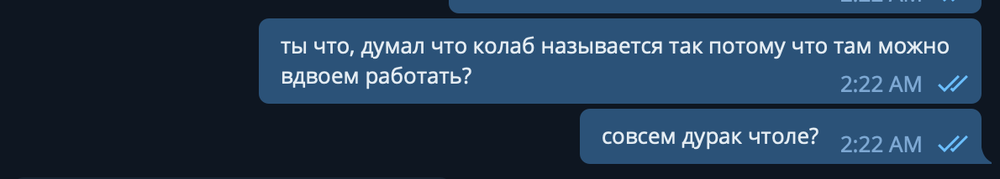

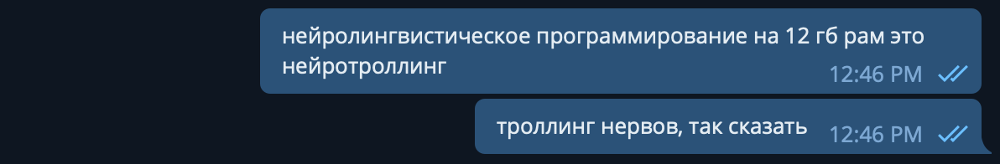